In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [2]:
! wget   http://dlib.net/files/shape_predictor_5_face_landmarks.dat.bz2 # DOWNLOAD LINK

! bunzip2 /content/shape_predictor_5_face_landmarks.dat.bz2

datFile =  "/content/shape_predictor_5_face_landmarks.dat"

--2023-02-05 21:49:21--  http://dlib.net/files/shape_predictor_5_face_landmarks.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5706710 (5.4M)
Saving to: ‘shape_predictor_5_face_landmarks.dat.bz2’

shape_predictor_5_f 100%[===================>]   5.44M  19.6MB/s    in 0.3s    

2023-02-05 21:49:22 (19.6 MB/s) - ‘shape_predictor_5_face_landmarks.dat.bz2’ saved [5706710/5706710]



# Read dataset from disk to RAM

In [3]:
import cv2
import glob
import torch
import numpy as np
import os
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
from PIL import Image
import dlib
import torchvision
from torchvision import transforms


def shape_to_normal(shape):
  shape_normal = []
  for i in range(0, 5):
      shape_normal.append((i, (shape.part(i).x, shape.part(i).y)))
  return shape_normal

def get_eyes_nose_dlib(shape):
    nose = shape[4][1]
    left_eye_x = int(shape[3][1][0] + shape[2][1][0]) // 2
    left_eye_y = int(shape[3][1][1] + shape[2][1][1]) // 2
    right_eyes_x = int(shape[1][1][0] + shape[0][1][0]) // 2
    right_eyes_y = int(shape[1][1][1] + shape[0][1][1]) // 2
    return nose, (left_eye_x, left_eye_y), (right_eyes_x, right_eyes_y)

def distance(a, b):
    return np.sqrt((a[0] - b[0]) ** 2 + (a[1] - b[1]) ** 2)

def cosine_formula(length_line1, length_line2, length_line3):
  cos_a = -(length_line3 ** 2 - length_line2 ** 2 - length_line1 ** 2) / (2 * length_line2 * length_line1)
  return cos_a

def rotate_point(origin, point, angle):
    ox, oy = origin
    px, py = point

    qx = ox + np.cos(angle) * (px - ox) - np.sin(angle) * (py - oy)
    qy = oy + np.sin(angle) * (px - ox) + np.cos(angle) * (py - oy)
    return qx, qy

def is_between(point1, point2, point3, extra_point):
    c1 = (point2[0] - point1[0]) * (extra_point[1] - point1[1]) - (point2[1] - point1[1]) * (extra_point[0] - point1[0])
    c2 = (point3[0] - point2[0]) * (extra_point[1] - point2[1]) - (point3[1] - point2[1]) * (extra_point[0] - point2[0])
    c3 = (point1[0] - point3[0]) * (extra_point[1] - point3[1]) - (point1[1] - point3[1]) * (extra_point[0] - point3[0])
    if (c1 < 0 and c2 < 0 and c3 < 0) or (c1 > 0 and c2 > 0 and c3 > 0):
        return True
    else:
        return False

def align(img):
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    #face alignment
    rects = detector(gray, 0)
    if len(rects) > 0:
        for rect in rects:
            x = rect.left()
            y = rect.top()
            w = rect.right()
            h = rect.bottom()
            shape = predictor(gray, rect)
    else:
      return 0

    shape = shape_to_normal(shape)
    nose, left_eye, right_eye = get_eyes_nose_dlib(shape)

    center_of_forehead = ((left_eye[0] + right_eye[0]) // 2, (left_eye[1] + right_eye[1]) // 2)

    center_pred = (int((x + w) / 2), int((y + y) / 2))

    length_line1 = distance(center_of_forehead, nose)
    length_line2 = distance(center_pred, nose)
    length_line3 = distance(center_pred, center_of_forehead)

    cos_a = cosine_formula(length_line1, length_line2, length_line3)
    angle = np.arccos(cos_a)

    rotated_point = rotate_point(nose, center_of_forehead, angle)
    rotated_point = (int(rotated_point[0]), int(rotated_point[1]))
    if is_between(nose, center_of_forehead, center_pred, rotated_point):
        angle = np.degrees(-angle)
    else:
        angle = np.degrees(angle)
    
    #gray = Image.fromarray(gray)
    #gray = np.array(gray.rotate(angle))

    return angle


#Resize images (height  = X, width = Y)
SIZE_X = 128 
SIZE_Y = 128
#Ensure MLP Is ony fed 1000/ Dataset
SAMPLE_SIZE = 200

# crop face using haar cascade
face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_alt2.xml')

crops = []
original = 0
skips = []
rejected = []
angles = []

"""IMG"""
#Capture training image info as a list
train_images = []
val_images = []
for count, img_path in enumerate(sorted(glob.glob(os.path.join("/content/drive/MyDrive/helenstar_release/test/", "*image.jpg")))):
    #Process images
    img = cv2.imread(img_path)
    #img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    #cv2_imshow(img)
    #img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    #train_images.append(img)
    
    # convert to gray
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)

    # face bounding boxes
    detector = dlib.get_frontal_face_detector()
    predictor = dlib.shape_predictor(datFile)  

    face = None

    # Detect faces
    try:
      face_cascade=cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_alt2.xml")
      limit = int((gray.shape[0]/2))
      faces = face_cascade.detectMultiScale(gray, 1.05, 2, minSize=[limit,0])
      face = sorted(faces,key=lambda f:f[2]*f[3])[-1]
    except:
      #print("FAILED USING FRONTAL FACE ALT 2")
      try:
        face_cascade=cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_profileface.xml")
        limit = int((gray.shape[0]/2))
        faces = face_cascade.detectMultiScale(gray, 1.05, 2, minSize=[limit,0])
        face = sorted(faces,key=lambda f:f[2]*f[3])[-1]
      except:
        try:
          face_cascade=cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")
          limit_1 = int((gray.shape[0]/2.5))
          limit_2 = int((gray.shape[1]/1.7))
          faces = face_cascade.detectMultiScale(gray, 1.05, 3, minSize=[limit_1,0], maxSize=[50000,limit_2]) 
          face = sorted(faces,key=lambda f:f[2]*f[3])[-1]  
        except:
          #print("FAILED USING FRONTAL FACE ALT 2")
          try:
            face_cascade=cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")
            limit_1 = int((gray.shape[0]/2.5))
            limit_2 = int((gray.shape[1]/2.5))
            faces = face_cascade.detectMultiScale(gray, minSize=[0,limit_2])
            face = sorted(faces,key=lambda f:f[2]*f[3])[-1]
          except:
            #print("FAILED USING FRONTAL FACE ALT 2")
            try:
              face_cascade=cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_alt.xml")
              limit_1 = int((gray.shape[0]/2))
              limit_2 = int((gray.shape[1]/3))
              faces = face_cascade.detectMultiScale(gray, 1.03, 1, minSize=[limit_1,0])
              face = sorted(faces,key=lambda f:f[2]*f[3])[-1]
            except:
              #print("FAILED USING PROFILE FACE ALT")
              print("->")
              skips.append(count)
              rejected.append(gray)
              crops.append([0,0,0,0])

    if face is not None:
      x, y, w, h = face
      crops.append(face)
      face = img[y:y + h, x:x + w]
      face = cv2.resize(face, (SIZE_Y, SIZE_X))
      #cv2_imshow(face)

      angle = align(img)
      face = Image.fromarray(face)
      face_rotated = np.array(face.rotate(angle))
      angles.append(angle)
      #cv2_imshow(face_rotated)
      
      preprocess = transforms.Compose([
          transforms.ToTensor(),
          transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
      ])

      normed_face = preprocess(face_rotated)
      #print(normed_face.shape)

      train_images.append(normed_face)
      #preview = torchvision.transforms.functional.to_pil_image(normed_face)
      #print(preview.shape)
      #plt.imshow(preview,cmap='gray', vmin=0, vmax=1)
      #plt.show()
      

    # Stop after SAMPLE_SIZE is reached
    if count % 9 == 0:
      print(str(count), "/", str(SAMPLE_SIZE)) #, end='\r'
    if count == SAMPLE_SIZE -1:
      break

#X = torch.tensor(train_images).permute(0,3,1,2)
X= torch.stack(train_images)
print(X.shape)


0 / 1998
->
->
9 / 1998
->
->
->
18 / 1998
->
27 / 1998
->
36 / 1998
45 / 1998
54 / 1998
->
->
63 / 1998
72 / 1998
->
81 / 1998
->
90 / 1998
99 / 1998
torch.Size([89, 3, 128, 128])


In [4]:
"""MASK"""
# Capture mask/label info as a list
masks = np.empty(shape=(int(len(train_images)),11,SIZE_Y,SIZE_Y))
print(len(crops))
print(len(train_images))
suc_count = 0
for count, mask_path in enumerate(sorted(glob.glob(os.path.join("/content/drive/MyDrive/helenstar_release/test/", "*label.png")))):
    # Process images
    mask = cv2.imread(mask_path, 0)

    # retrieve x,y,h,w
    face = crops[count]
    #print(face)

    #print(sum(face))

    if sum(face) != 0:
      x, y, w, h = face
      #print(face.size)
      face = mask[y:y + h, x:x + w]
      #print(face.size)
      #print(face.shape)
      mask = cv2.resize(face, (SIZE_Y, SIZE_X))

      mask = Image.fromarray(mask)
      mask = np.array(mask.rotate(angles[suc_count]))

      #plt.imshow(mask, cmap='gray')
      #plt.show()
      # one hot encode
      one_hot_Y = torch.nn.functional.one_hot(torch.tensor(mask).to(torch.int64), 11)
      one_hot_Y = one_hot_Y.permute(2,0 , 1)


      # save
      masks[suc_count]= (one_hot_Y)
      suc_count +=1
    else:
      pass


    """END OF Y"""
    # Stop after SAMPLE_SIZE is reached
    print(str(count), "/", str(SAMPLE_SIZE), end='\r')
    if count == SAMPLE_SIZE -1:
      break

Y = torch.from_numpy(masks)

print(Y.shape)
print(original)

100
89
torch.Size([89, 11, 128, 128])
0


In [7]:
print(X.shape, Y.shape)

torch.Size([89, 3, 128, 128]) torch.Size([89, 11, 128, 128])


### Obtain semantic class values for facial features in the dataset's images

0: background
1: facial skin
2: left brow (viewer side)
3: right brow
4: left eye
5: right eye
6: nose
7: upper lip
8: inner mouth
9: lower lip
10: hair

In [8]:
#rgb_vals = np.unique(ar = Y.numpy())
rgb_vals = [ 0,1,2,3,4,5,6,7,8,9,10]
print(rgb_vals)

num_classes=len(rgb_vals)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]


In [9]:
# Helper functions from "https://github.com/HardevKhandhar/building-segmentation-image-processing/blob/main/geospatial_buildings.ipynb"

# helper function for data visualization
def visualize(**images):
    """
    Plot images in one row (Original Image: Ground Truth : Predicted)
    """
    n_images = len(images)
    plt.figure(figsize=(20,8))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_images, idx + 1)
        plt.xticks([]); 
        plt.yticks([])
        # get title from the parameter names
        plt.title(name.replace('_',' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

#Function to reverse one-hot-encode an image
def reverse_one_hot(image):
    """
    Transform a 2D array in one-hot format (depth is num_classes),
    to a 2D array with only 1 channel, where each pixel value is
    the classified class key.
    # Arguments
        image: The one-hot format image 
        
    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of 1, where each pixel value is the classified 
        class key.
    """
    #argmax to return the indices of the maximum values along an axis. 
    x = np.argmax(image, axis = -3)
    return x

# Perform colour coding on the reverse-one-hot outputs
def colour_code_segmentation(image, label_values):
    """
    Given a 1-channel array of class keys, colour code the segmentation results.
    # Arguments
        image: single channel array where each value represents the class key.
        label_values

    # Returns
        Colour coded image for segmentation visualization
    """
    colour_codes = np.array(label_values)
    x = colour_codes[image.numpy().astype(int)]

    return x

### Sanity check

0


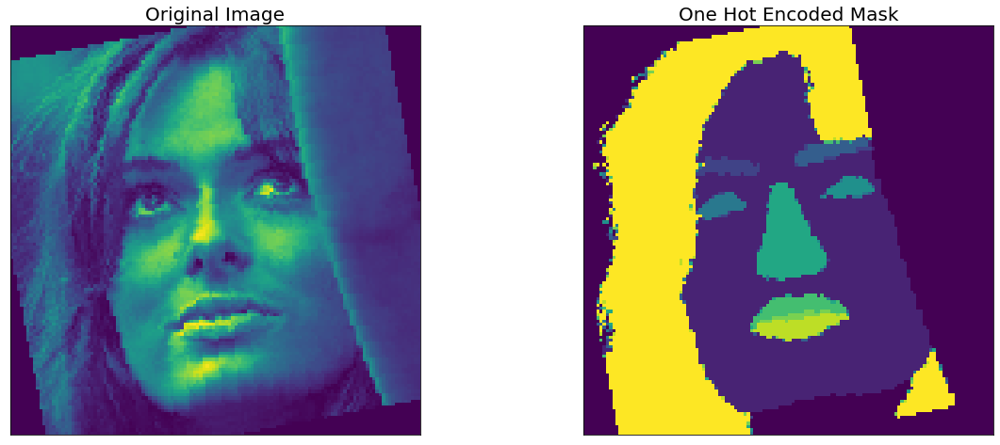

1


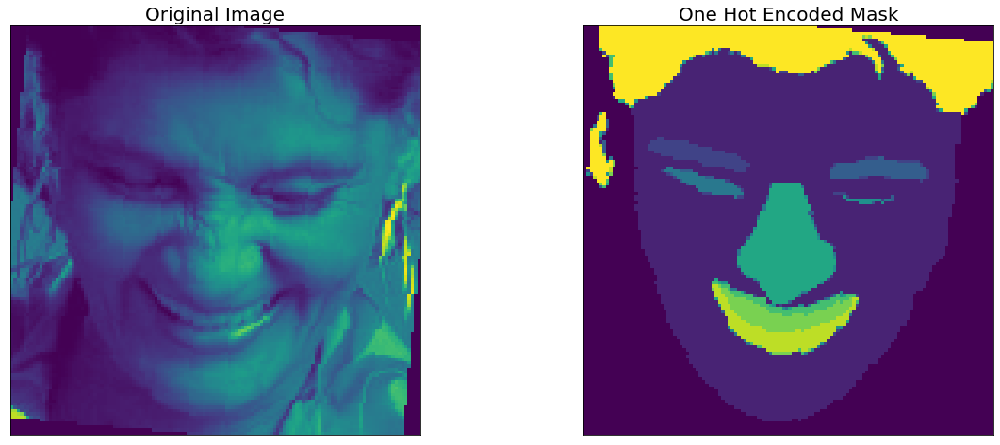

2


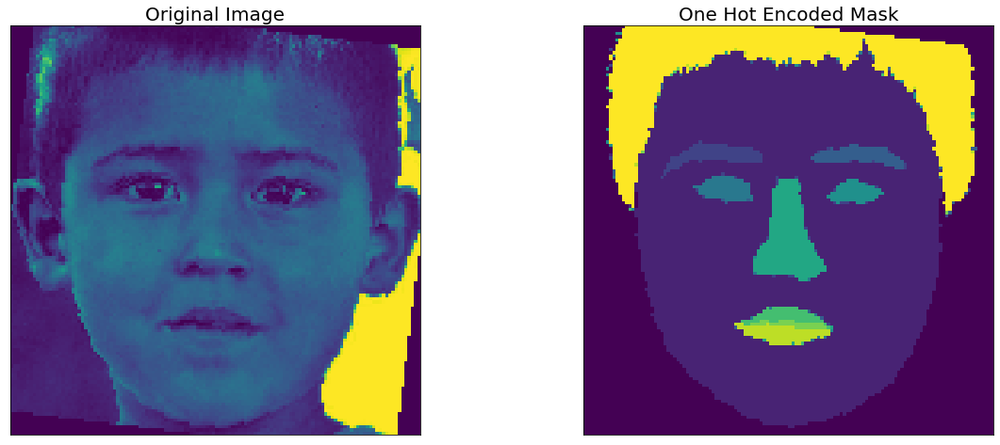

3


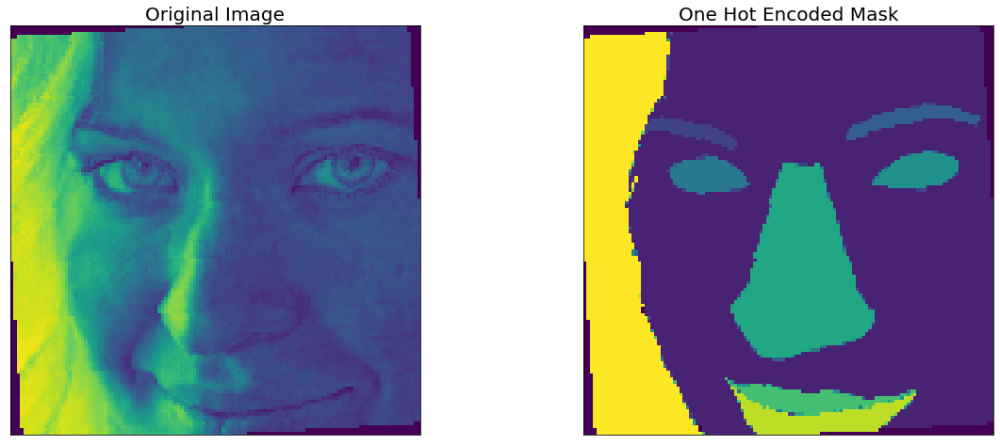

4


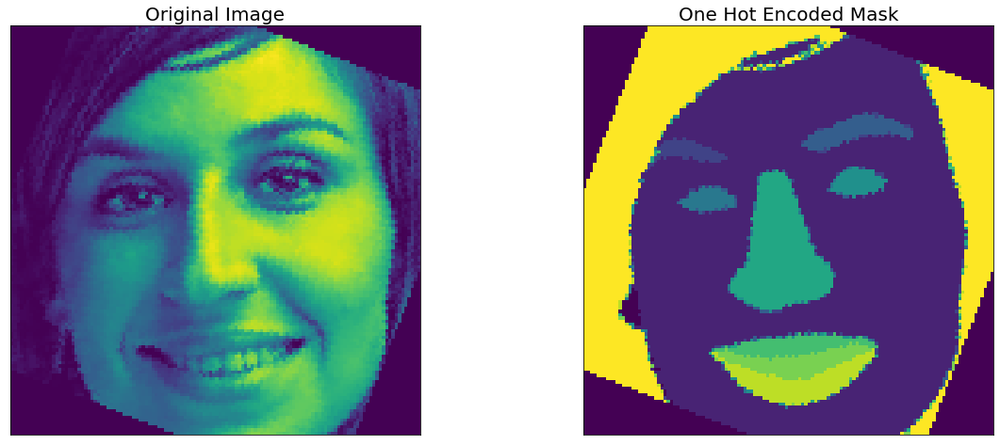

5


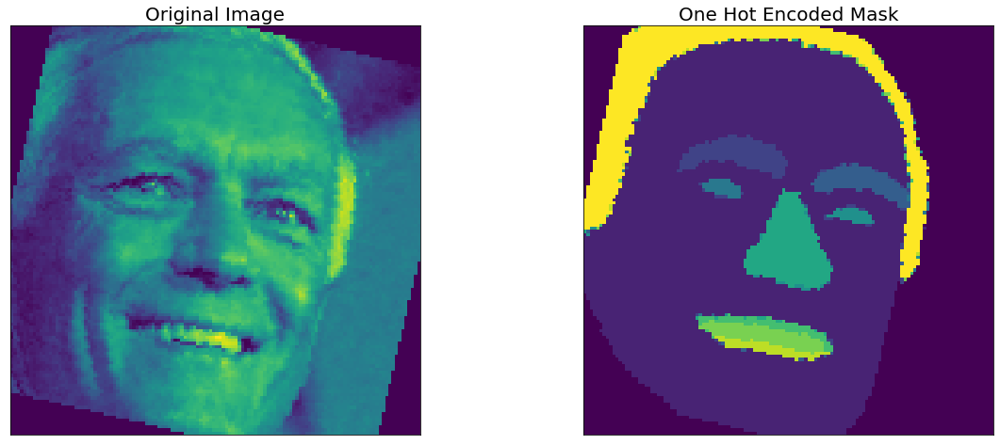

6


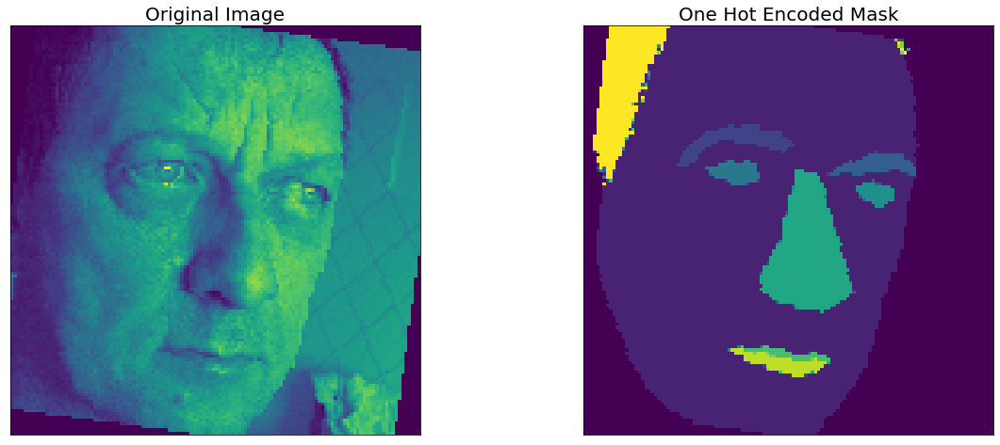

7


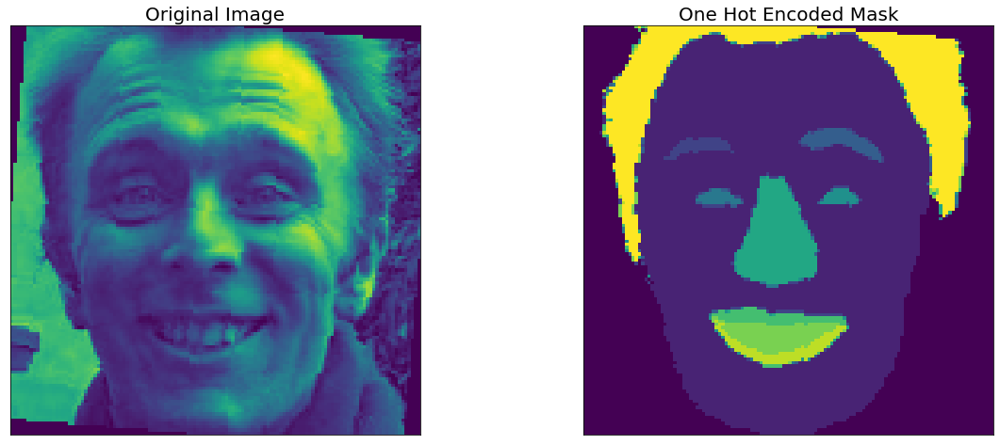

8


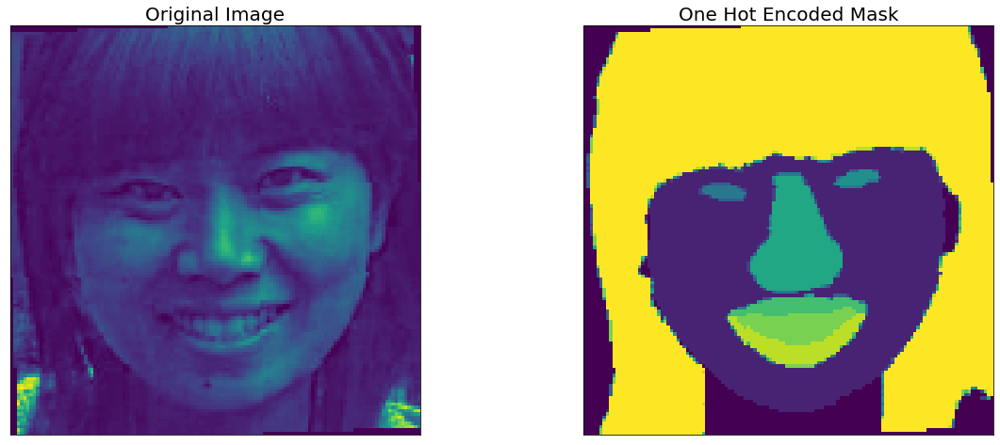

9


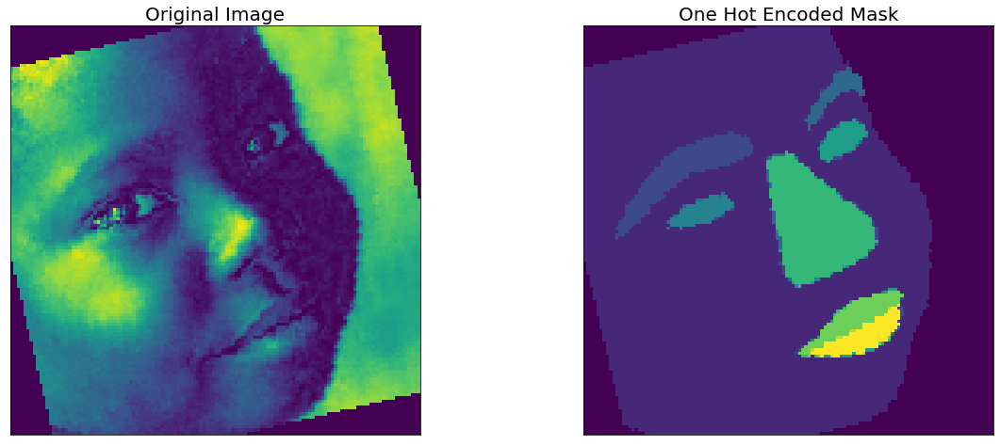

10


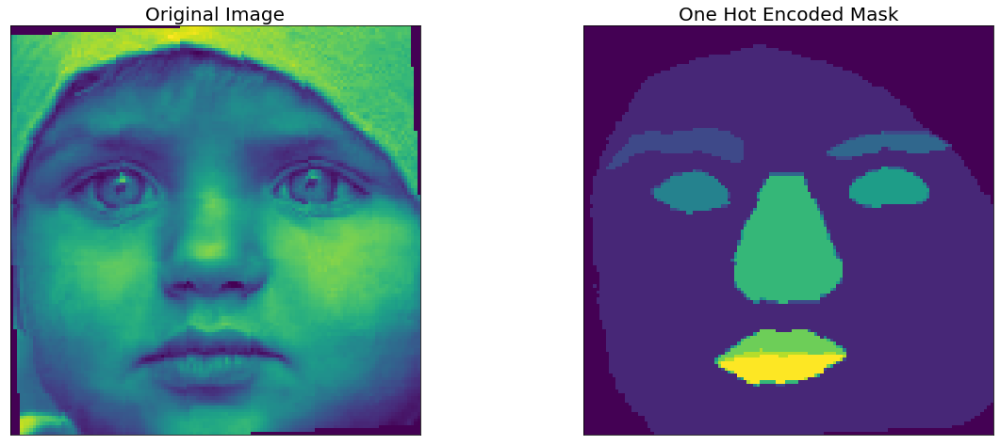

11


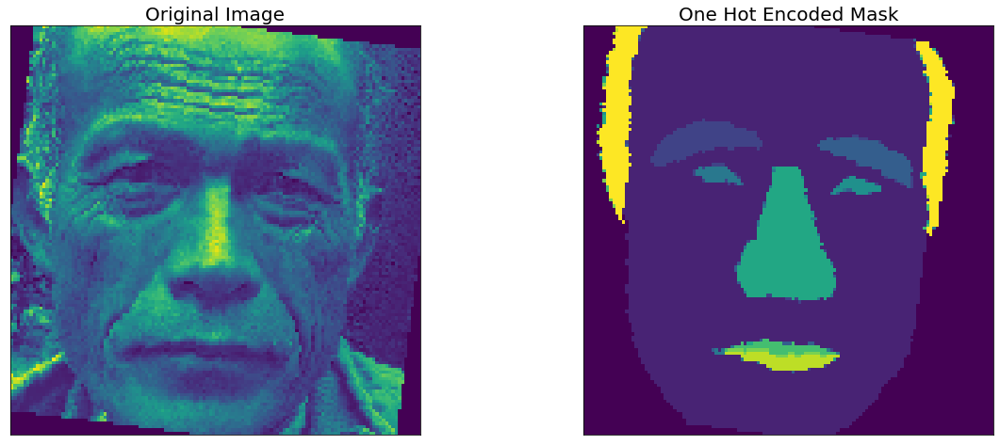

12


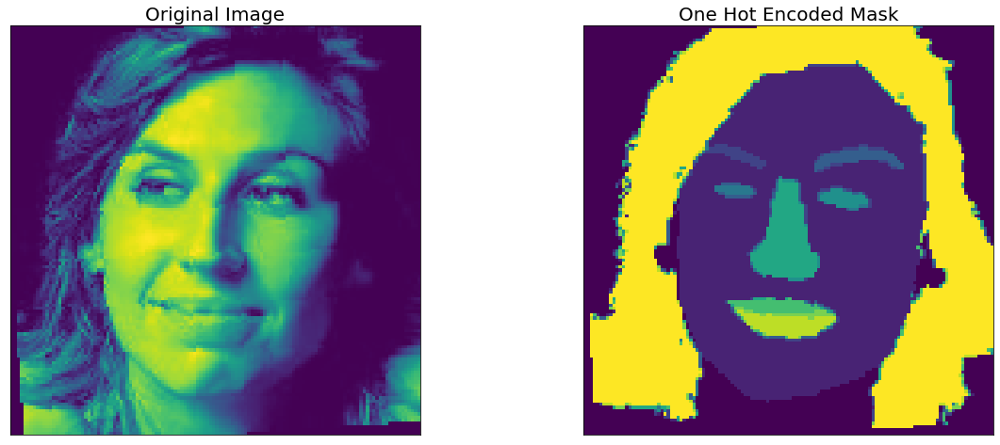

13


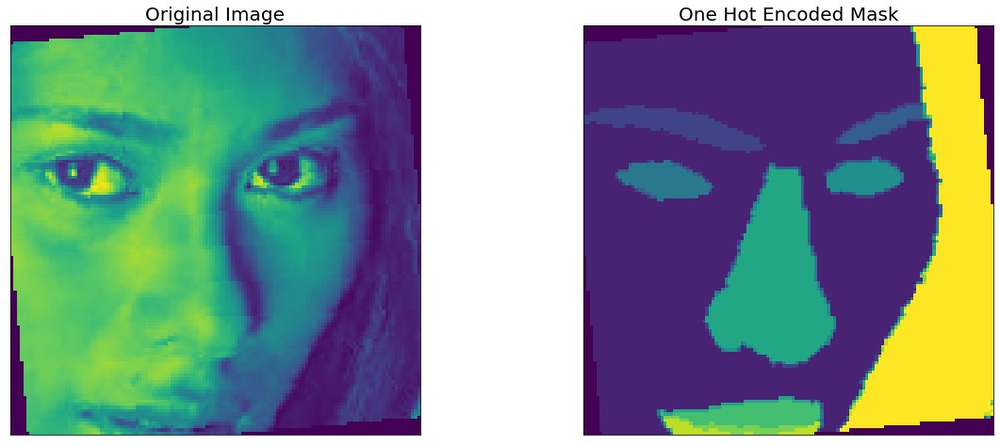

14


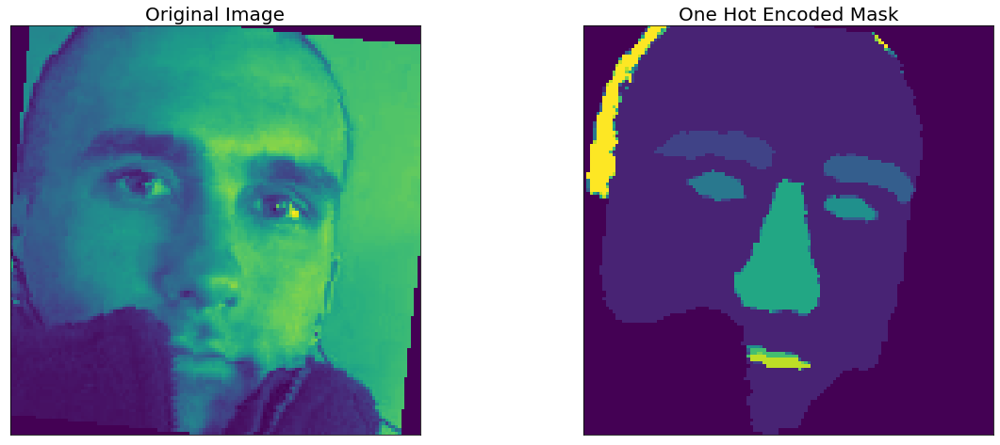

15


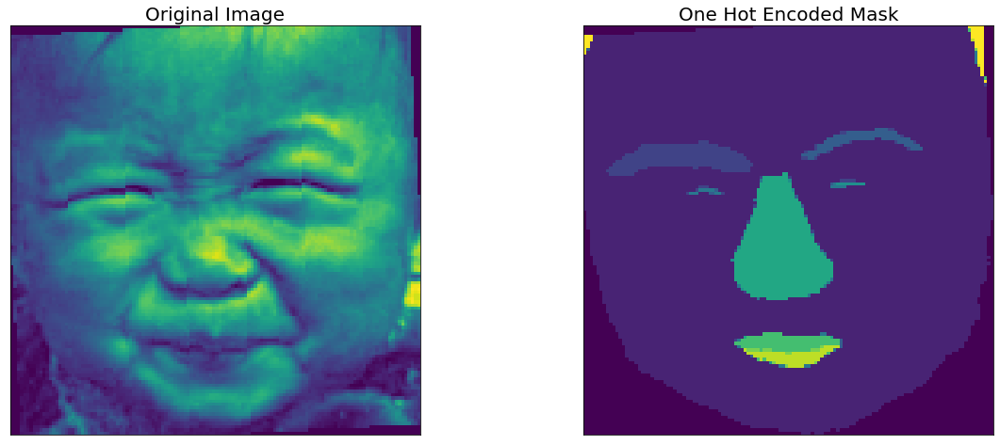

16


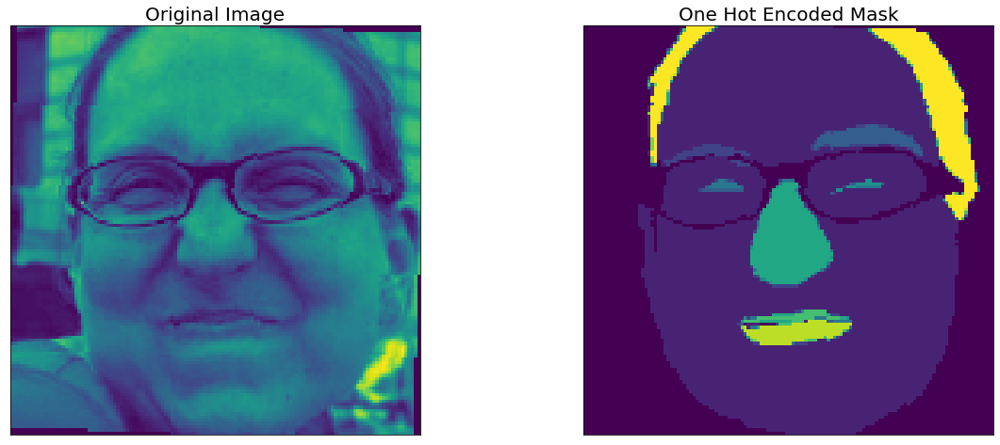

17


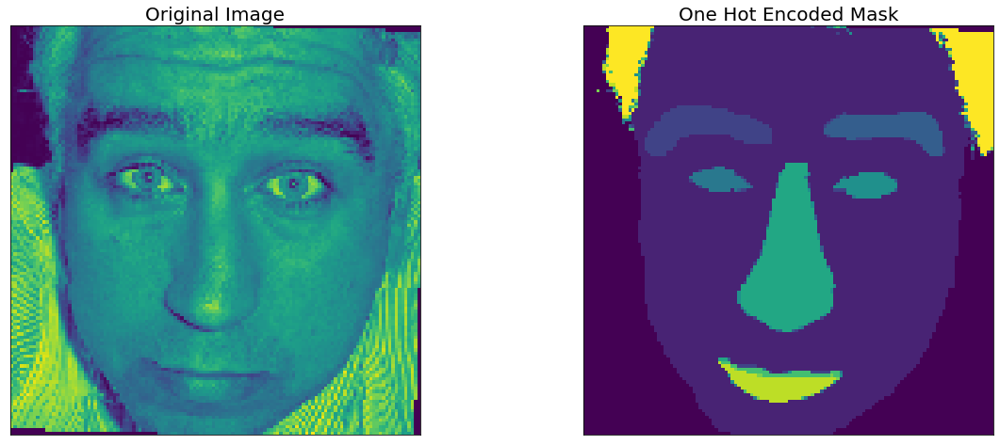

18


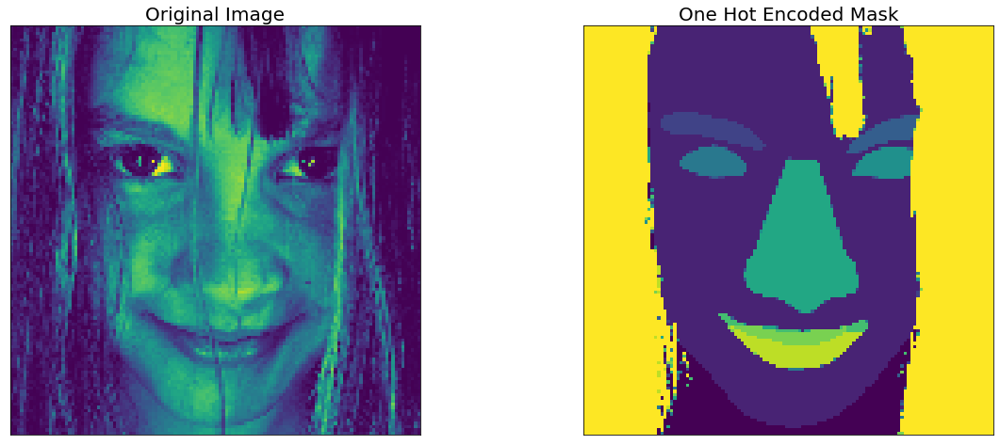

19


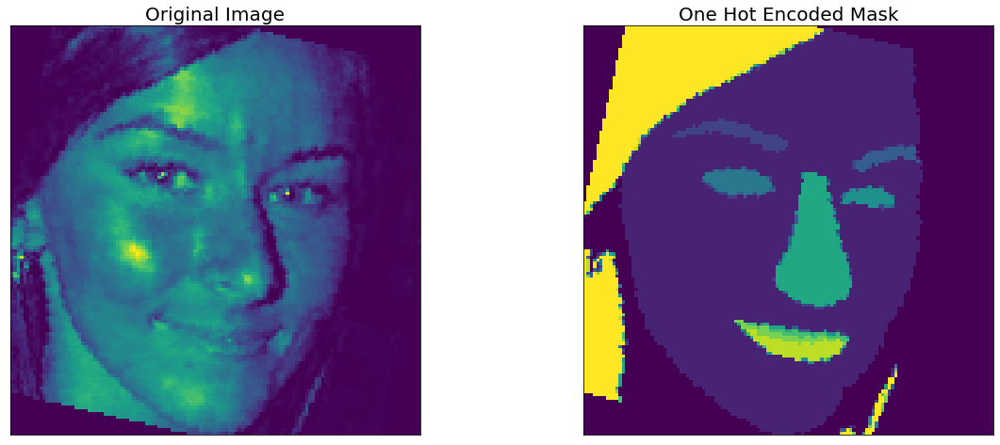

20


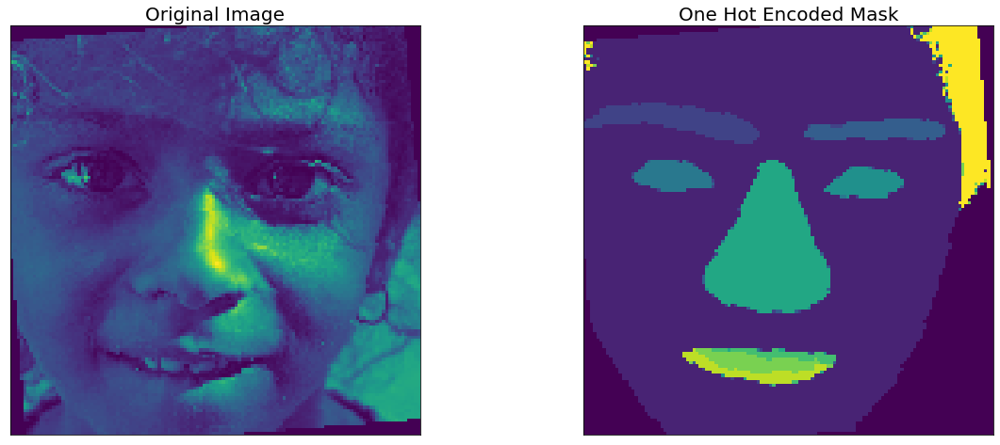

21


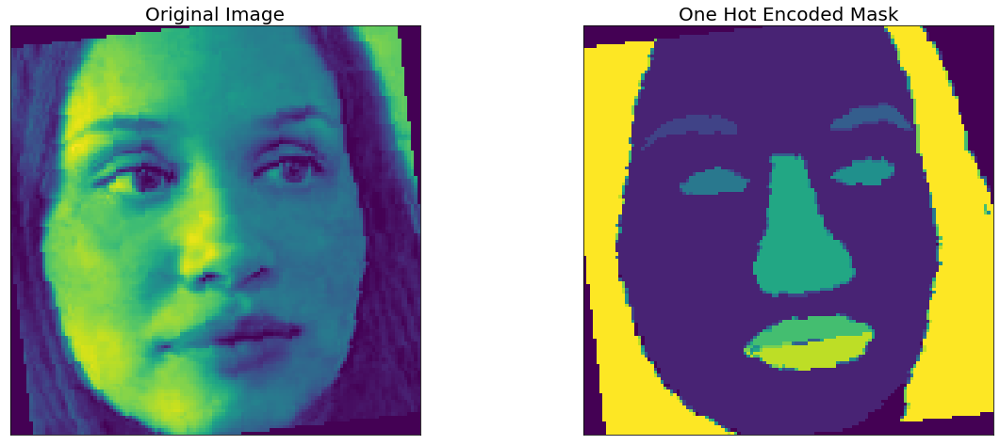

22


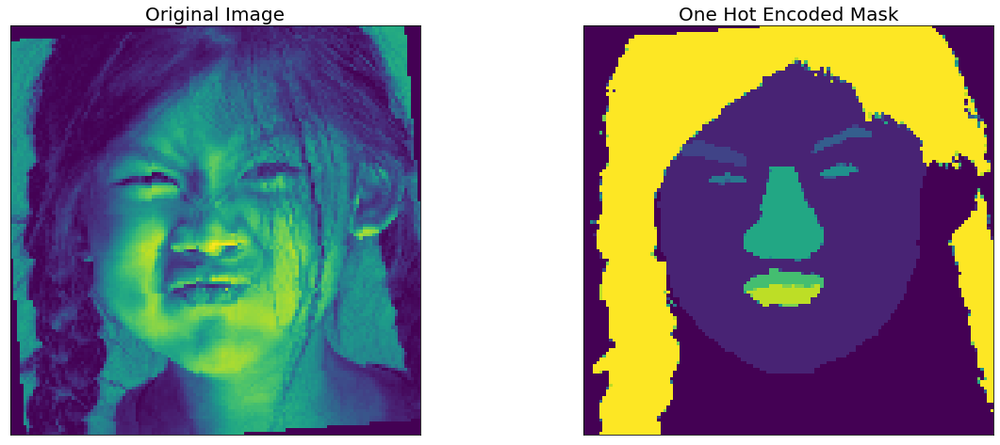

23


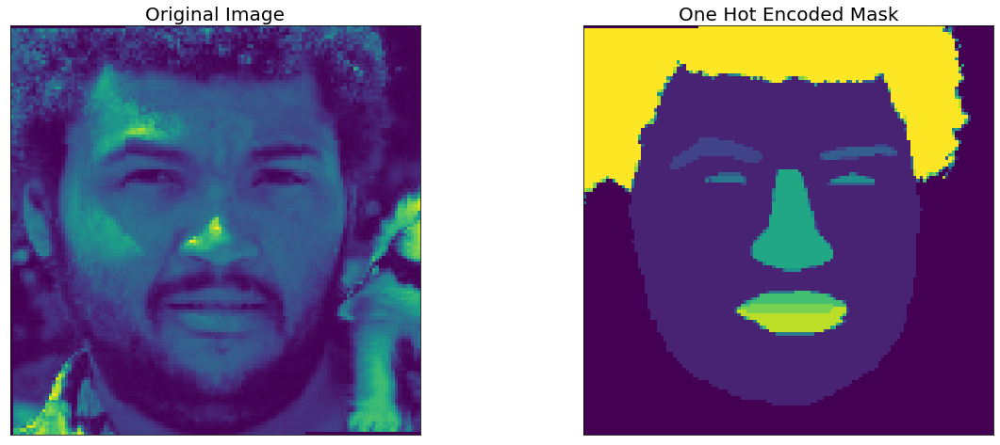

24


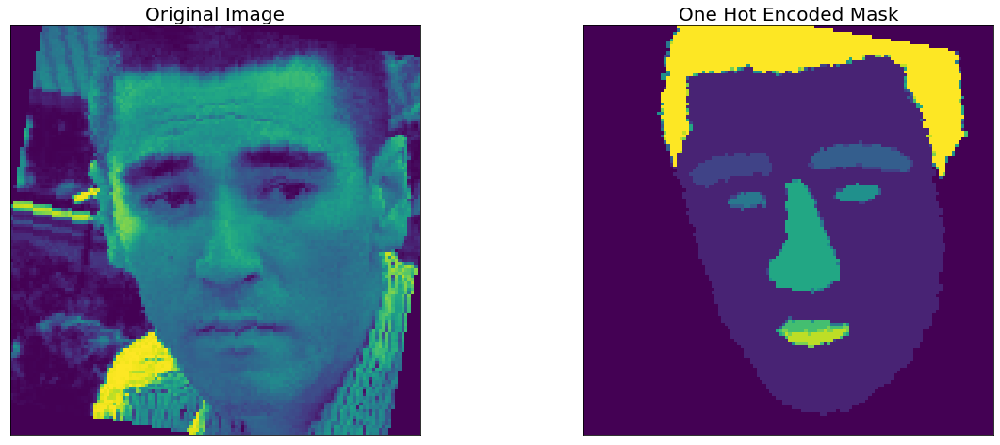

25


KeyboardInterrupt: ignored

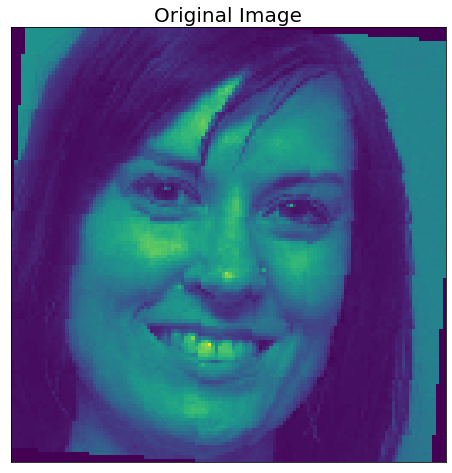

In [10]:
import matplotlib.pyplot as plt


for x in range(len(X[:100])):
  print(x)
  visualize(
      original_image = X[x][0,::],
      #ground_truth_mask = colour_code_segmentation(reverse_one_hot(y_test[0]), rgb_vals),
      one_hot_encoded_mask = reverse_one_hot(Y[x])
  )

reverse_one_hot(Y[0]).shape

## Dataset creation

In [11]:
import torchvision.transforms as T
import torchvision.transforms.functional as F
import random

class MyDataSet(torch.utils.data.Dataset):
  def __init__(self, x, y):
    super(MyDataSet, self).__init__()
    
    # store the augmented tensors tensors
    self._x, self._y = x,y

  def __len__(self):
    # a DataSet must know it size
    return self._x.shape[0]

  def __getitem__(self, index):
    x = self._x[index, :].float()
    y = self._y[index, :].float()
    # print("GETTING ITEM")
    return x, y

train_ds = MyDataSet(X, Y)


In [12]:
! pip install segmentation-models-pytorch

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.7/106.7 KB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 549.1/549.1 KB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 KB 9.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.3/190.3 KB 25.5 MB/s eta 0:00:00
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16446 sha256=ad98c470a6cc09753ccbf3bb555520ced2859ab5571b37f48972bfc1994f1ab1
  Stored in directory: /root/.cache/pip/wheels/84/b9/90/25a0195cf95fb5533db96f1c77ea3f296b7cc86ae8ae48e3dc
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60966 sha256=cdae37a206e1c7444a1b5768d303167a4bcdffa76d4d9074f63566c1fbed64f3
  Stored in directory: /root/.cache/pip/w

## Initialise Models

In [13]:
import segmentation_models_pytorch as smp
from torchvision.models.segmentation import fcn_resnet50, FCN_ResNet50_Weights, lraspp_mobilenet_v3_large

In [14]:
! pip install pytorch_toolbelt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 157.6/157.6 KB 5.2 MB/s eta 0:00:00


### Hyper Parameters

In [ ]:
from segmentation_models_pytorch import utils
import os

# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

weights = weights=torch.tensor([0.1, 1, 1, 1, 1, 1, 0.8, 1, 0.8, 1, 0.1])
# define loss function
loss = smp.utils.losses.BCELoss()

# define evalusation metrics
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]



## Train Model

In [16]:
import matplotlib.pyplot as plt

In [15]:
! pip install torchmetrics

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 517.2/517.2 KB 10.7 MB/s eta 0:00:00


### Function to view train model precitions

In [17]:
from sklearn.metrics import jaccard_score, f1_score
import tensorflow as tf
from torchmetrics.classification import F1Score, BinaryF1Score, MulticlassF1Score, JaccardIndex
from torchmetrics import Dice
from sklearn.preprocessing import MultiLabelBinarizer
from torchvision.utils import save_image
from PIL import Image

def average(lst):
    return sum(lst) / len(lst)

def view_predictions(model, ds, numm_classes ):

    ious = []
    f1s = []

    #predict
    for idx in range(len(ds)):

        image, gt_mask = ds[idx]
        image_vis = ds[idx][0]
        image_vis = np.transpose(image_vis,(1,2,0))
        print(image_vis.shape)
        
        x_tensor = image.to(DEVICE).unsqueeze(0)
        # Predict test image
        pred_mask = model(x_tensor)
        print("predraw", pred_mask.shape)
        print("gtraw", gt_mask.shape)
        pred_mask = pred_mask.detach().squeeze().cpu().numpy()
        # Convert pred_mask from `CHW` format to `HWC` format
        print(pred_mask.shape)
        # Get prediction channel corresponding to face
        pred_mask = colour_code_segmentation(reverse_one_hot(torch.tensor(pred_mask)), rgb_vals)
        print(pred_mask.shape)
        
        # Convert gt_mask from `CHW` format to `HWC` format
        print(gt_mask.shape)
        gt_mask = colour_code_segmentation(reverse_one_hot(torch.tensor(gt_mask)), rgb_vals)
        
        #get IoU score
        m = tf.keras.metrics.MeanIoU(num_classes=numm_classes)
        m.update_state(gt_mask, pred_mask)
        iou = m.result().numpy()
        #print("MEAN IoU:" , iou)
        ious.append(iou)

        #Get f1
        #m = MultiLabelBinarizer().fit(gt_mask)
        #f1 = f1_score(m.transform(gt_mask), m.transform(pred_mask), average=None)
        #if len(f1) == num_classes:
        #  f1s.append(f1)

        metric = MulticlassF1Score(num_classes=numm_classes, average=None, labels=np.unique(pred_mask) ,validate_args=True)
        #metric = JaccardIndex(task="multiclass",num_classes=numm_classes, average=None, labels=np.unique(pred_mask) ,validate_args=True)
        f1 = metric(torch.tensor(pred_mask), torch.tensor(gt_mask))
        print(f1)
        if len(f1) == num_classes:
          f1[f1 <0.1] = np.nan
          print(f1)
          f1s.append(np.array(f1))

        if idx:
          visualize(
              original_image = image_vis[:,:,0],
              ground_truth_mask = gt_mask,
              predicted_mask = pred_mask,
          )

    fs1_numpy = np.array(f1s)
    av_f1s = np.nanmean(fs1_numpy, axis=0)
    #av_f1s = fs1_numpy.mean(axis=0)
    av_f1s_av = av_f1s.mean(axis=0)

    print ("Dataset MIoU = ", average(ious))
    print ("Dataset F1 = ", av_f1s)
    print ("Dataset F1 av = ", av_f1s_av)

In [18]:
from torchvision.utils import save_image
from PIL import Image

def save_predictions(model, ds, path):

  xs = []
  ys = []

  #predict
  for idx in range(len(ds)):

      # Pop image from DS
      image, gt_mask = ds[idx]
      image_vis = ds[idx][0]
      image_vis = np.transpose(image_vis,(1,2,0))
      
      # Reshape
      x_tensor = image.to(DEVICE).unsqueeze(0)
      # Predict test image
      pred_mask = model(x_tensor)
      # Reshape
      pred_mask = pred_mask.detach().squeeze().cpu()
      # Decode Onehots
      pred_mask = colour_code_segmentation(reverse_one_hot(torch.tensor(pred_mask)), rgb_vals)
      gt_mask = colour_code_segmentation(reverse_one_hot(torch.tensor(gt_mask)), rgb_vals)

      # Sanity check
    #  print(image_vis.shape)
      #print("GT", gt_mask.shape)
     # print("PRED", pred_mask.shape)

      # Save Predictions for use in Label Adapter
      xs.append(pred_mask)

      ys.append(gt_mask)
      
  return xs, ys

#save_predictions(model, val_ds)

### Load and view model predictions

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])


<ipython-input-17-fd270ad57355>:39: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  gt_mask = colour_code_segmentation(reverse_one_hot(torch.tensor(gt_mask)), rgb_vals)


tensor([0.8182, 0.8371, 0.6298, 0.5991, 0.6455, 0.7239, 0.8810, 0.8271, 0.4304,
        0.7821, 0.8734])
tensor([0.8182, 0.8371, 0.6298, 0.5991, 0.6455, 0.7239, 0.8810, 0.8271, 0.4304,
        0.7821, 0.8734])
torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9129, 0.8881, 0.6593, 0.7225, 0.0000, 0.1975, 0.8133, 0.2941, 0.3493,
        0.7213, 0.7832])
tensor([0.9129, 0.8881, 0.6593, 0.7225,    nan, 0.1975, 0.8133, 0.2941, 0.3493,
        0.7213, 0.7832])


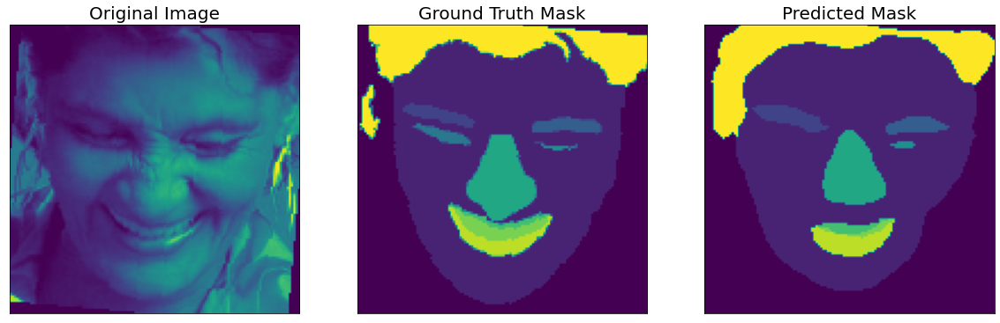

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9567, 0.9601, 0.7493, 0.7254, 0.7327, 0.7979, 0.8854, 0.7692, 0.6667,
        0.7249, 0.9163])
tensor([0.9567, 0.9601, 0.7493, 0.7254, 0.7327, 0.7979, 0.8854, 0.7692, 0.6667,
        0.7249, 0.9163])


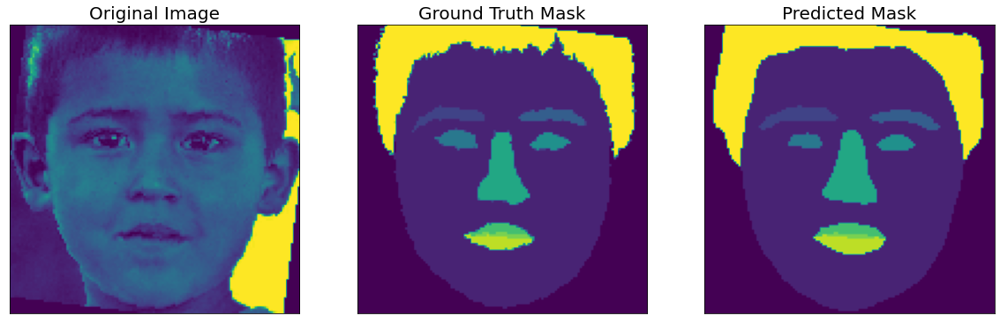

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.4106, 0.9438, 0.7039, 0.7212, 0.8729, 0.8633, 0.9338, 0.6347, 0.0000,
        0.8182, 0.5520])
tensor([0.4106, 0.9438, 0.7039, 0.7212, 0.8729, 0.8633, 0.9338, 0.6347,    nan,
        0.8182, 0.5520])


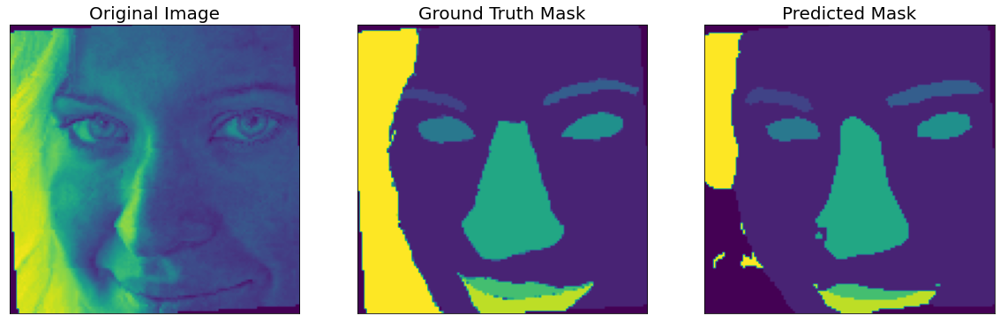

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9406, 0.9540, 0.5464, 0.6960, 0.6800, 0.6620, 0.8830, 0.7400, 0.7696,
        0.8354, 0.9308])
tensor([0.9406, 0.9540, 0.5464, 0.6960, 0.6800, 0.6620, 0.8830, 0.7400, 0.7696,
        0.8354, 0.9308])


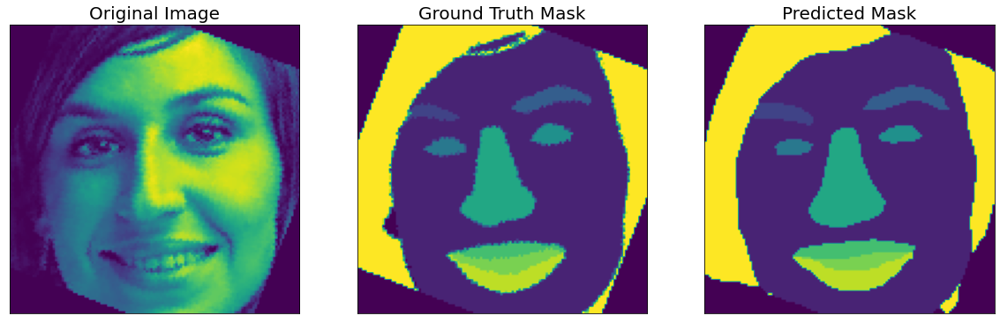

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9695, 0.9366, 0.6394, 0.7322, 0.7027, 0.5692, 0.8845, 0.6923, 0.8108,
        0.4812, 0.7801])
tensor([0.9695, 0.9366, 0.6394, 0.7322, 0.7027, 0.5692, 0.8845, 0.6923, 0.8108,
        0.4812, 0.7801])


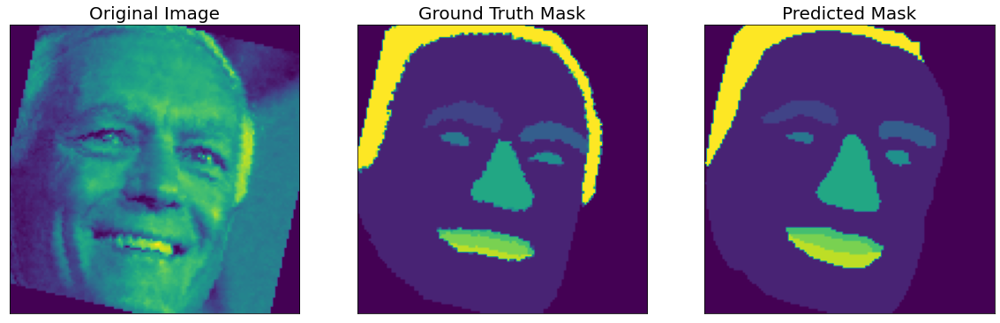

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9790, 0.9662, 0.7379, 0.7809, 0.7750, 0.6667, 0.9306, 0.7068, 0.0000,
        0.7410, 0.9060])
tensor([0.9790, 0.9662, 0.7379, 0.7809, 0.7750, 0.6667, 0.9306, 0.7068,    nan,
        0.7410, 0.9060])


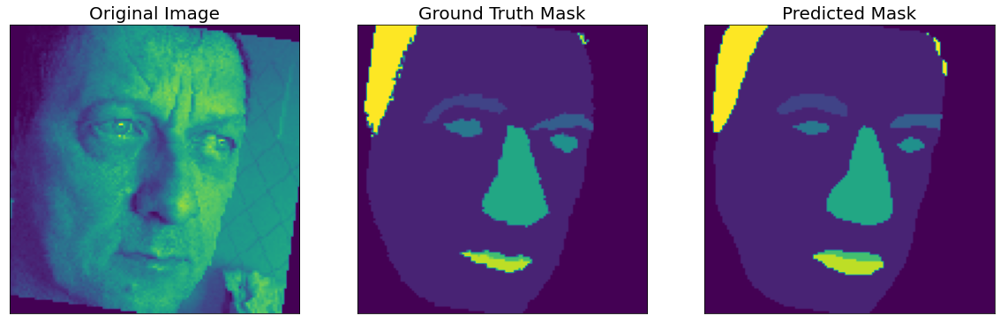

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9457, 0.9416, 0.3964, 0.1320, 0.5755, 0.4211, 0.9181, 0.5815, 0.7585,
        0.6992, 0.8519])
tensor([0.9457, 0.9416, 0.3964, 0.1320, 0.5755, 0.4211, 0.9181, 0.5815, 0.7585,
        0.6992, 0.8519])


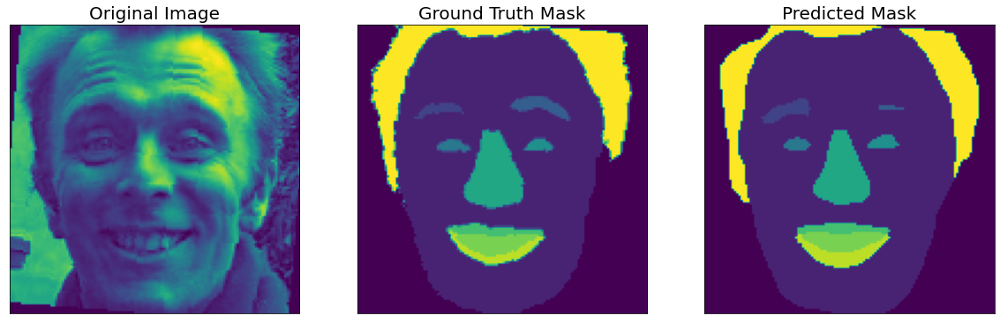

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.8598, 0.9490, 0.0000, 0.0000, 0.4588, 0.5153, 0.8950, 0.7588, 0.6556,
        0.7145, 0.9644])
tensor([0.8598, 0.9490,    nan,    nan, 0.4588, 0.5153, 0.8950, 0.7588, 0.6556,
        0.7145, 0.9644])


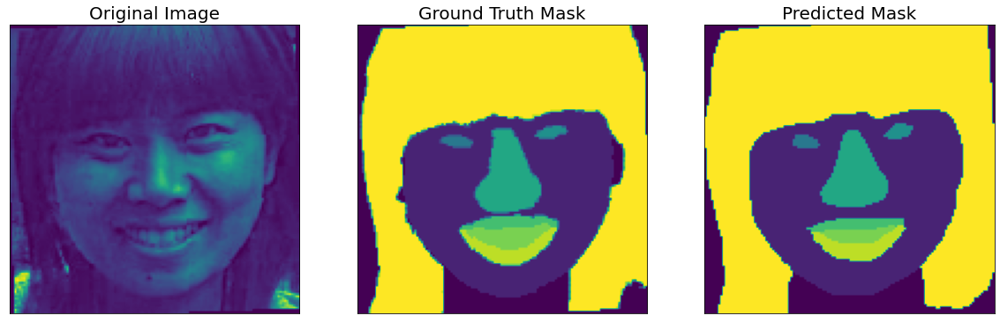

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9846, 0.9479, 0.6226, 0.3412, 0.7927, 0.6862, 0.8040, 0.4604, 0.0000,
        0.7863, 0.0000])
tensor([0.9846, 0.9479, 0.6226, 0.3412, 0.7927, 0.6862, 0.8040, 0.4604,    nan,
        0.7863,    nan])


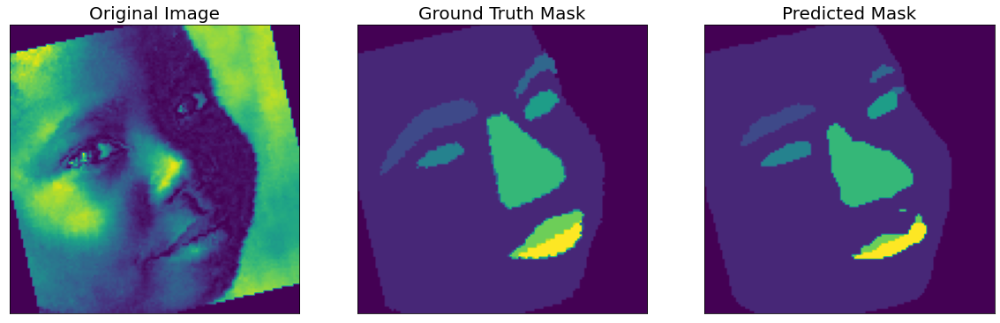

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9638, 0.9620, 0.6488, 0.5942, 0.8551, 0.8451, 0.9453, 0.8159, 0.0000,
        0.8216, 0.0000])
tensor([0.9638, 0.9620, 0.6488, 0.5942, 0.8551, 0.8451, 0.9453, 0.8159,    nan,
        0.8216,    nan])


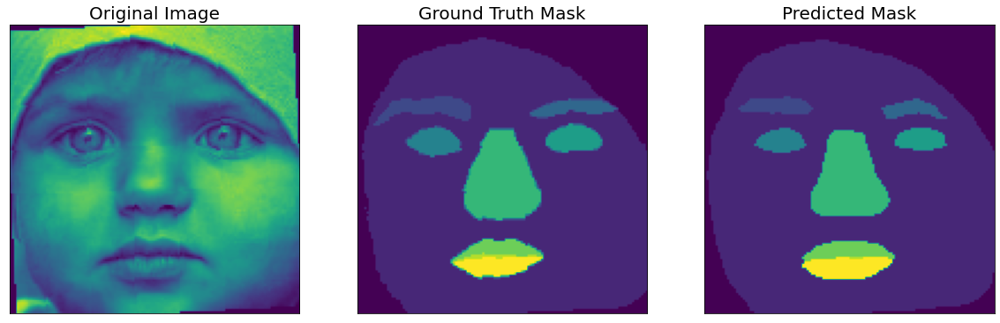

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9672, 0.9634, 0.7676, 0.7506, 0.6767, 0.6535, 0.9397, 0.6298, 0.0000,
        0.6435, 0.7977])
tensor([0.9672, 0.9634, 0.7676, 0.7506, 0.6767, 0.6535, 0.9397, 0.6298,    nan,
        0.6435, 0.7977])


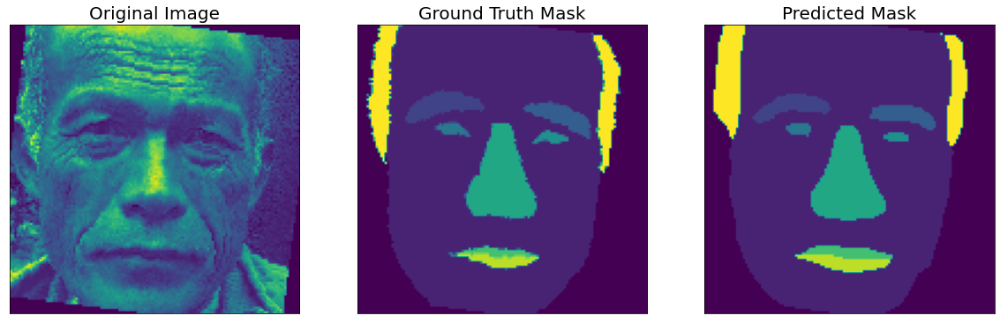

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.8590, 0.9198, 0.3207, 0.4740, 0.3182, 0.3279, 0.8522, 0.5931, 0.0000,
        0.6979, 0.8714])
tensor([0.8590, 0.9198, 0.3207, 0.4740, 0.3182, 0.3279, 0.8522, 0.5931,    nan,
        0.6979, 0.8714])


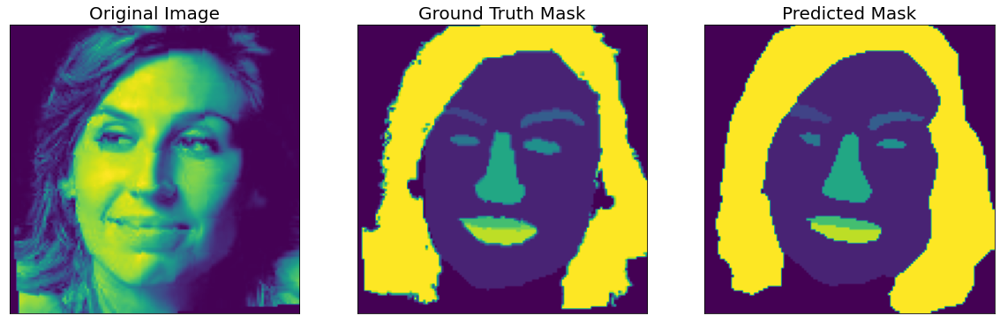

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.8528, 0.9450, 0.7258, 0.5045, 0.7276, 0.6933, 0.8938, 0.6474, 0.0000,
        0.2313, 0.9553])
tensor([0.8528, 0.9450, 0.7258, 0.5045, 0.7276, 0.6933, 0.8938, 0.6474,    nan,
        0.2313, 0.9553])


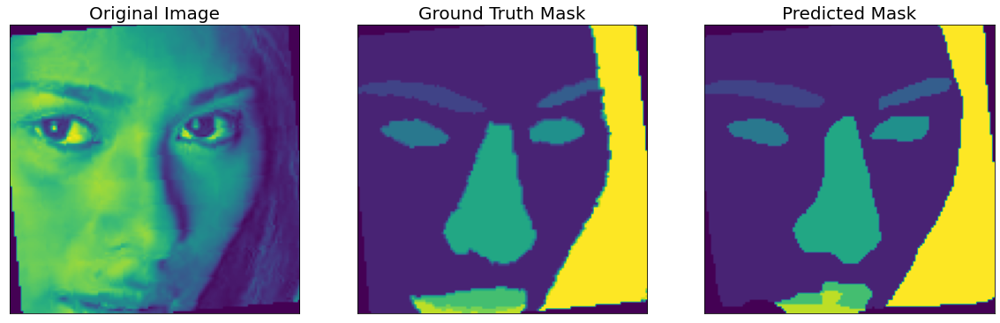

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9170, 0.9160, 0.7956, 0.7645, 0.6944, 0.7527, 0.9204, 0.5057, 0.0000,
        0.5287, 0.7608])
tensor([0.9170, 0.9160, 0.7956, 0.7645, 0.6944, 0.7527, 0.9204, 0.5057,    nan,
        0.5287, 0.7608])


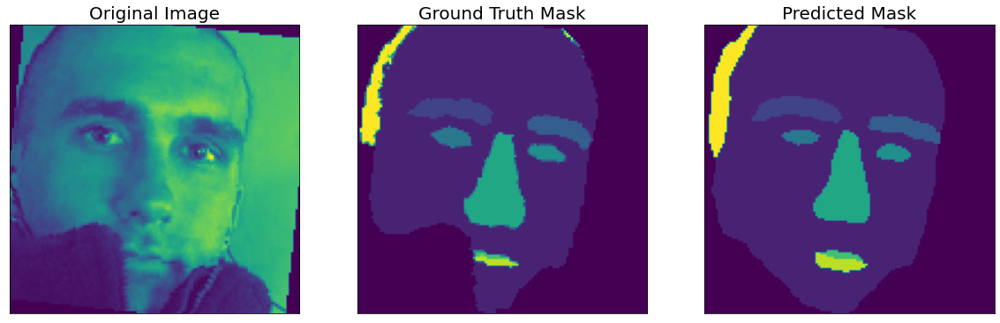

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9404, 0.9711, 0.6912, 0.5174, 0.0000, 0.6429, 0.9615, 0.7004, 0.0000,
        0.7004, 0.4490])
tensor([0.9404, 0.9711, 0.6912, 0.5174,    nan, 0.6429, 0.9615, 0.7004,    nan,
        0.7004, 0.4490])


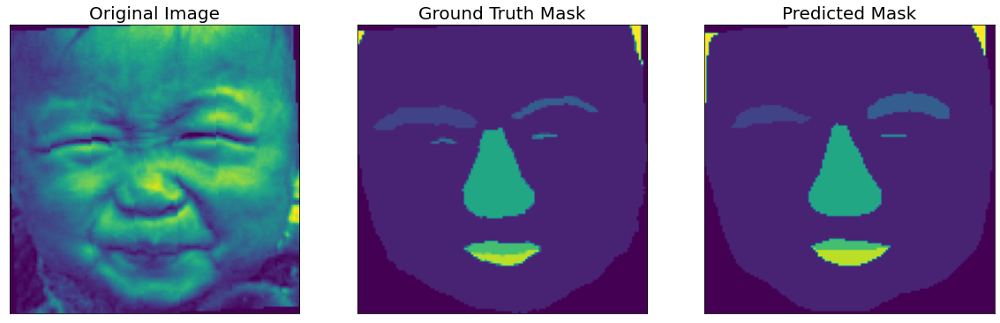

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.8972, 0.9346, 0.3793, 0.0559, 0.2474, 0.3288, 0.8585, 0.4615, 0.0000,
        0.7530, 0.7130])
tensor([0.8972, 0.9346, 0.3793,    nan, 0.2474, 0.3288, 0.8585, 0.4615,    nan,
        0.7530, 0.7130])


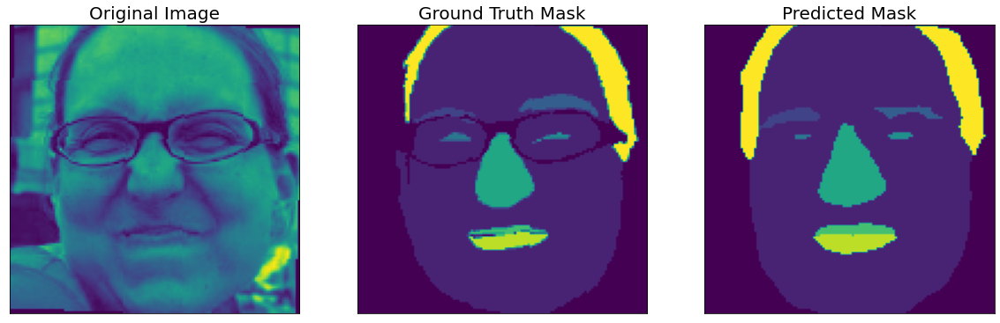

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9447, 0.9535, 0.7315, 0.8073, 0.7647, 0.7586, 0.9348, 0.5714, 0.0000,
        0.8683, 0.7764])
tensor([0.9447, 0.9535, 0.7315, 0.8073, 0.7647, 0.7586, 0.9348, 0.5714,    nan,
        0.8683, 0.7764])


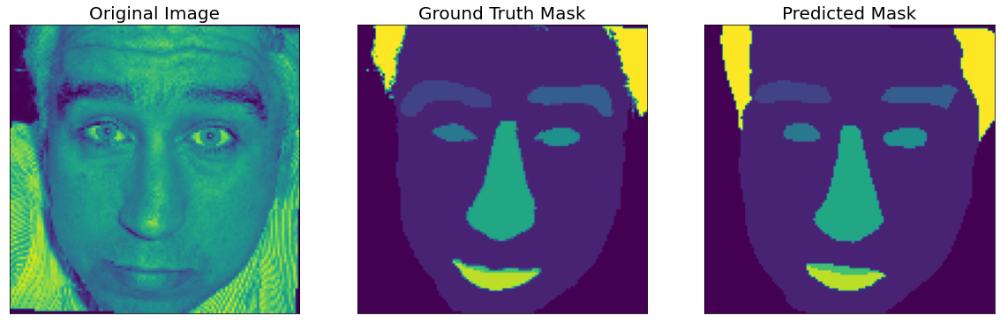

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.6159, 0.9009, 0.7815, 0.4566, 0.7661, 0.7120, 0.8807, 0.1451, 0.0000,
        0.8529, 0.8844])
tensor([0.6159, 0.9009, 0.7815, 0.4566, 0.7661, 0.7120, 0.8807, 0.1451,    nan,
        0.8529, 0.8844])


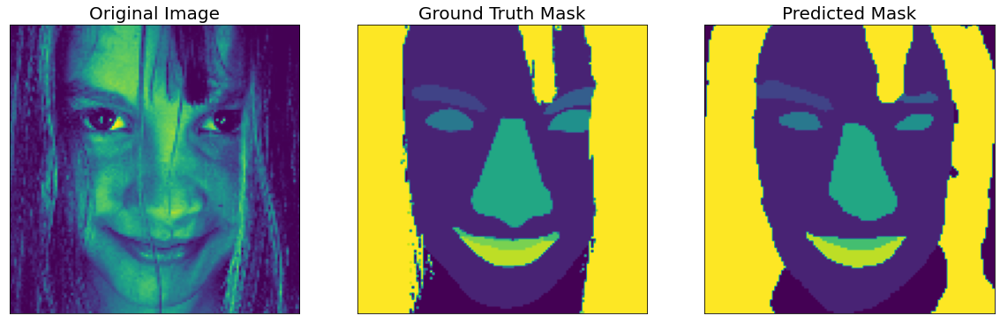

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.8992, 0.9364, 0.5758, 0.5308, 0.5537, 0.5714, 0.8655, 0.4258, 0.0000,
        0.7578, 0.8433])
tensor([0.8992, 0.9364, 0.5758, 0.5308, 0.5537, 0.5714, 0.8655, 0.4258,    nan,
        0.7578, 0.8433])


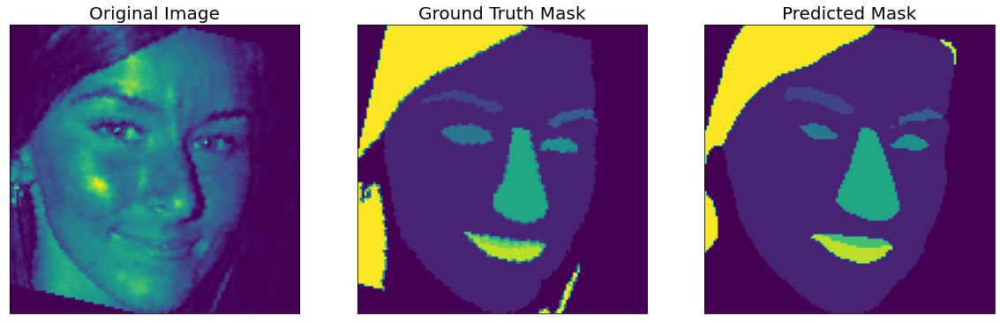

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9395, 0.9582, 0.7582, 0.7958, 0.9005, 0.8822, 0.8973, 0.5038, 0.4280,
        0.6358, 0.8130])
tensor([0.9395, 0.9582, 0.7582, 0.7958, 0.9005, 0.8822, 0.8973, 0.5038, 0.4280,
        0.6358, 0.8130])


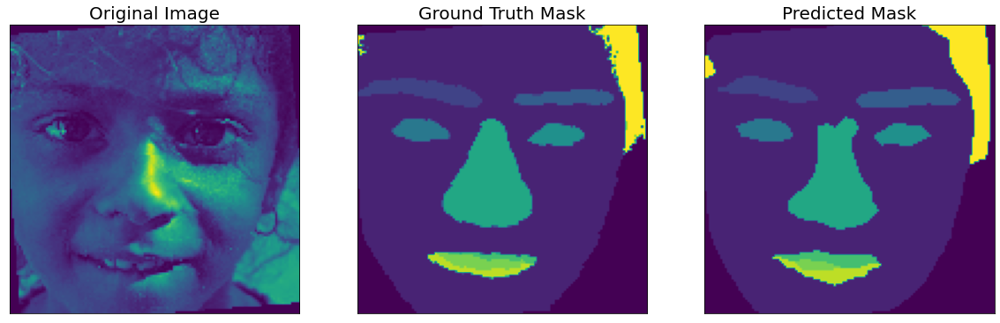

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.8806, 0.9536, 0.5641, 0.5310, 0.6710, 0.6000, 0.9144, 0.8194, 0.0000,
        0.8134, 0.9513])
tensor([0.8806, 0.9536, 0.5641, 0.5310, 0.6710, 0.6000, 0.9144, 0.8194,    nan,
        0.8134, 0.9513])


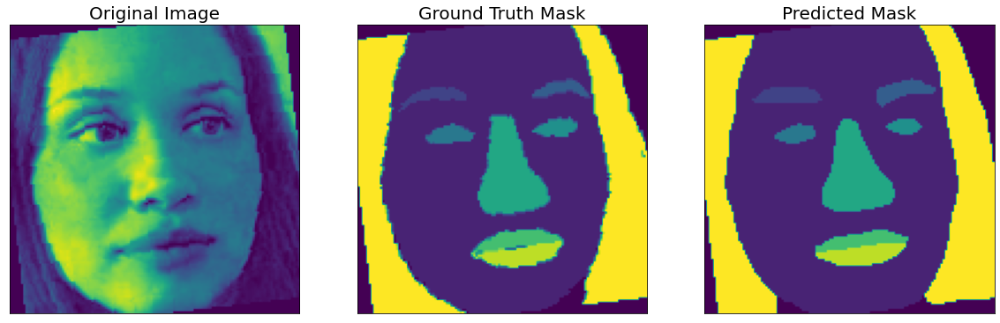

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9107, 0.9165, 0.6577, 0.5634, 0.0714, 0.5867, 0.9281, 0.7650, 0.0000,
        0.7433, 0.9210])
tensor([0.9107, 0.9165, 0.6577, 0.5634,    nan, 0.5867, 0.9281, 0.7650,    nan,
        0.7433, 0.9210])


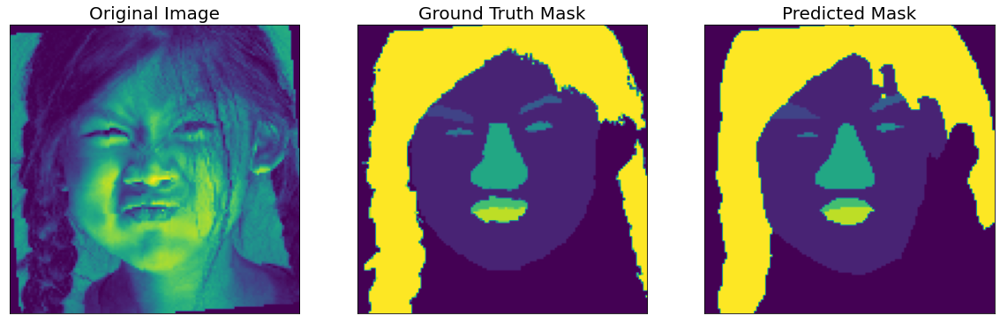

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9395, 0.9319, 0.6867, 0.4030, 0.1935, 0.0000, 0.8474, 0.5837, 0.0708,
        0.7136, 0.8987])
tensor([0.9395, 0.9319, 0.6867, 0.4030, 0.1935,    nan, 0.8474, 0.5837,    nan,
        0.7136, 0.8987])


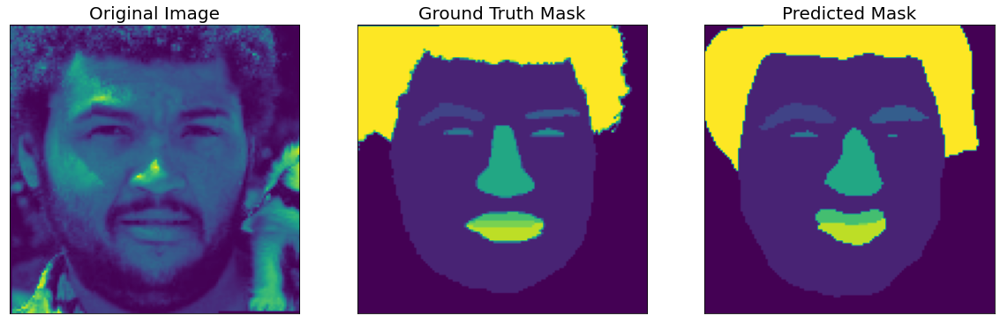

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9450, 0.9254, 0.7488, 0.8036, 0.4848, 0.5344, 0.9087, 0.6797, 0.0000,
        0.6111, 0.8627])
tensor([0.9450, 0.9254, 0.7488, 0.8036, 0.4848, 0.5344, 0.9087, 0.6797,    nan,
        0.6111, 0.8627])


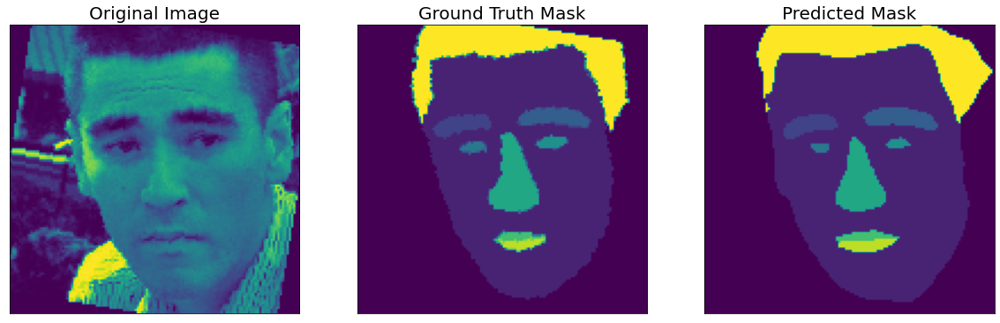

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9522, 0.9512, 0.6193, 0.6911, 0.6550, 0.6405, 0.9429, 0.5909, 0.8224,
        0.8156, 0.9579])
tensor([0.9522, 0.9512, 0.6193, 0.6911, 0.6550, 0.6405, 0.9429, 0.5909, 0.8224,
        0.8156, 0.9579])


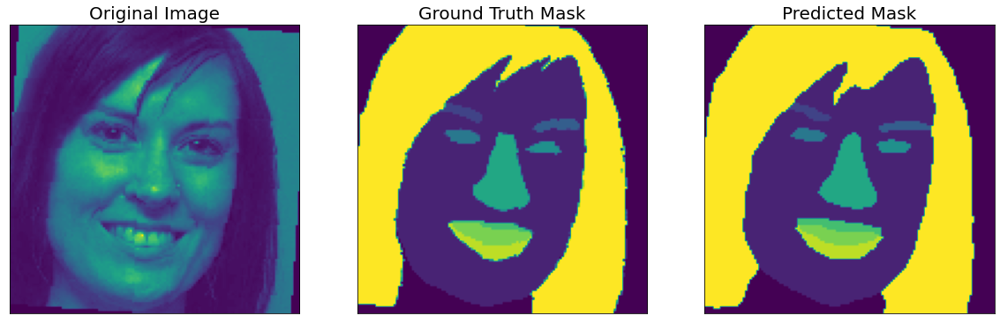

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.8996, 0.9385, 0.7087, 0.6557, 0.4000, 0.6748, 0.8814, 0.5088, 0.7243,
        0.0306, 0.9077])
tensor([0.8996, 0.9385, 0.7087, 0.6557, 0.4000, 0.6748, 0.8814, 0.5088, 0.7243,
           nan, 0.9077])


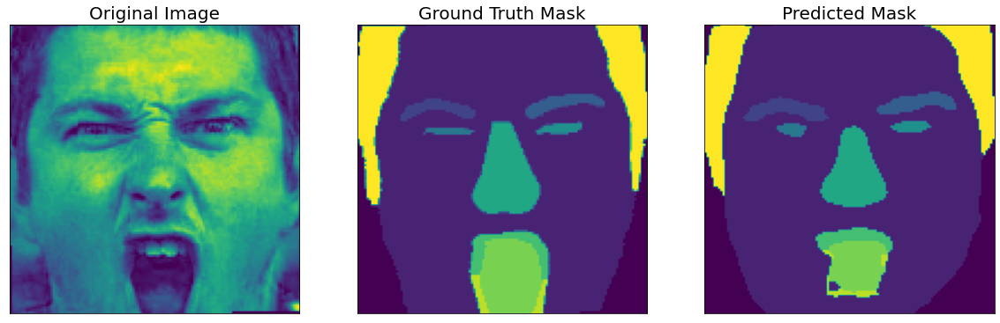

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9612, 0.9288, 0.6522, 0.6406, 0.0000, 0.4800, 0.8550, 0.5797, 0.8562,
        0.7990, 0.9089])
tensor([0.9612, 0.9288, 0.6522, 0.6406,    nan, 0.4800, 0.8550, 0.5797, 0.8562,
        0.7990, 0.9089])


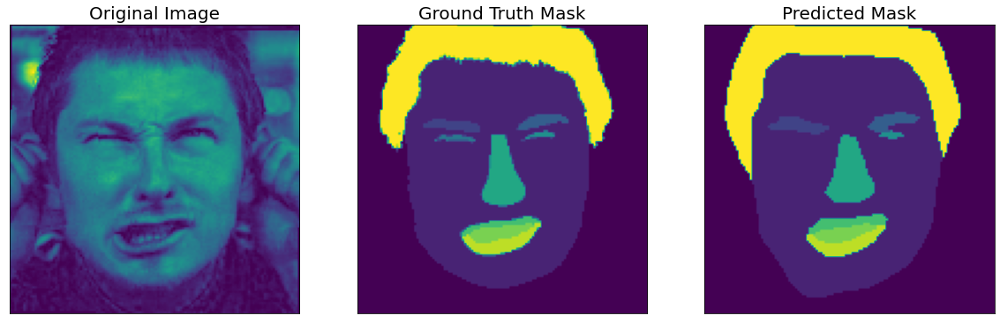

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9330, 0.9307, 0.5157, 0.5522, 0.5455, 0.6294, 0.8988, 0.4724, 0.7393,
        0.5907, 0.8975])
tensor([0.9330, 0.9307, 0.5157, 0.5522, 0.5455, 0.6294, 0.8988, 0.4724, 0.7393,
        0.5907, 0.8975])


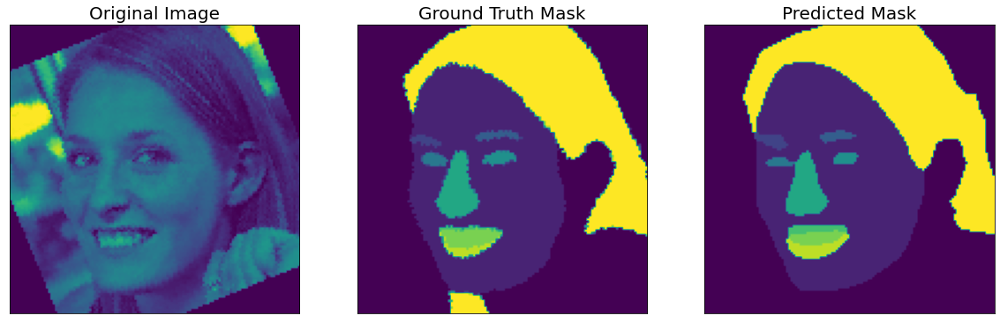

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9685, 0.9357, 0.1348, 0.4932, 0.4894, 0.3617, 0.8869, 0.7043, 0.0000,
        0.4969, 0.0000])
tensor([0.9685, 0.9357, 0.1348, 0.4932, 0.4894, 0.3617, 0.8869, 0.7043,    nan,
        0.4969,    nan])


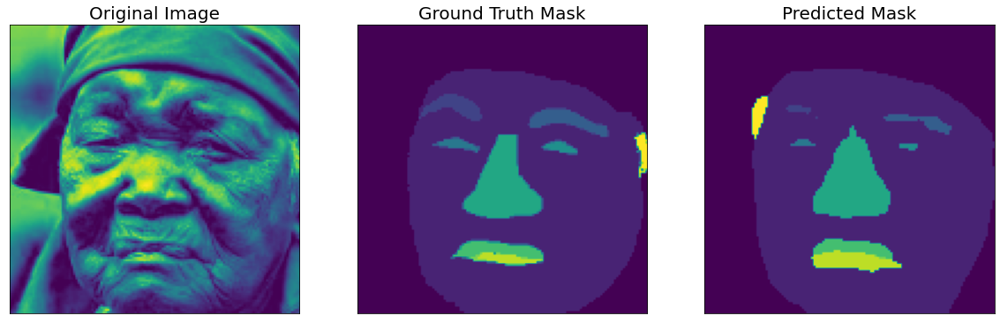

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9202, 0.9368, 0.4949, 0.5714, 0.2727, 0.4412, 0.9116, 0.5370, 0.7602,
        0.7358, 0.9023])
tensor([0.9202, 0.9368, 0.4949, 0.5714, 0.2727, 0.4412, 0.9116, 0.5370, 0.7602,
        0.7358, 0.9023])


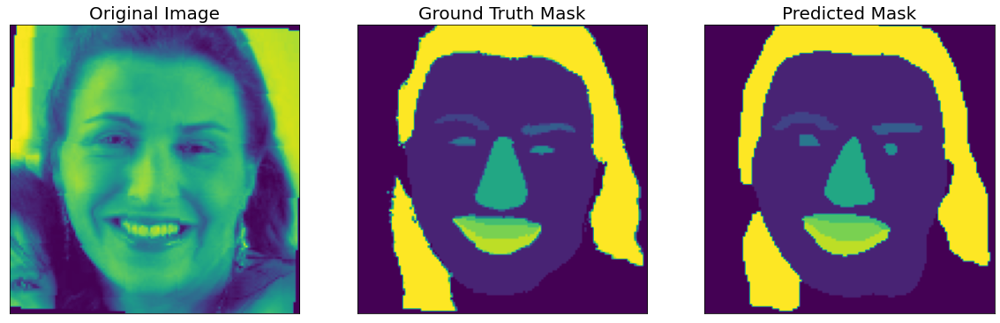

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.8229, 0.9350, 0.7133, 0.8000, 0.6566, 0.6591, 0.9227, 0.6579, 0.0000,
        0.6923, 0.3406])
tensor([0.8229, 0.9350, 0.7133, 0.8000, 0.6566, 0.6591, 0.9227, 0.6579,    nan,
        0.6923, 0.3406])


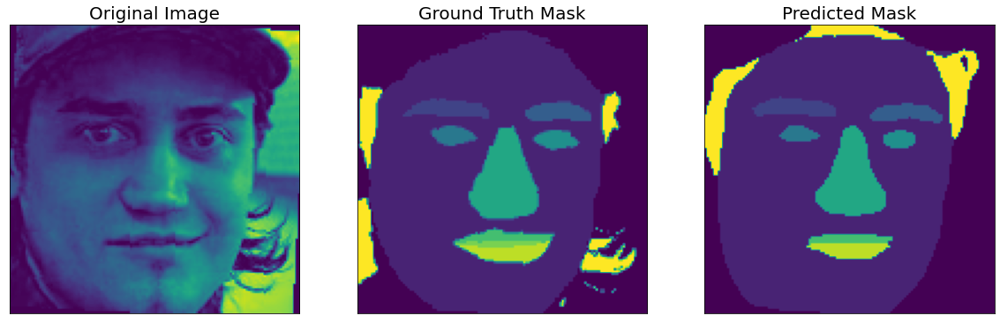

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.7684, 0.8257, 0.0000, 0.0000, 0.0000, 0.7235, 0.3183, 0.0000, 0.0000,
        0.0000, 0.9369])
tensor([0.7684, 0.8257,    nan,    nan,    nan, 0.7235, 0.3183,    nan,    nan,
           nan, 0.9369])


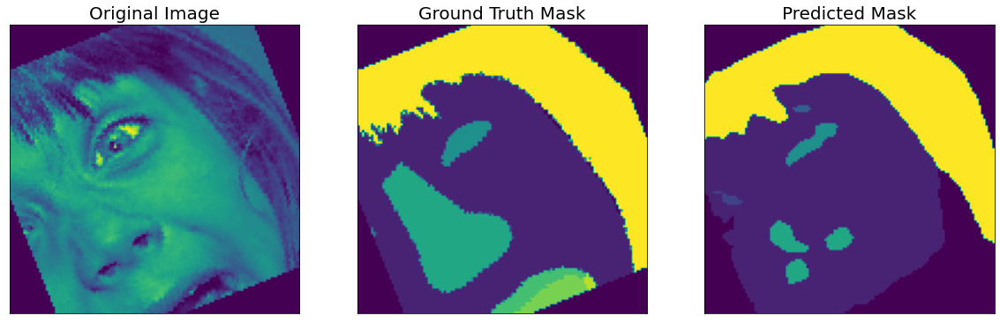

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.8824, 0.9470, 0.6133, 0.6522, 0.6260, 0.6827, 0.9310, 0.6937, 0.0000,
        0.7035, 0.9455])
tensor([0.8824, 0.9470, 0.6133, 0.6522, 0.6260, 0.6827, 0.9310, 0.6937,    nan,
        0.7035, 0.9455])


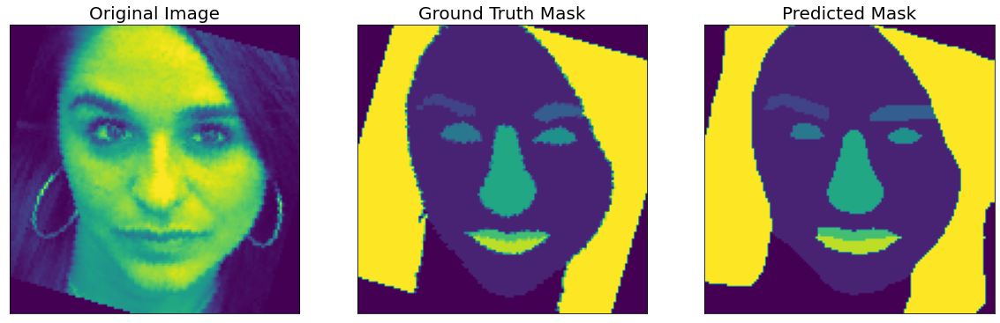

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.8645, 0.9592, 0.6962, 0.6839, 0.6667, 0.7120, 0.9116, 0.7606, 0.0000,
        0.8439, 0.7889])
tensor([0.8645, 0.9592, 0.6962, 0.6839, 0.6667, 0.7120, 0.9116, 0.7606,    nan,
        0.8439, 0.7889])


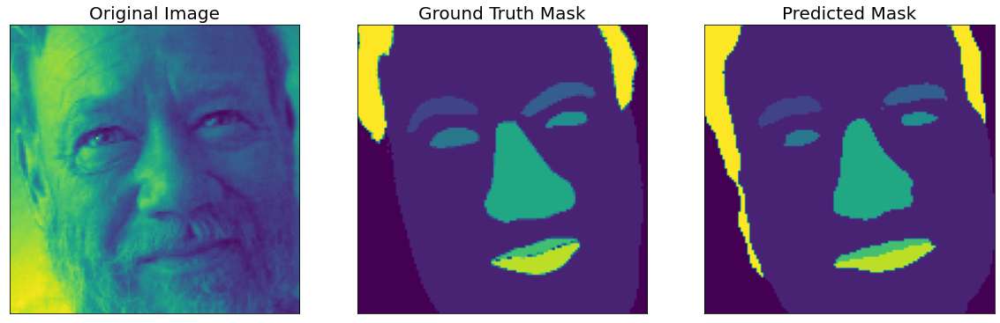

torch.Size([128, 128, 3])
predraw torch.Size([1, 11, 128, 128])
gtraw torch.Size([11, 128, 128])
(11, 128, 128)
(128, 128)
torch.Size([11, 128, 128])
tensor([0.9331, 0.9516, 0.5116, 0.4752, 0.1408, 0.4444, 0.9080, 0.6023, 0.7013,
        0.7160, 0.9215])
tensor([0.9331, 0.9516, 0.5116, 0.4752, 0.1408, 0.4444, 0.9080, 0.6023, 0.7013,
        0.7160, 0.9215])


KeyboardInterrupt: ignored

In [21]:
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = torch.load("/content/drive/MyDrive/FRESH/deeplab.pth", map_location=DEVICE)

view_predictions(model,train_ds, num_classes)

In [ ]:
xs, ys = save_predictions(model, train_ds, "/content/drive/MyDrive/label_adapter_helen_no_aug/")

<ipython-input-25-4363f50fc8a7>:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  pred_mask = colour_code_segmentation(reverse_one_hot(torch.tensor(pred_mask)), rgb_vals)
<ipython-input-25-4363f50fc8a7>:27: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  gt_mask = colour_code_segmentation(reverse_one_hot(torch.tensor(gt_mask)), rgb_vals)


In [ ]:
len(xs)

90

validation set


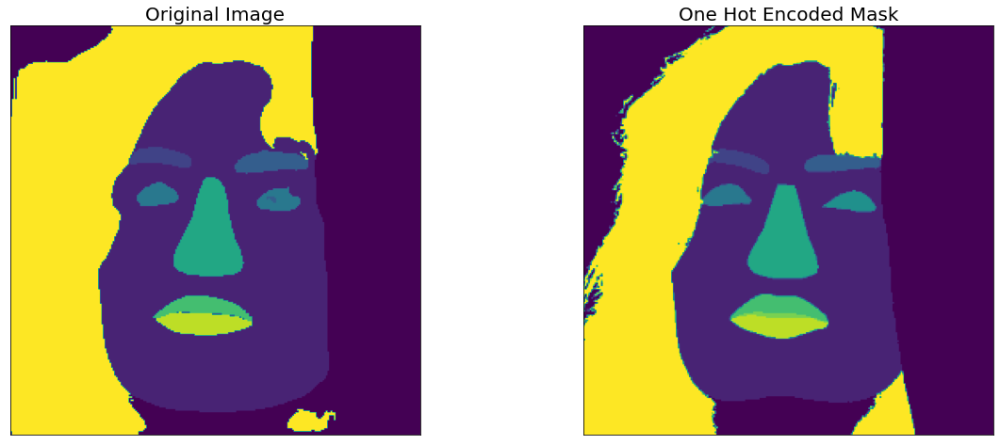

validation set


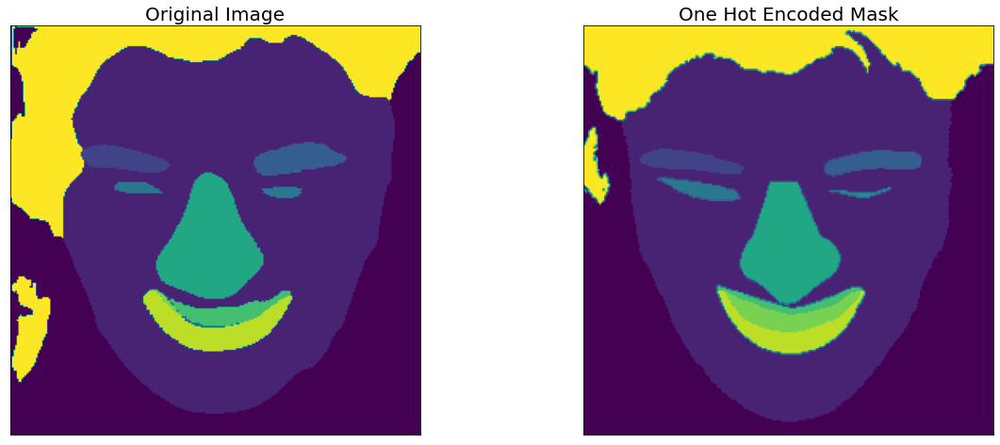

validation set


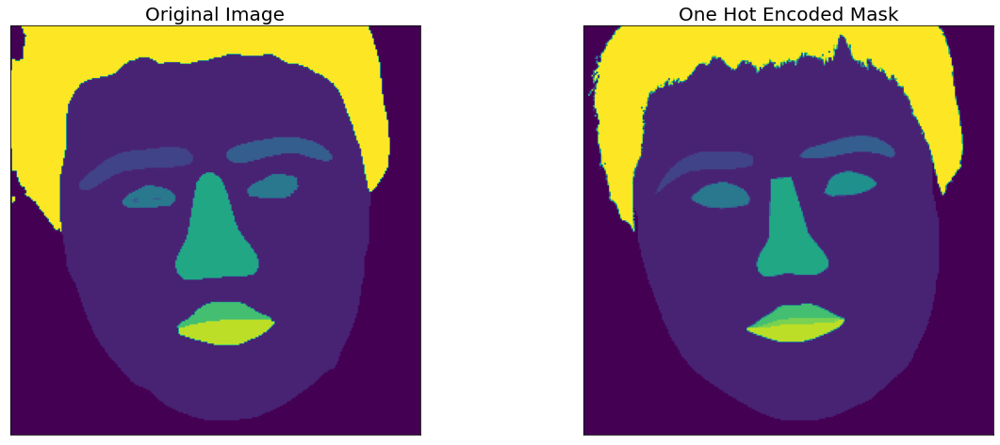

validation set


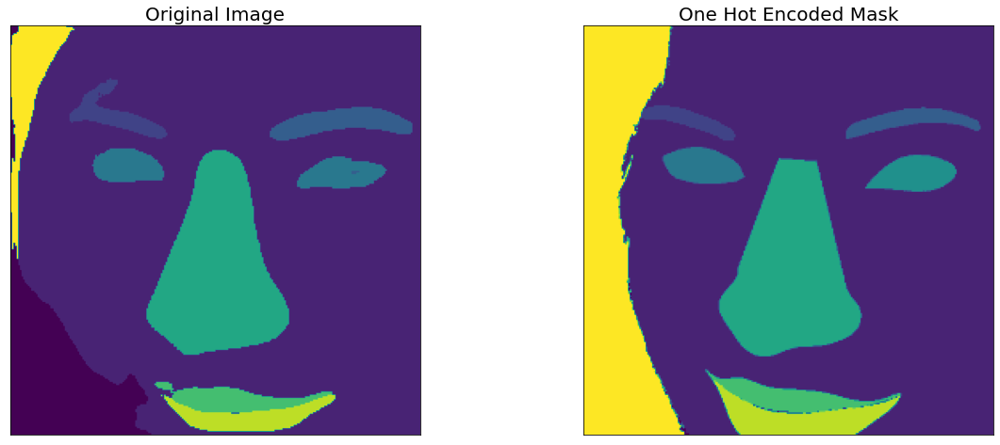

validation set


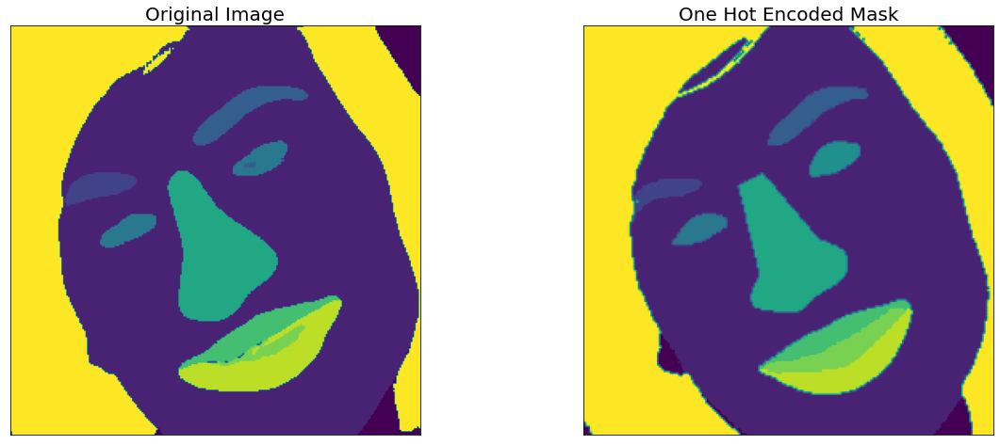

validation set


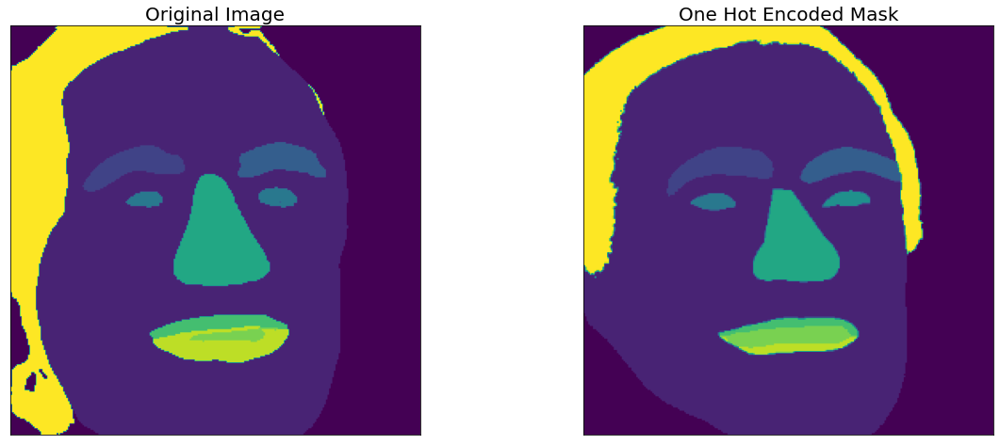

validation set


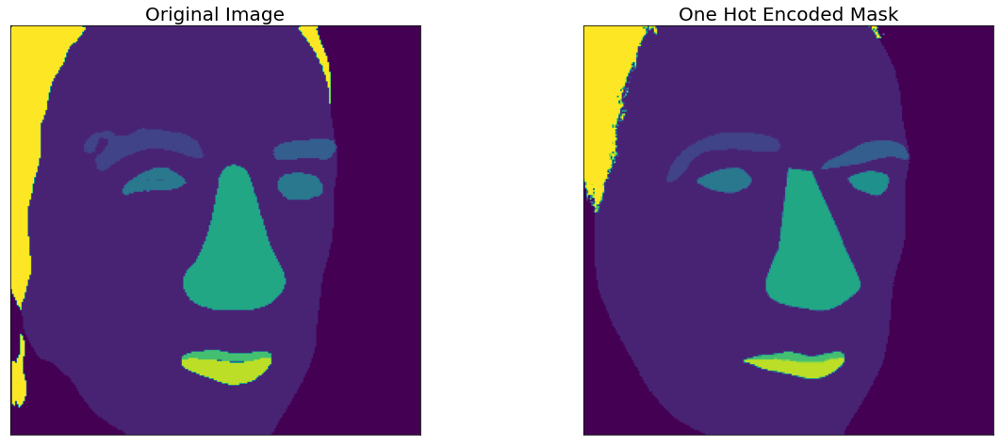

validation set


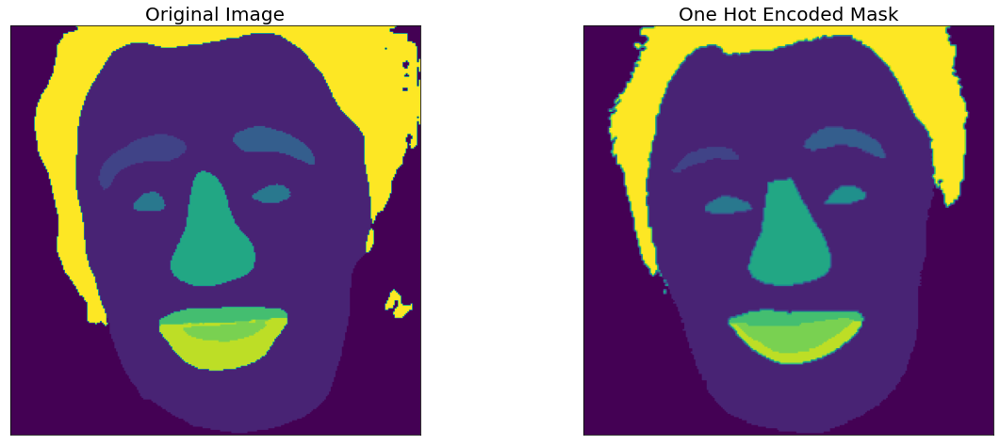

validation set


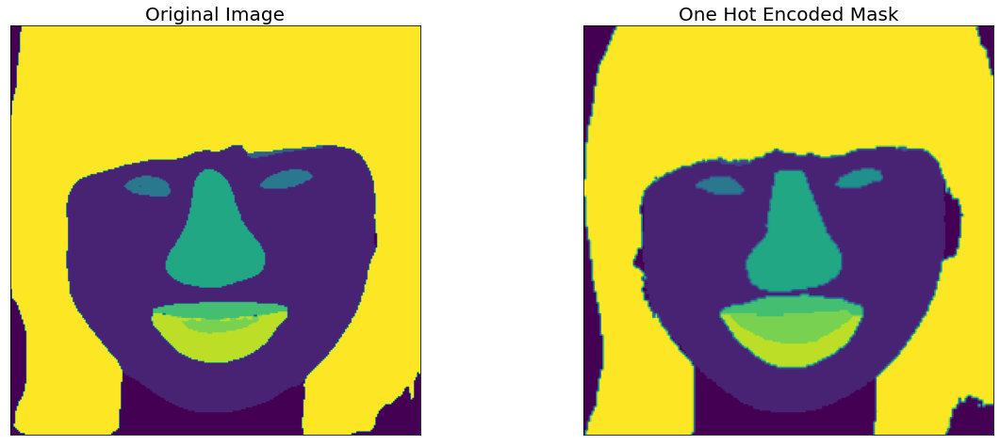

validation set


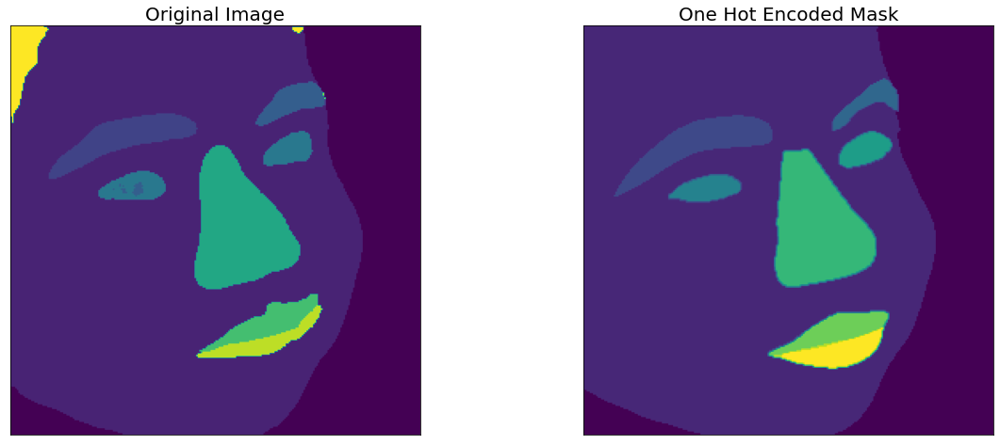

validation set


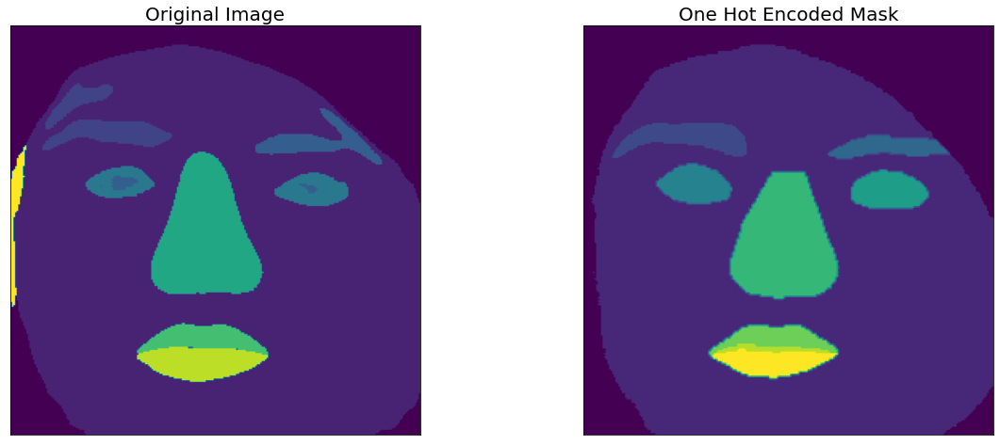

validation set


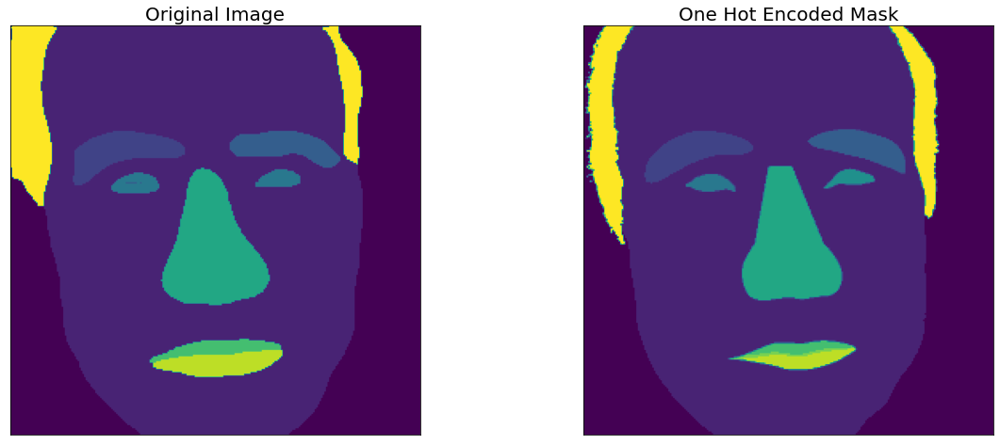

validation set


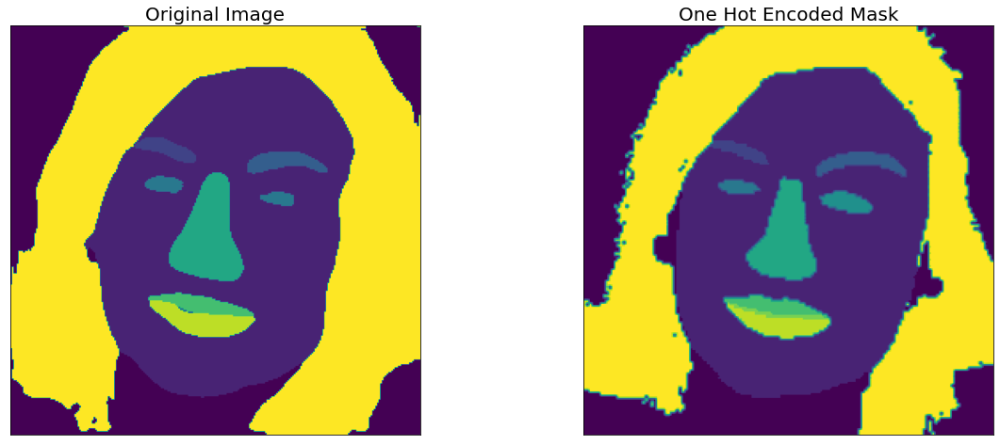

validation set


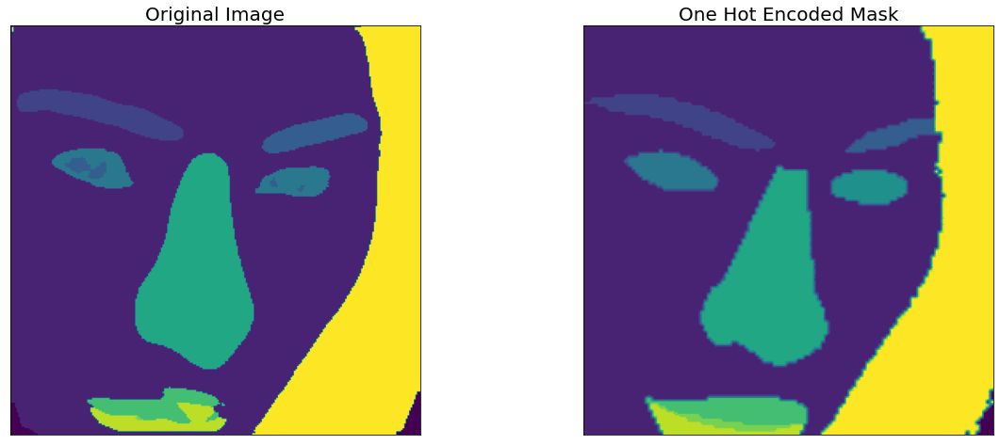

validation set


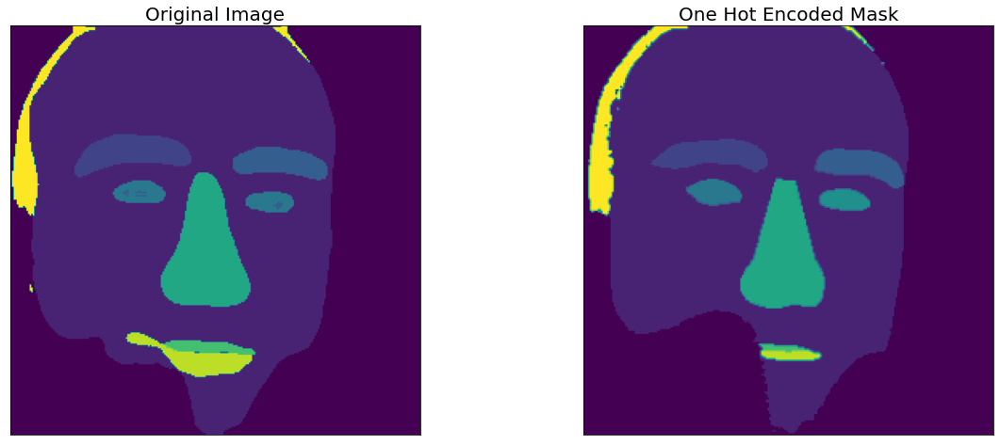

validation set


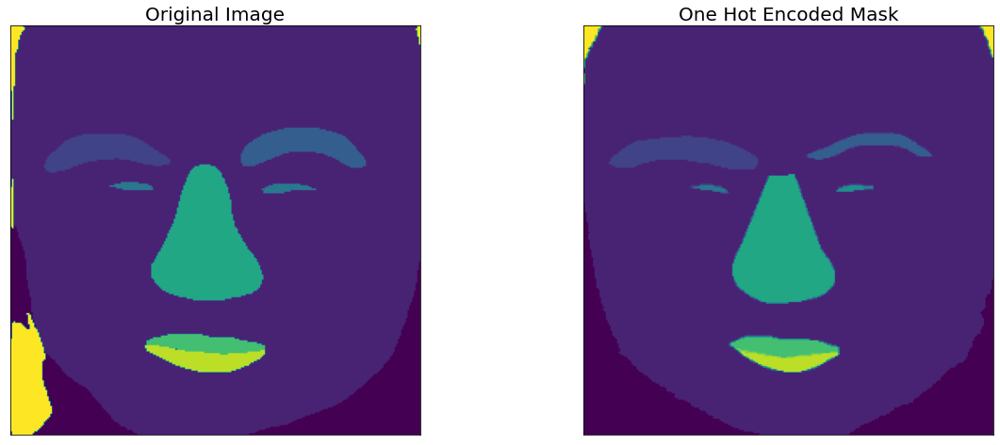

validation set


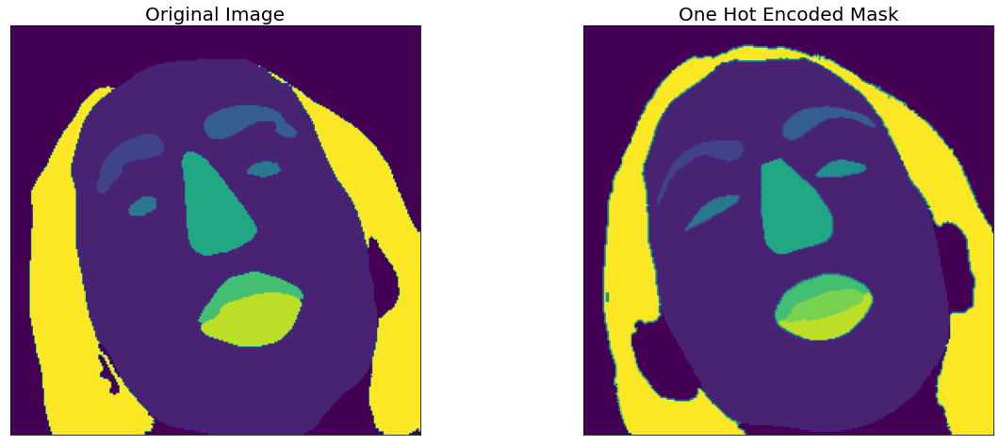

validation set


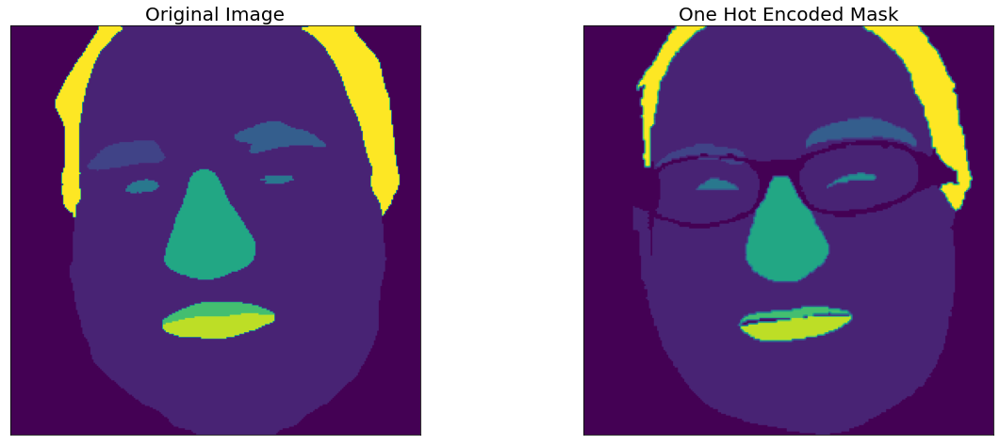

validation set


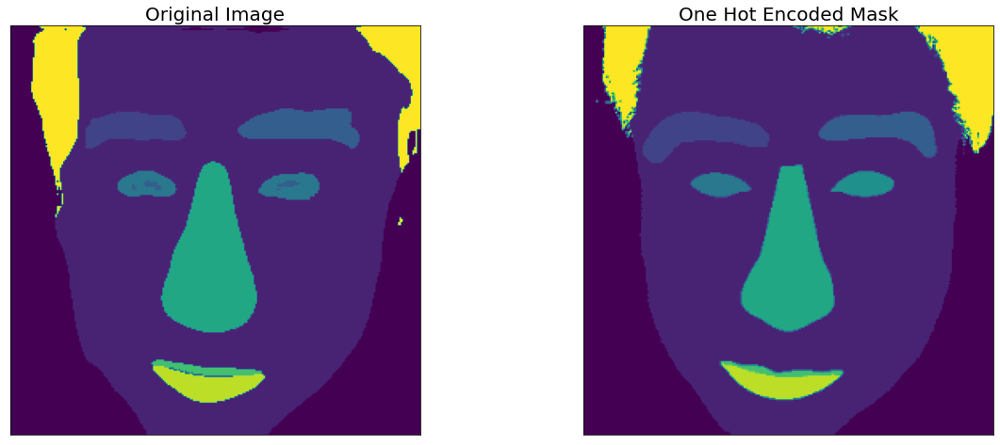

validation set


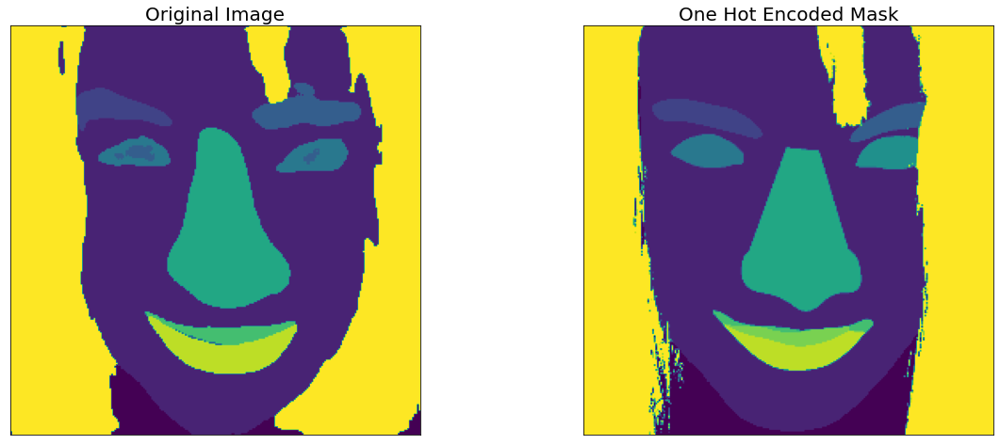

validation set


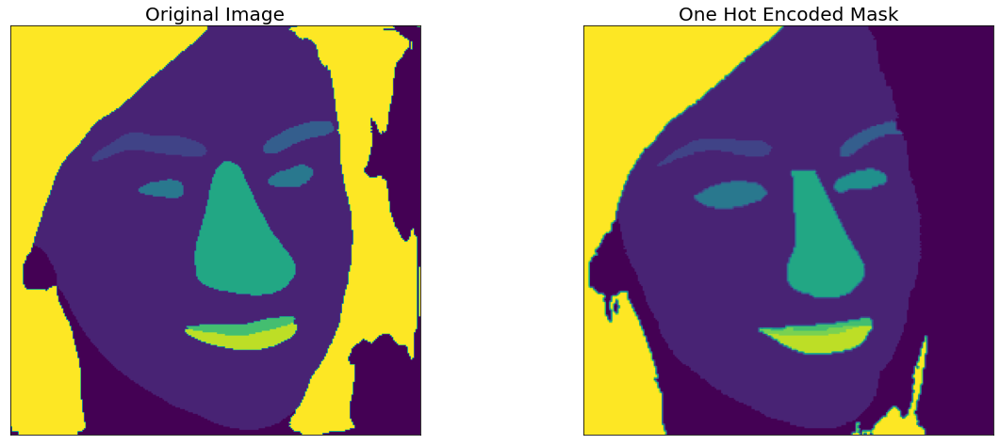

validation set


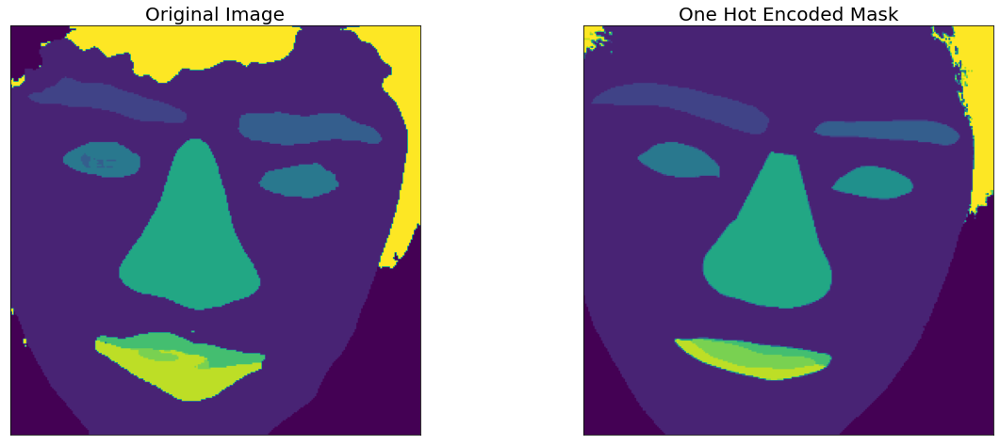

validation set


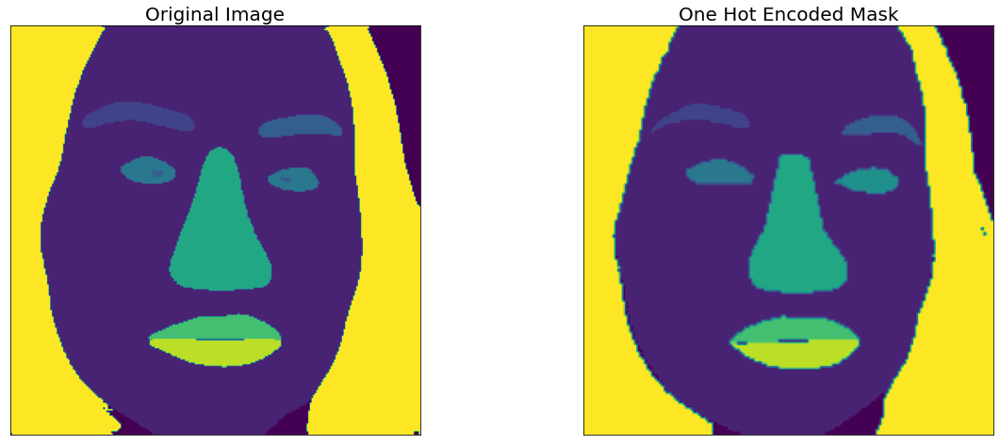

validation set


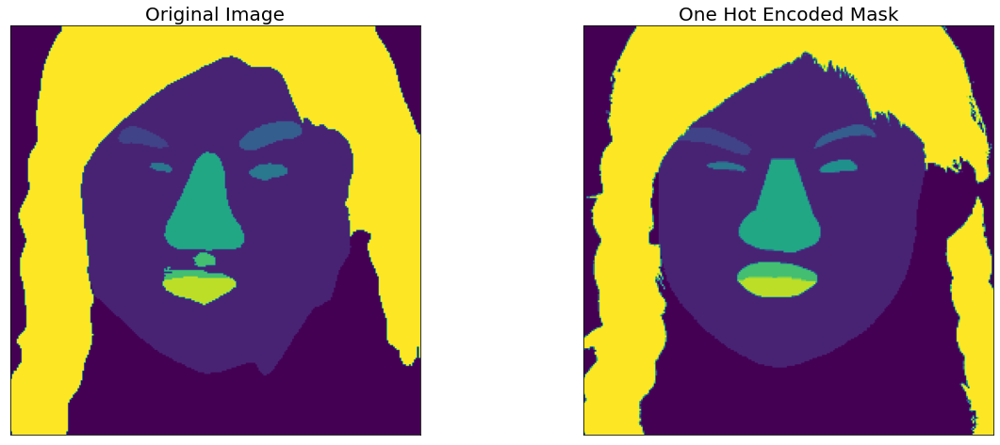

validation set


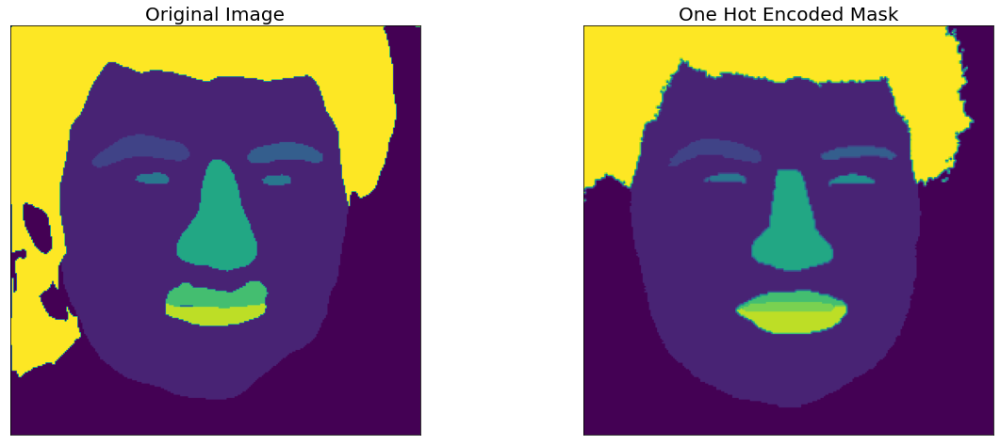

validation set


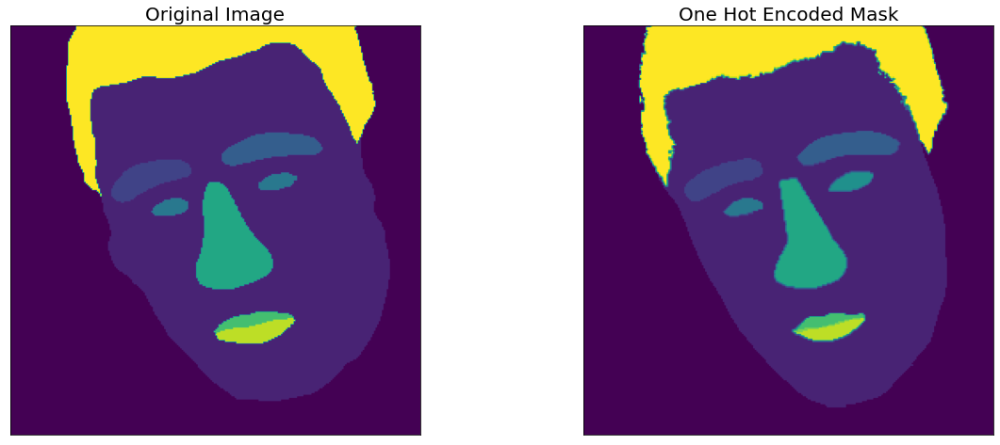

validation set


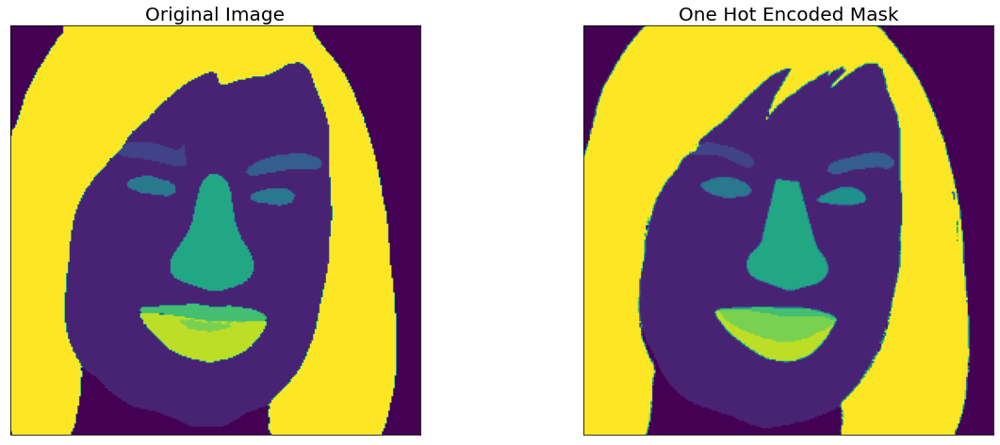

validation set


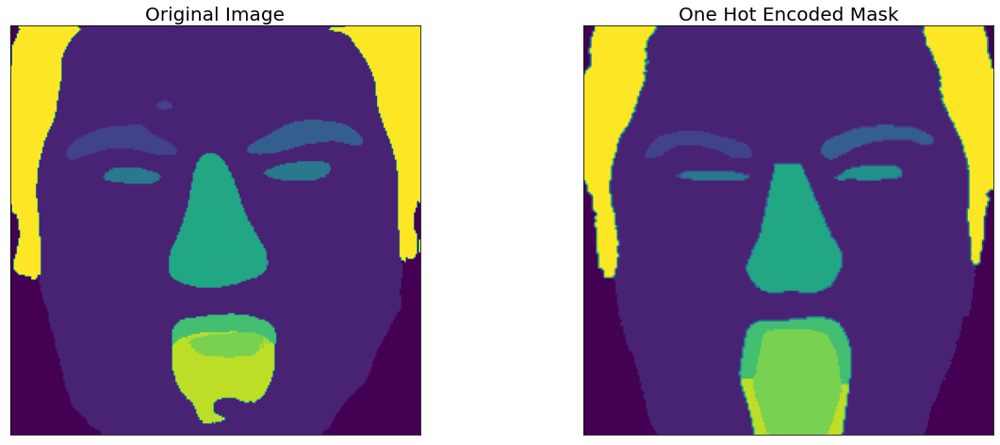

validation set


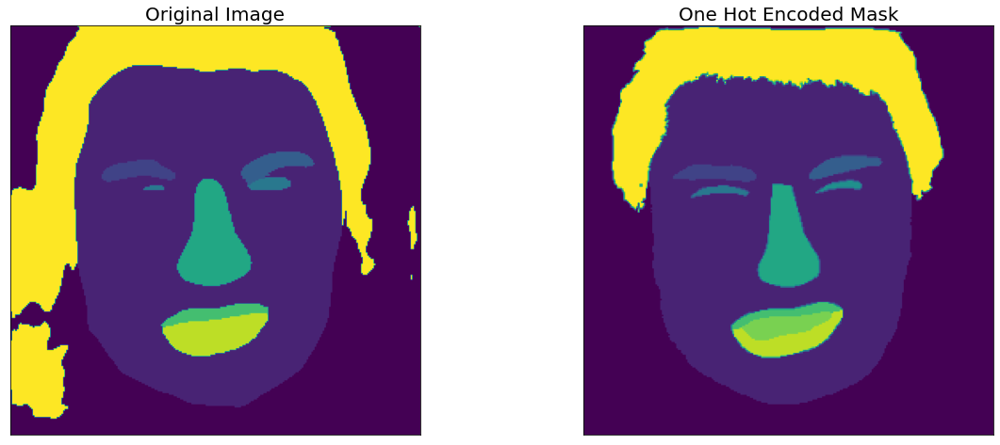

validation set


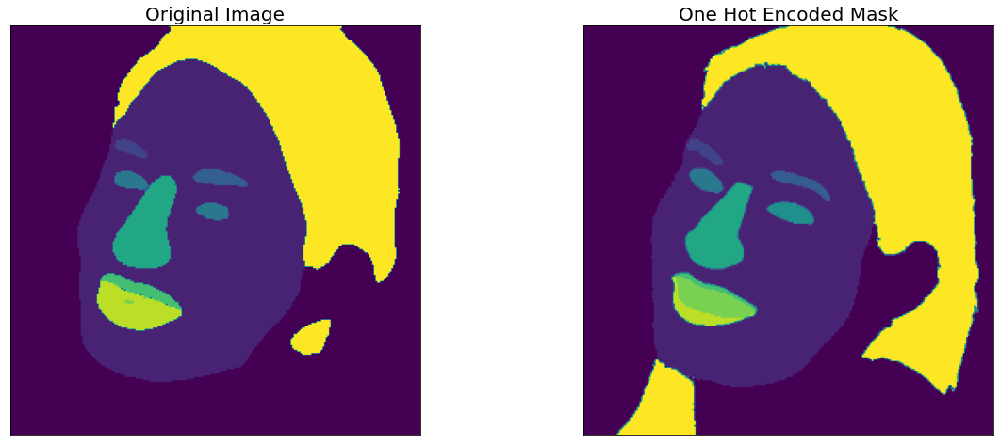

validation set


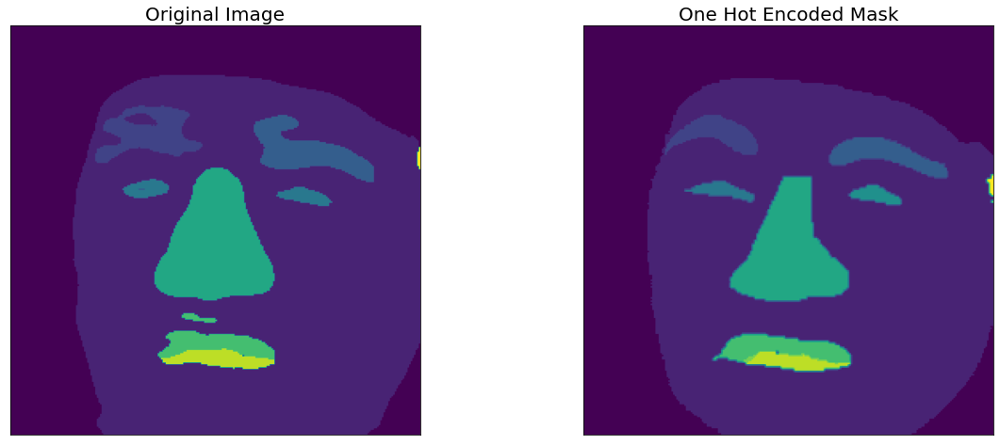

validation set


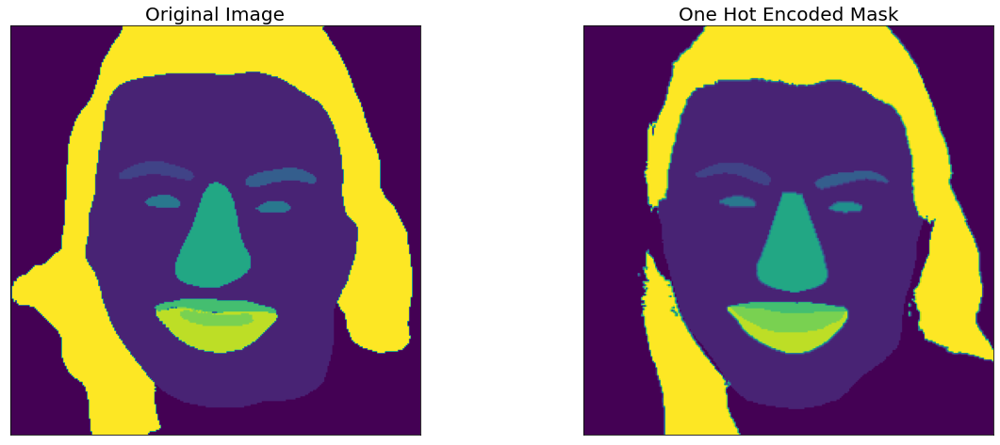

validation set


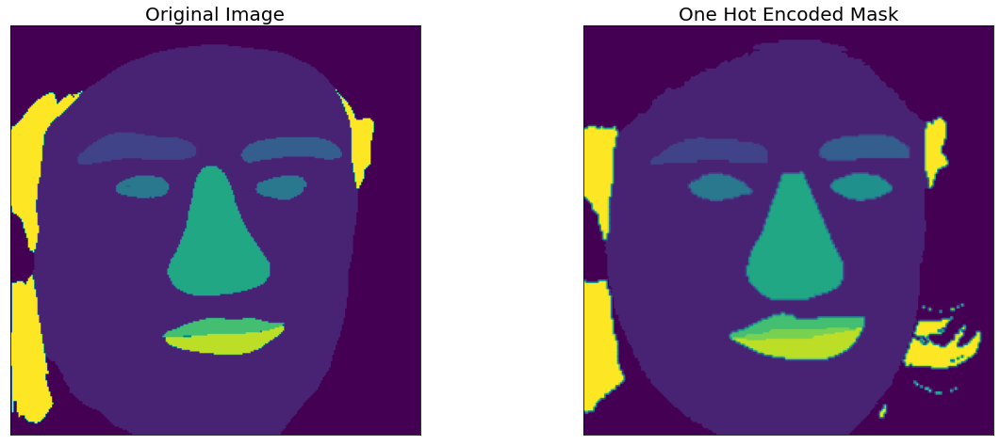

validation set


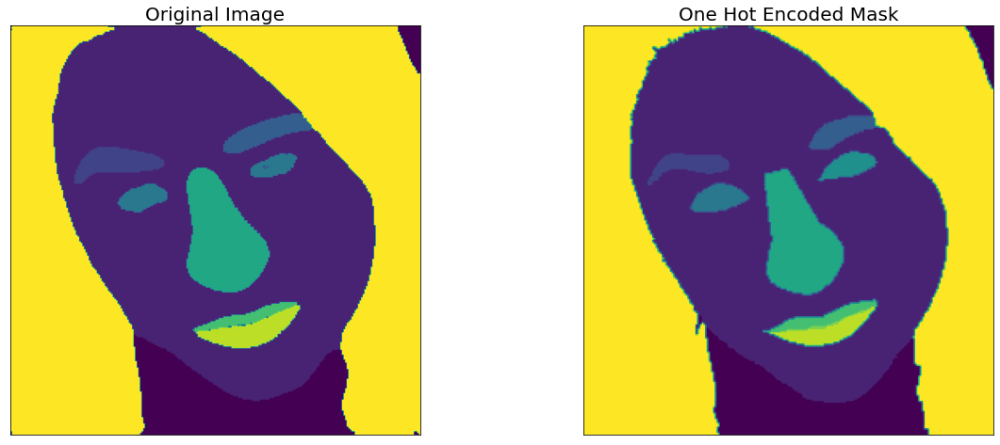

validation set


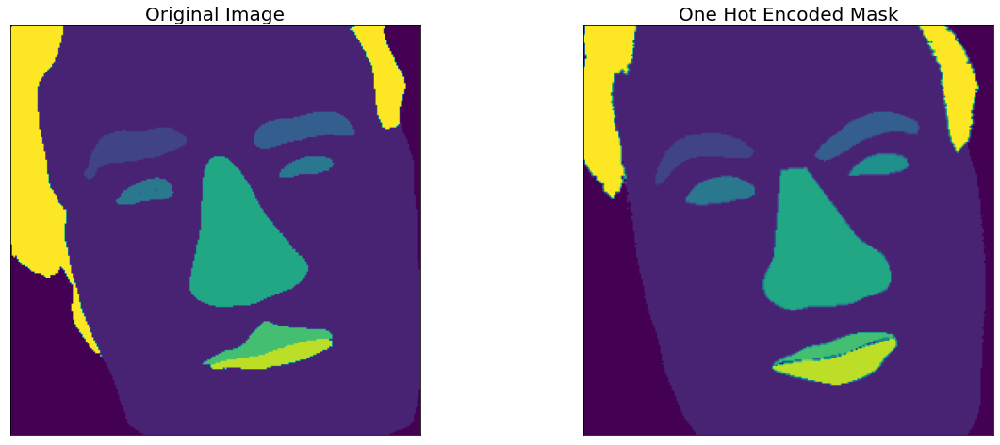

validation set


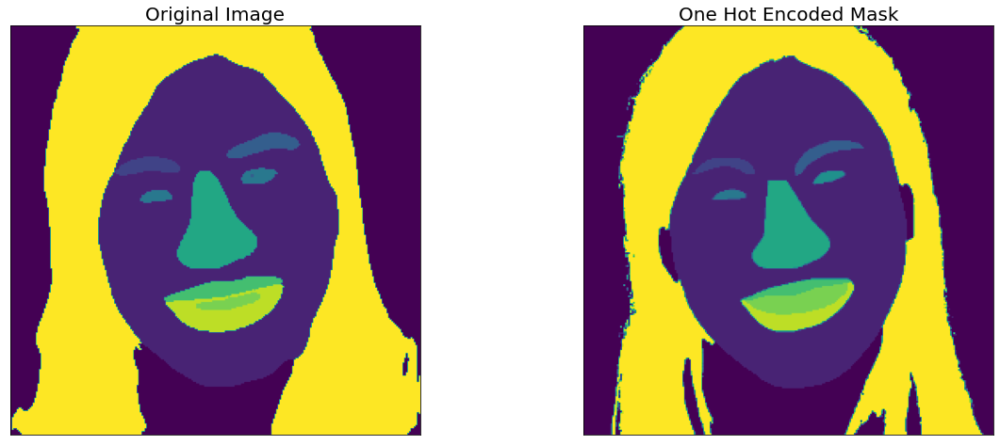

validation set


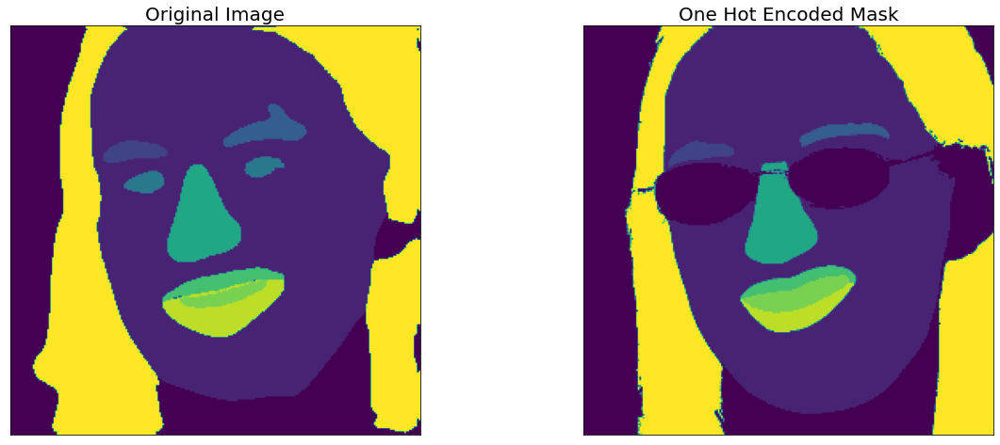

validation set


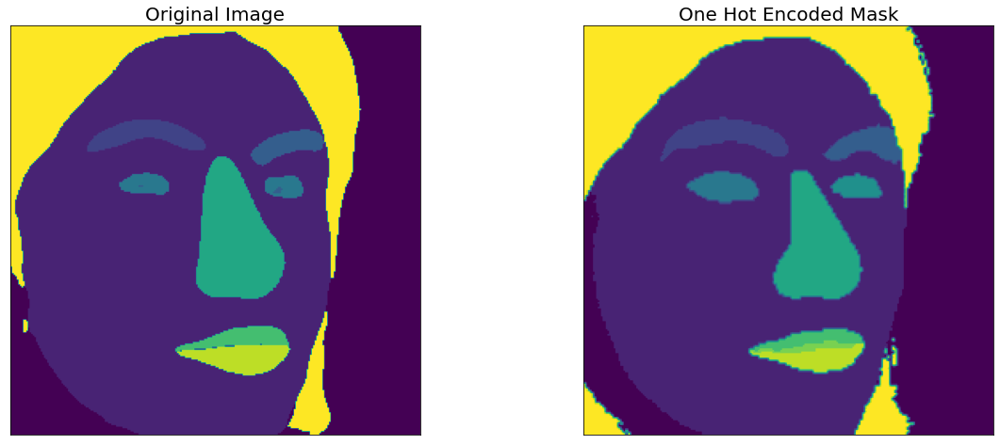

validation set


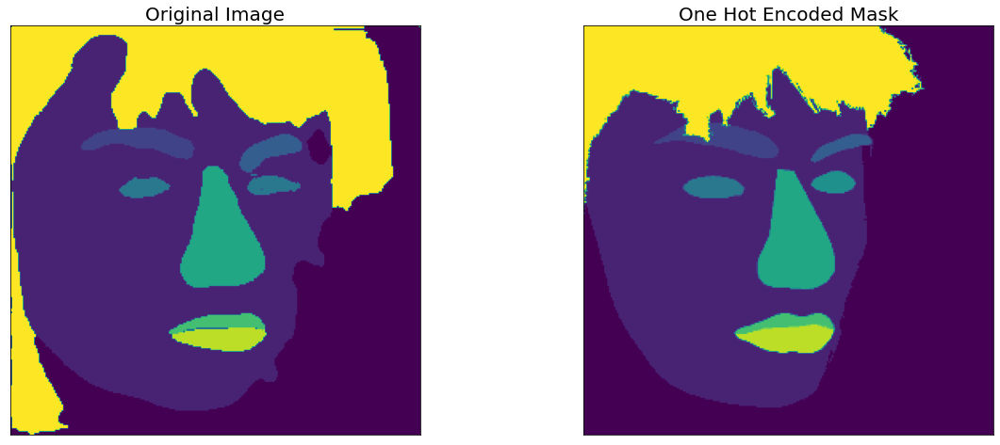

validation set


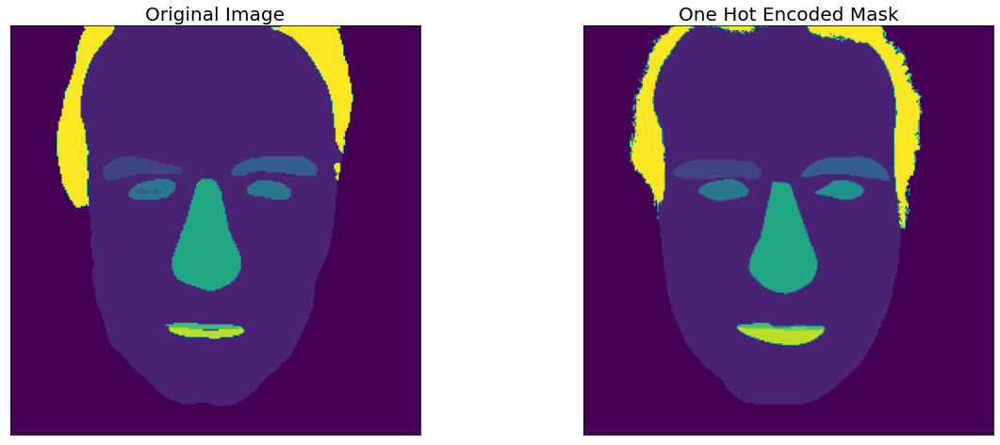

validation set


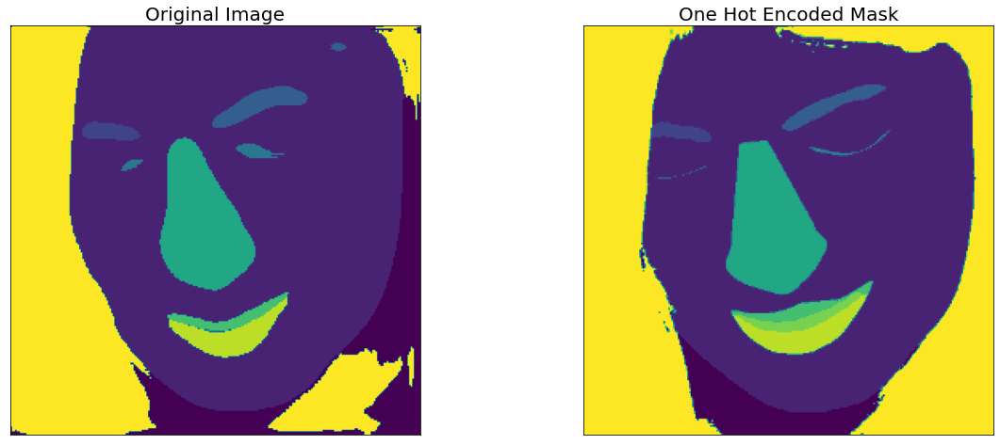

validation set


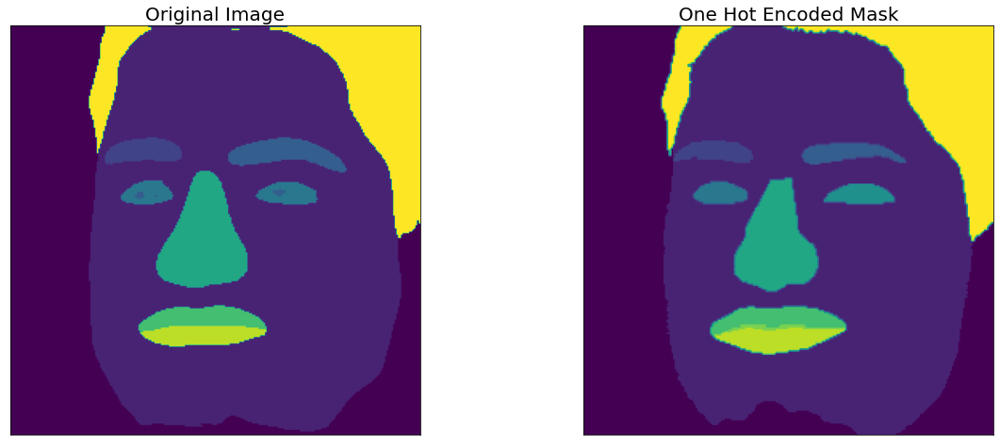

validation set


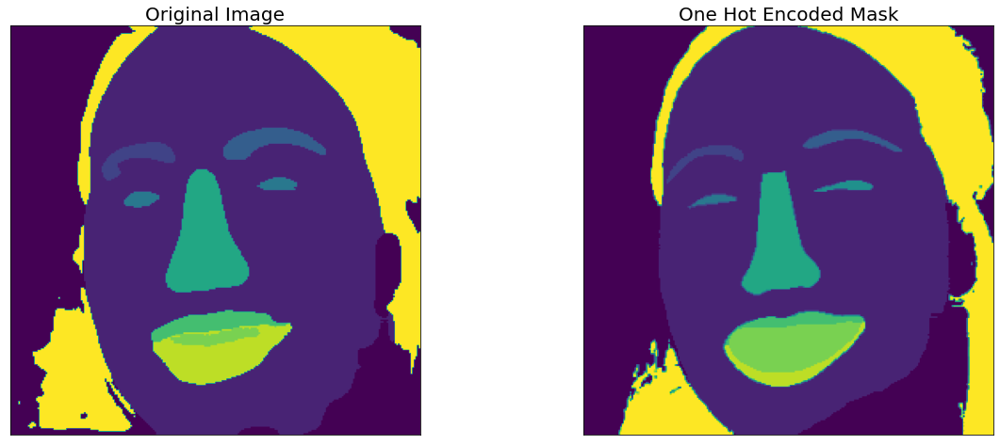

validation set


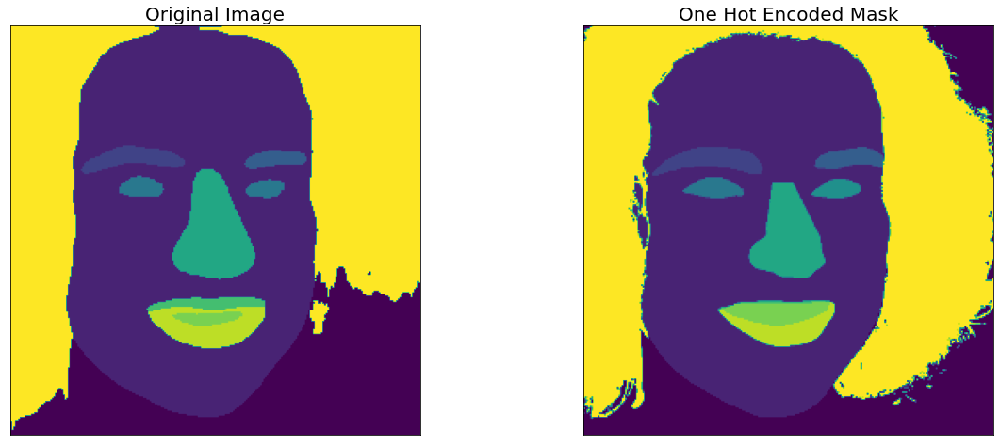

validation set


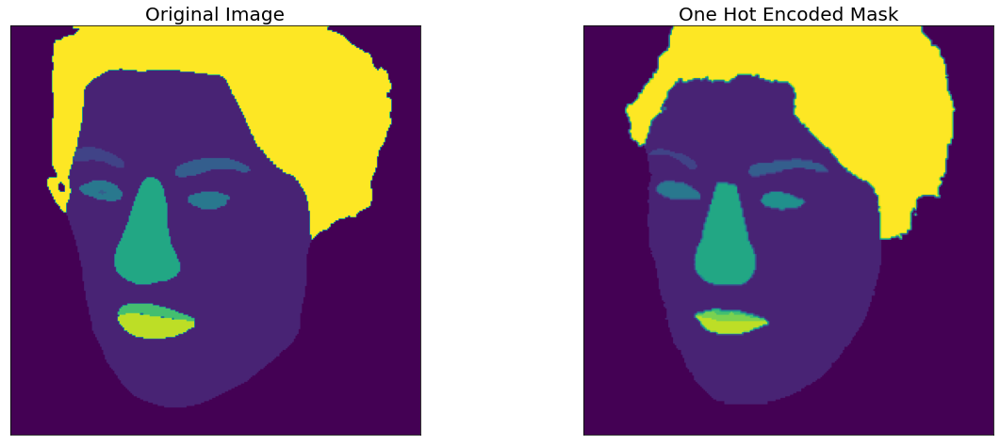

validation set


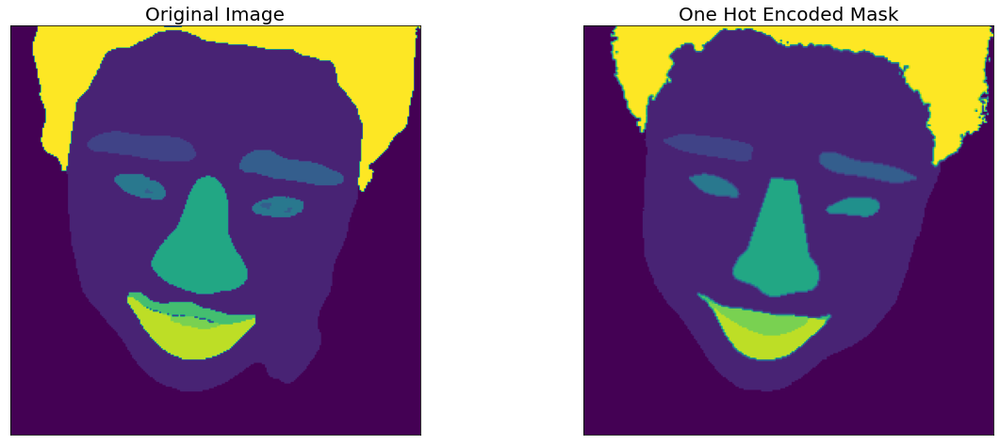

validation set


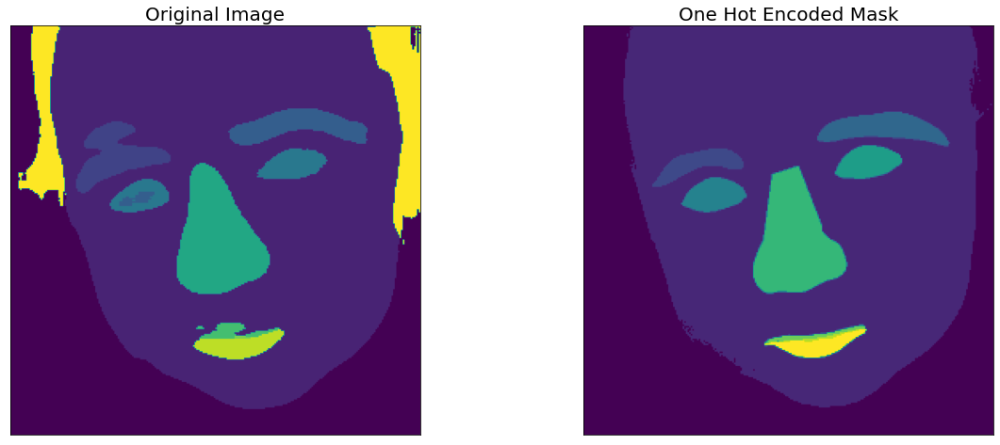

validation set


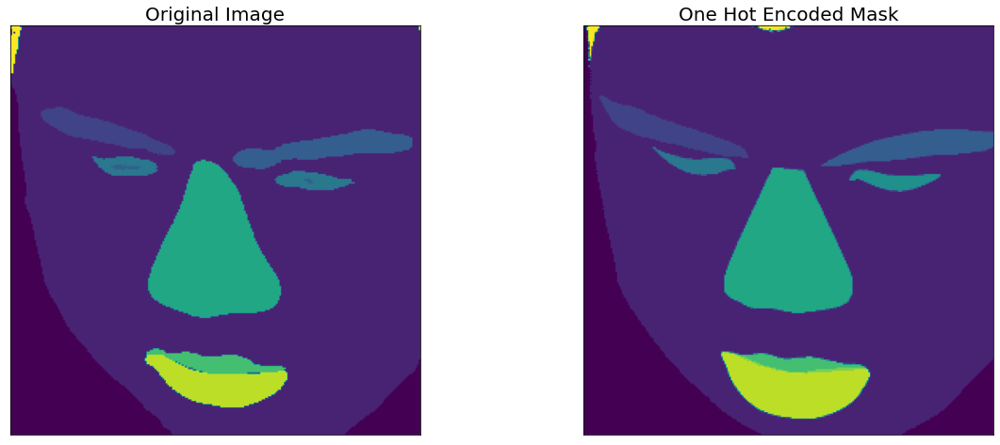

validation set


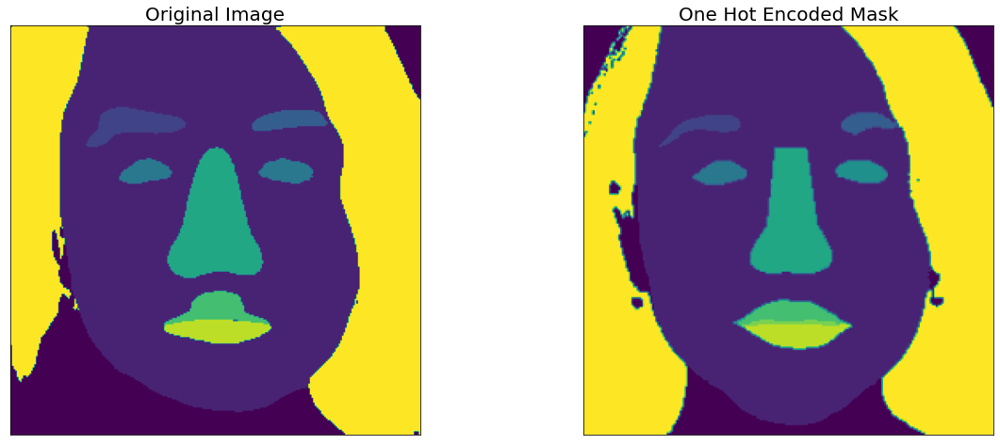

validation set


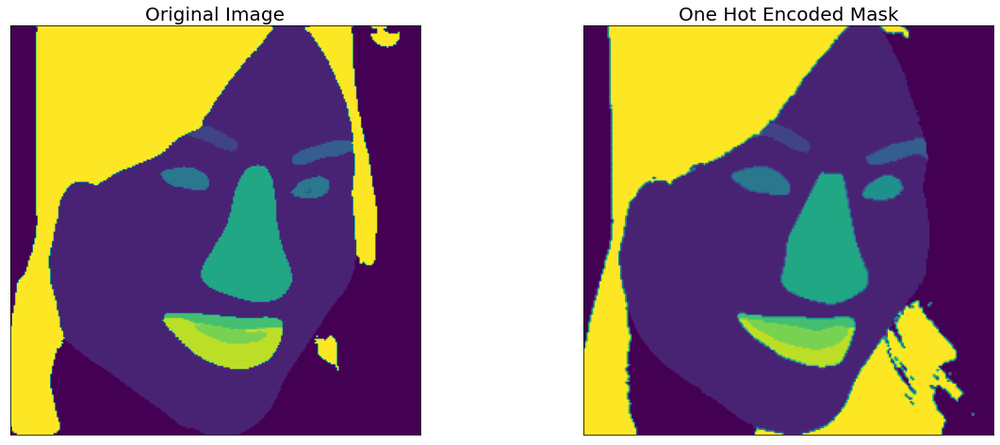

validation set


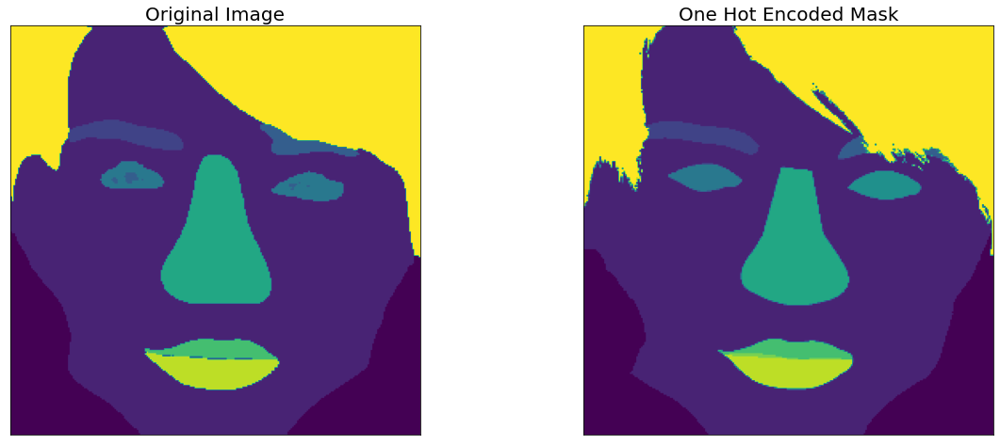

validation set


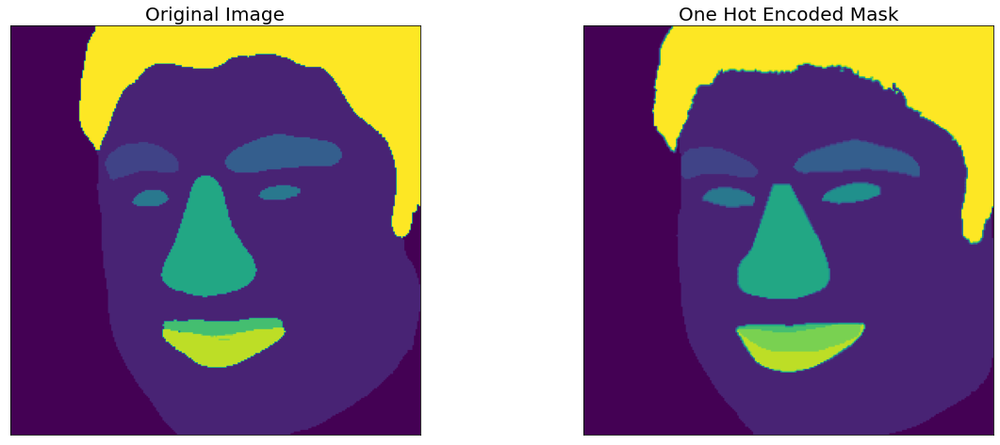

validation set


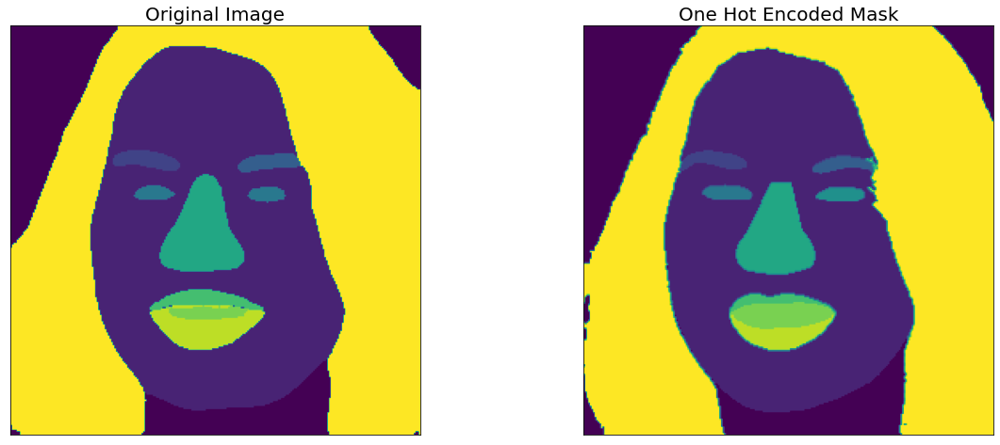

validation set


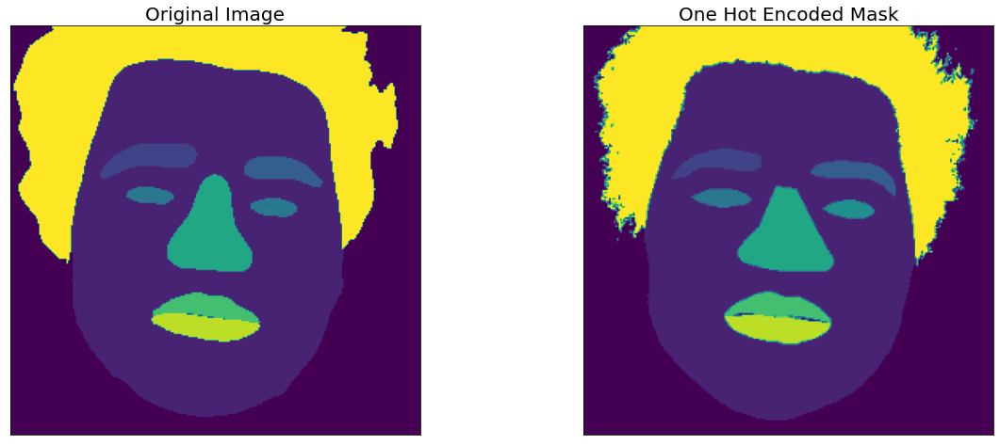

validation set


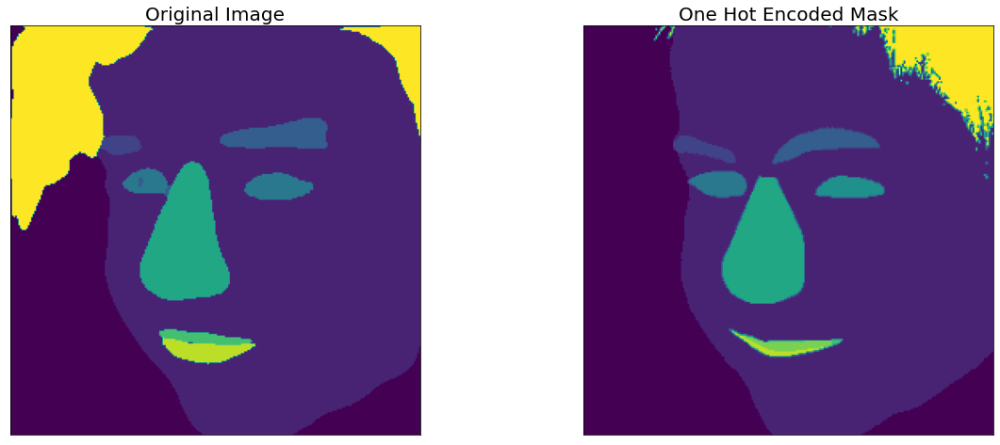

validation set


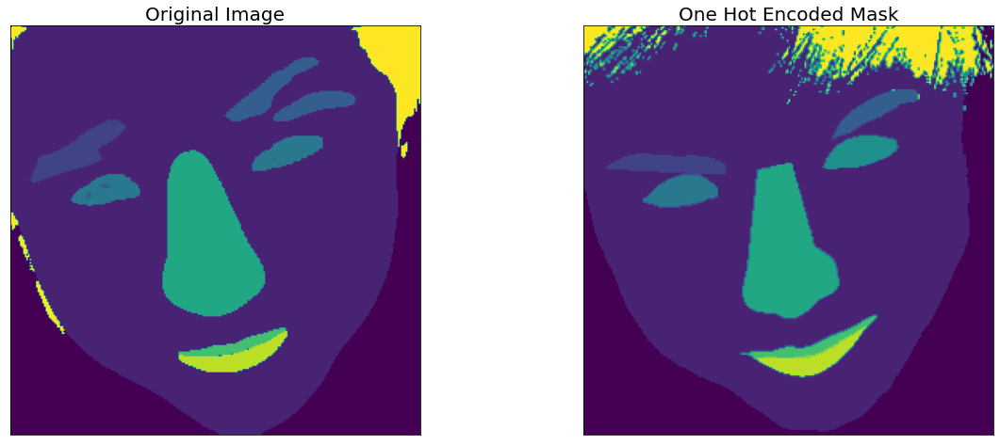

validation set


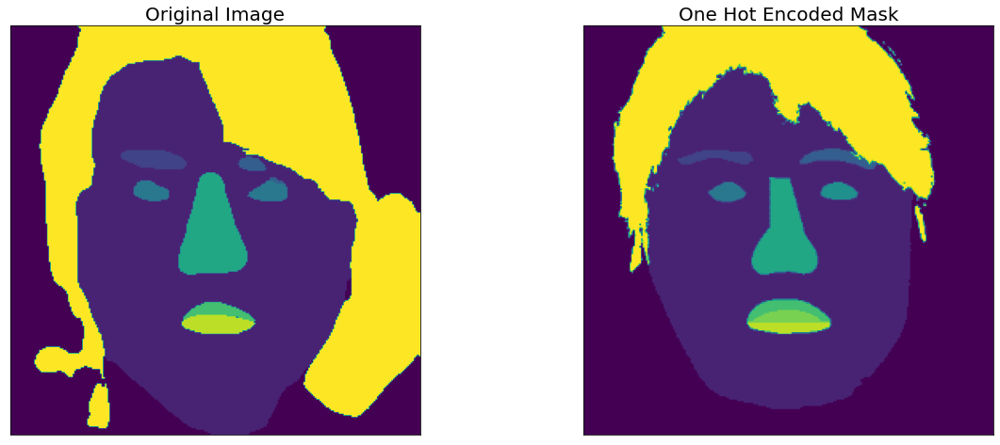

validation set


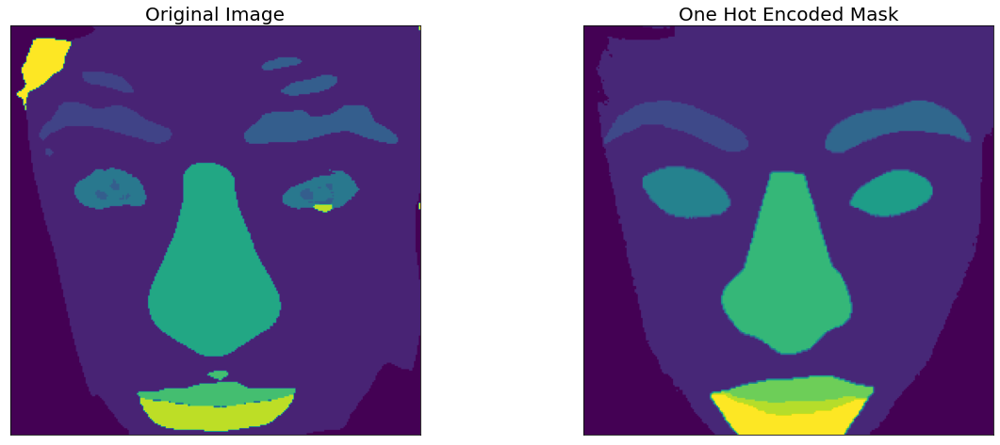

validation set


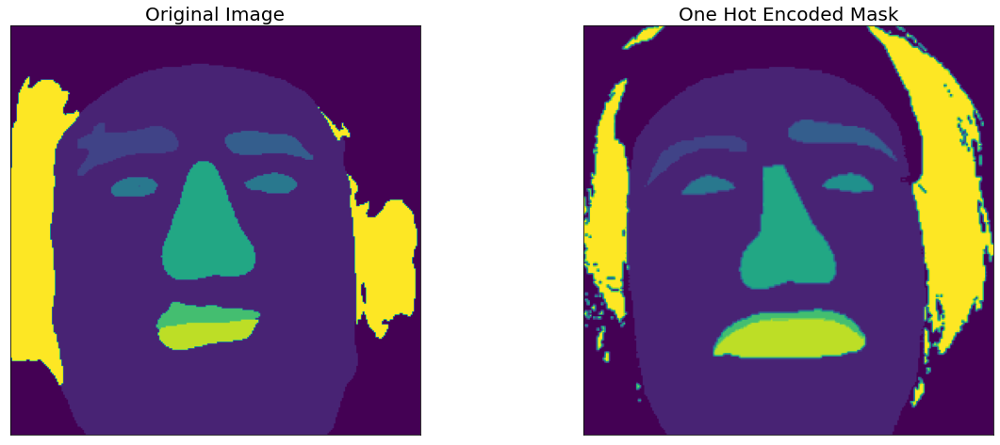

validation set


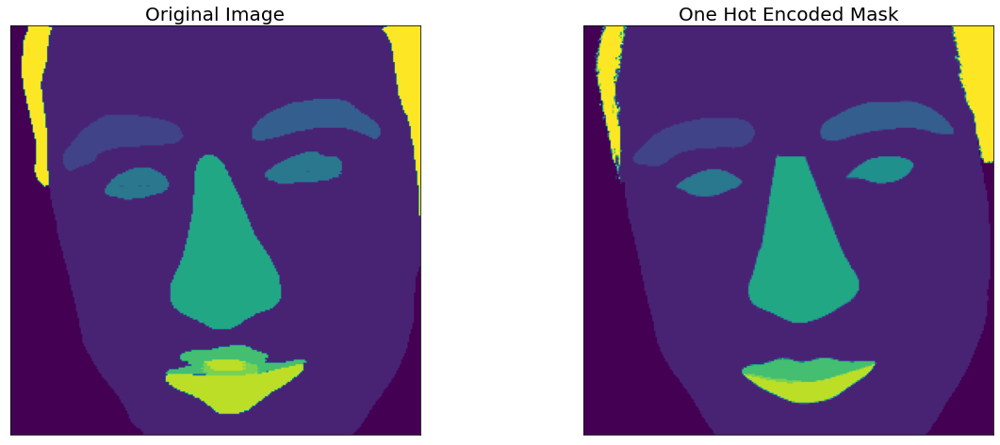

validation set


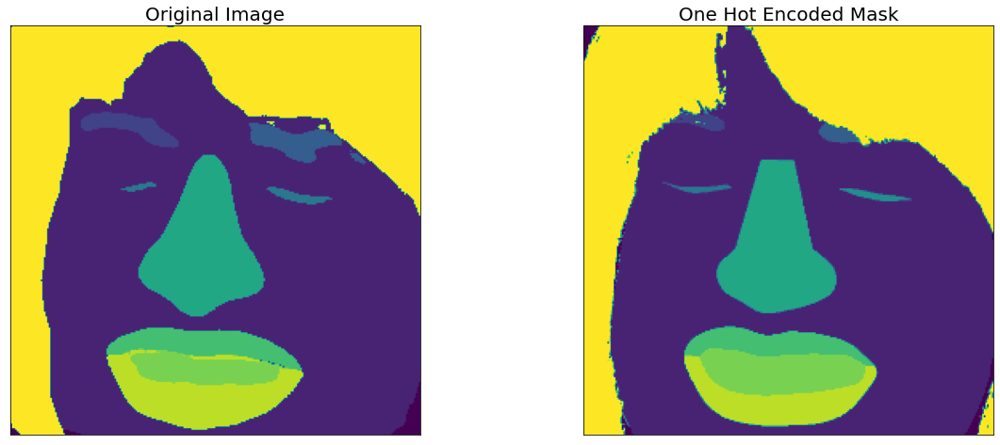

validation set


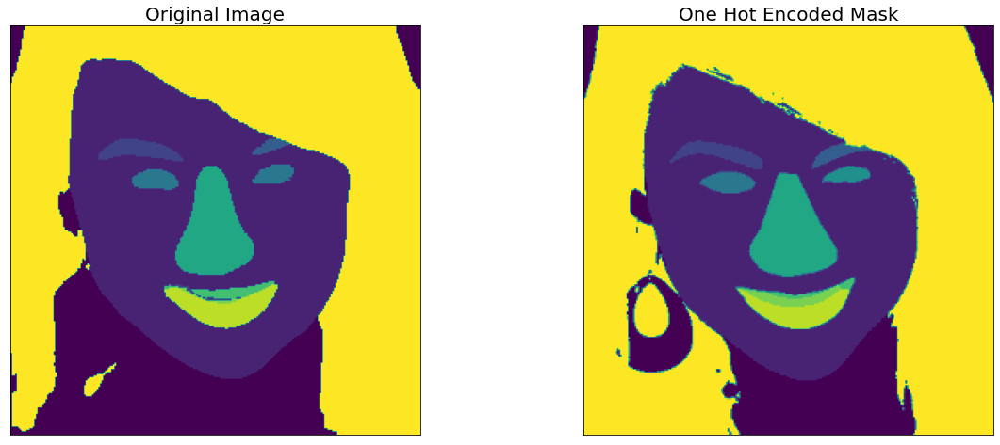

validation set


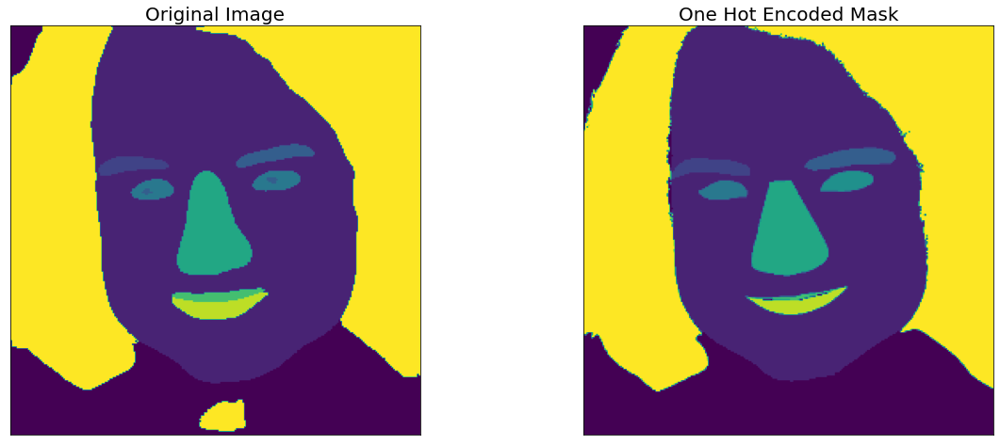

validation set


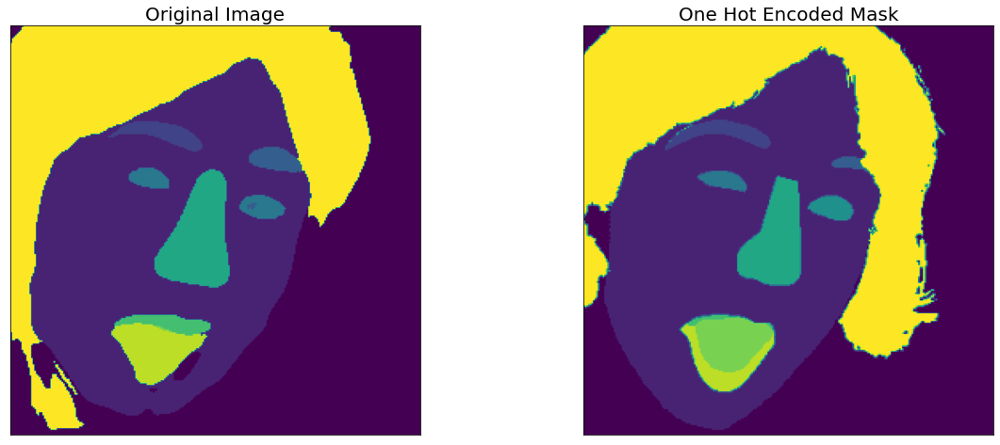

validation set


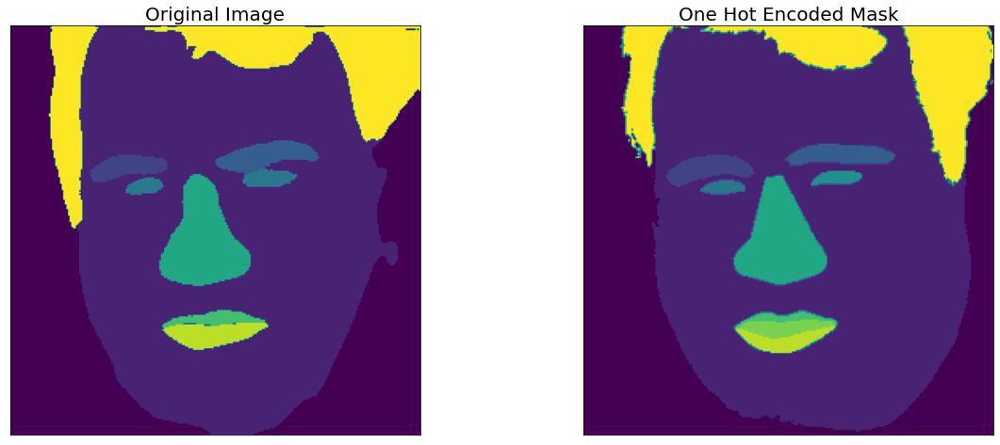

validation set


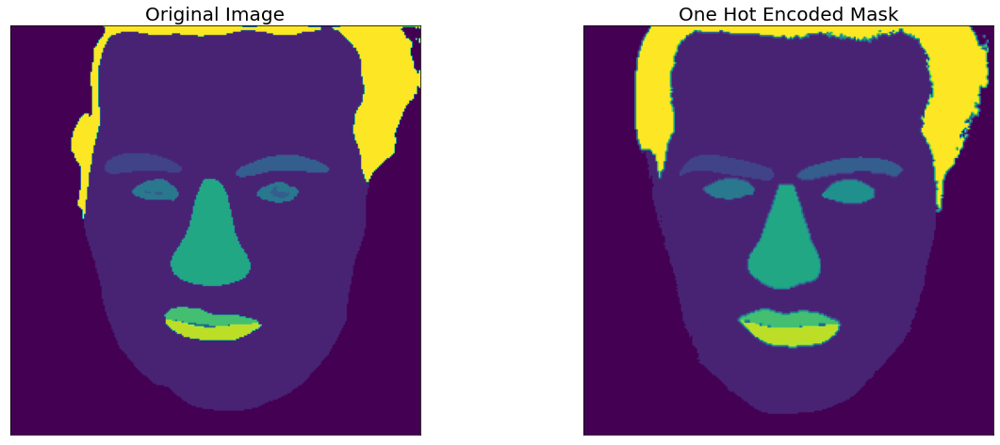

validation set


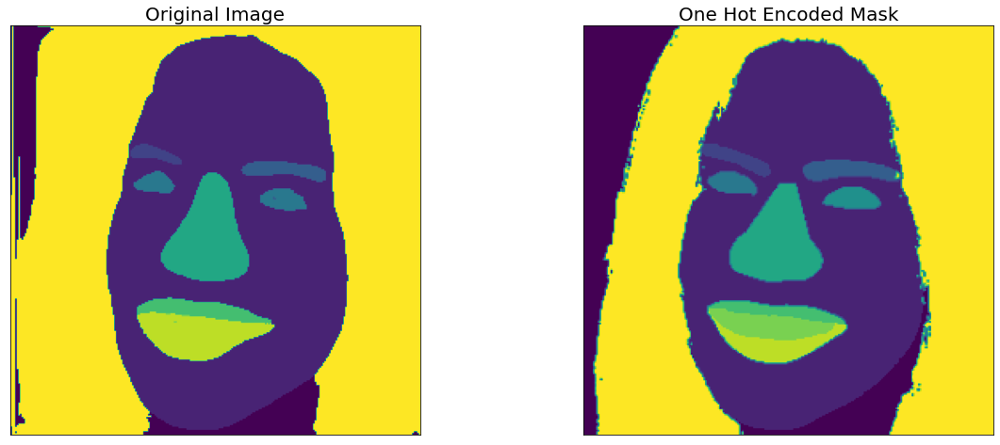

validation set


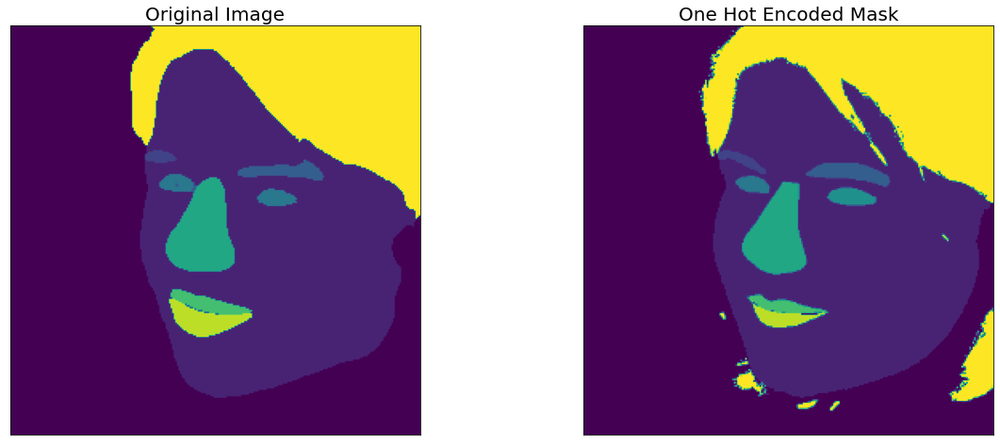

validation set


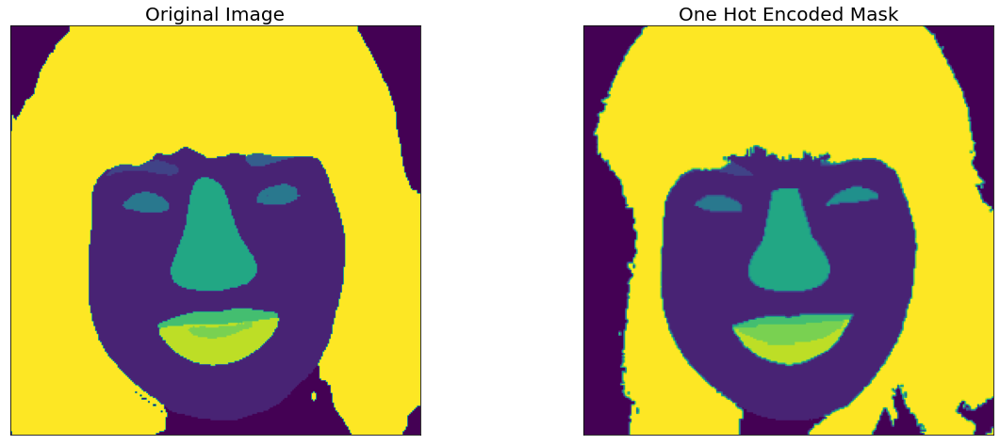

validation set


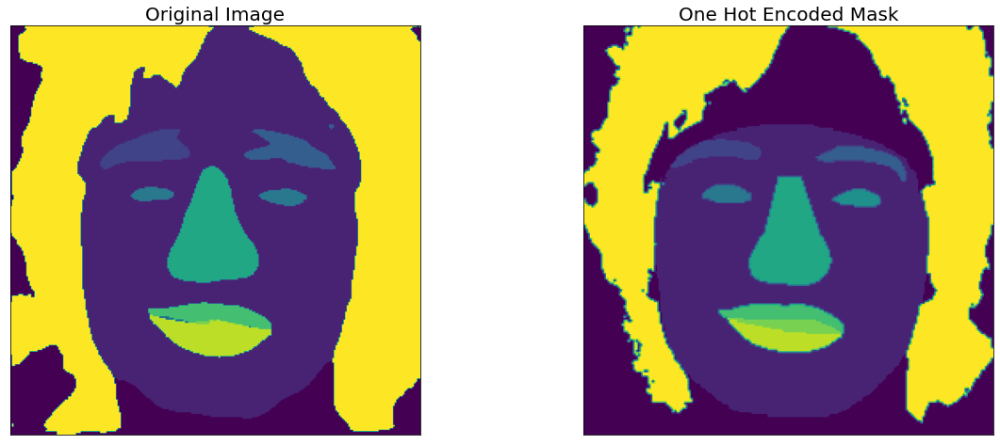

validation set


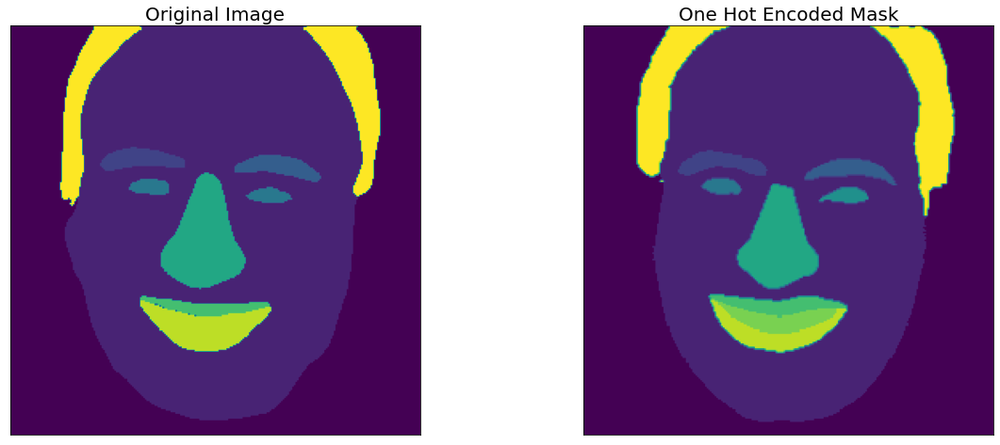

validation set


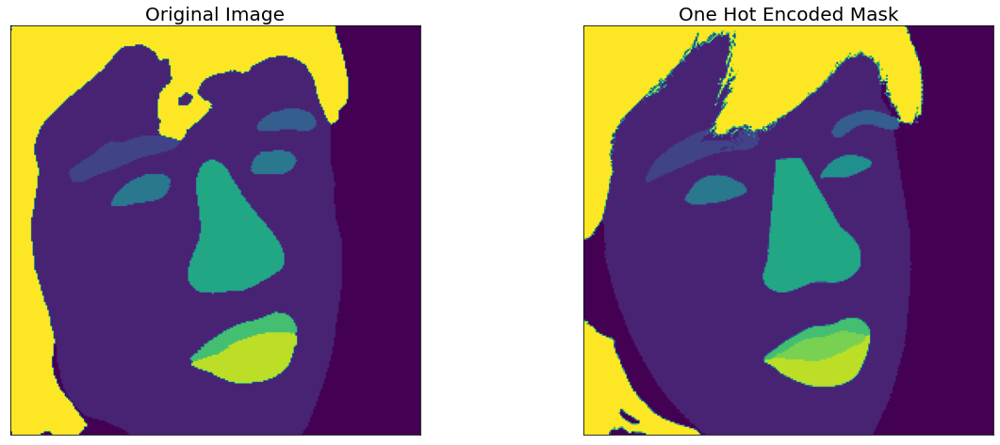

validation set


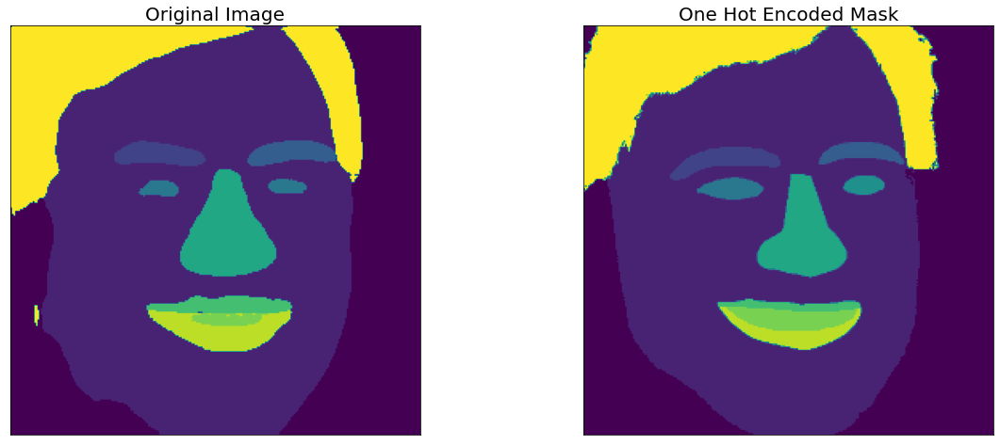

validation set


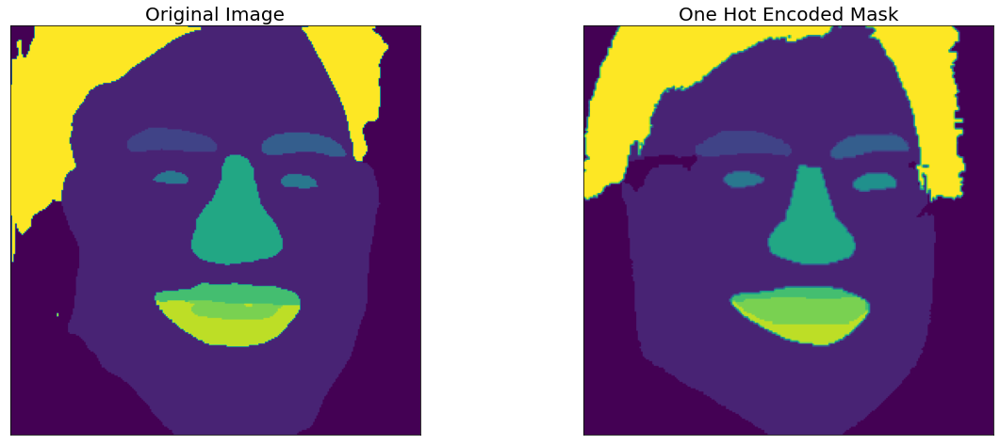

validation set


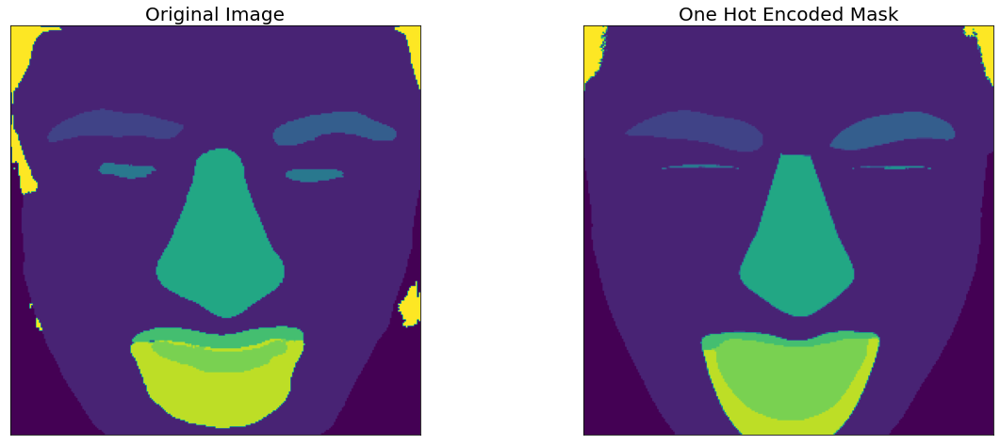

validation set


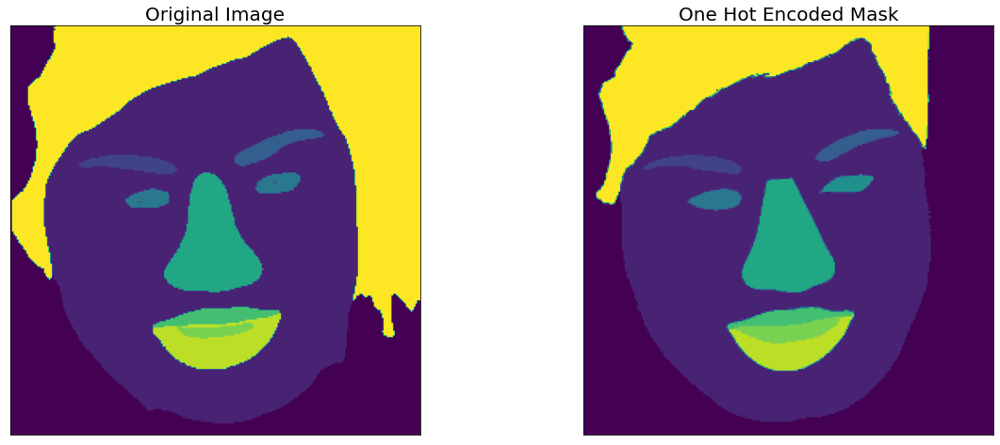

validation set


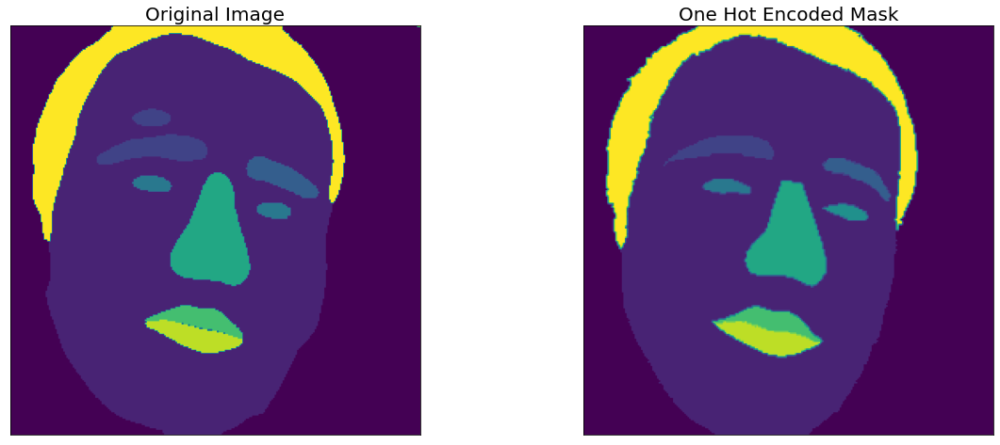

validation set


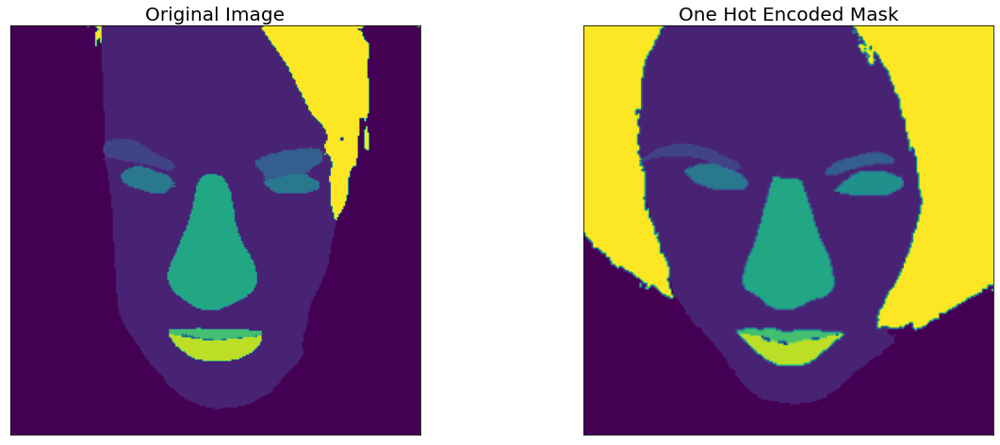

validation set


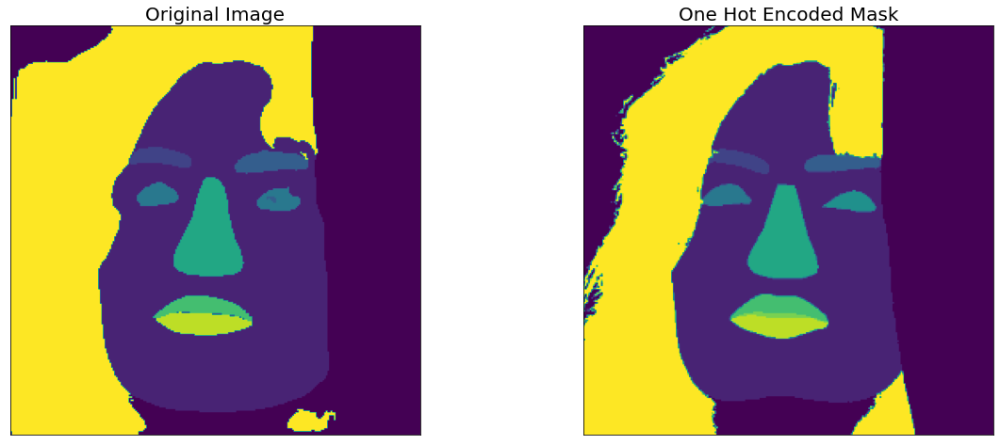

validation set


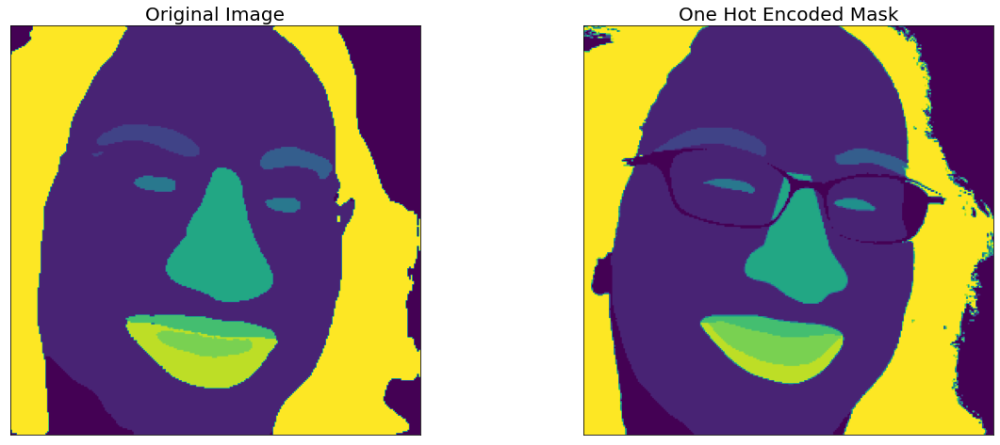

validation set


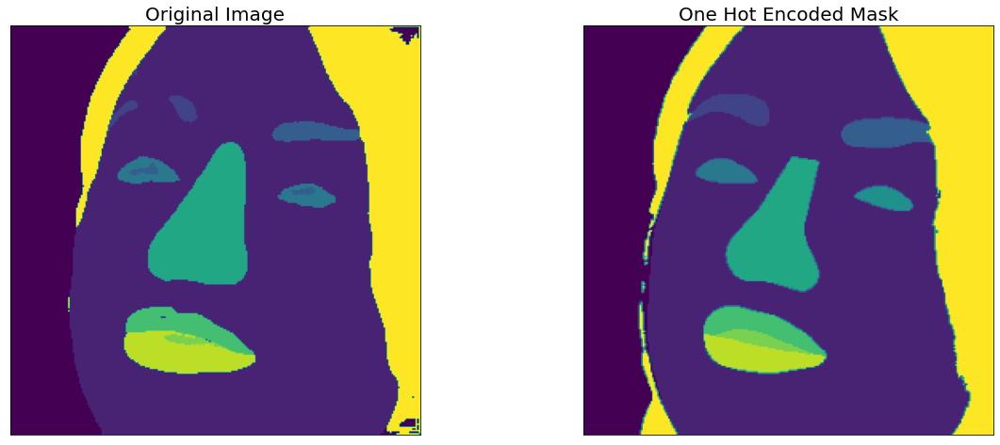

validation set


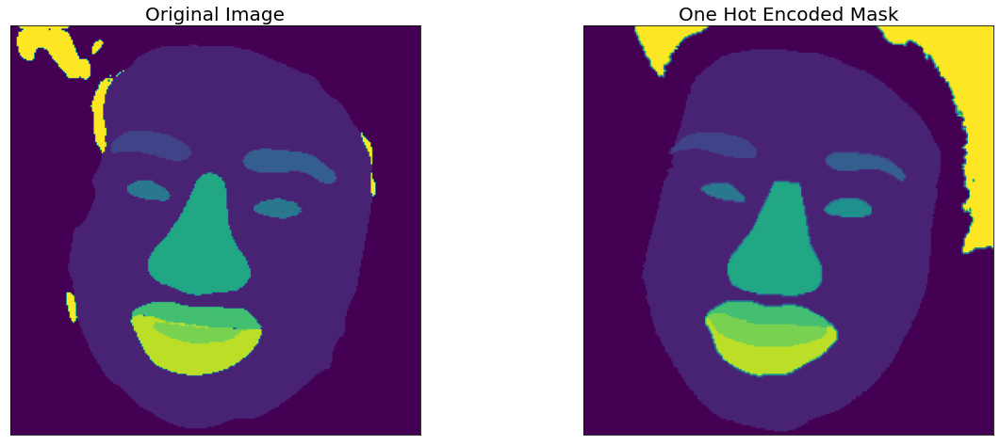

validation set


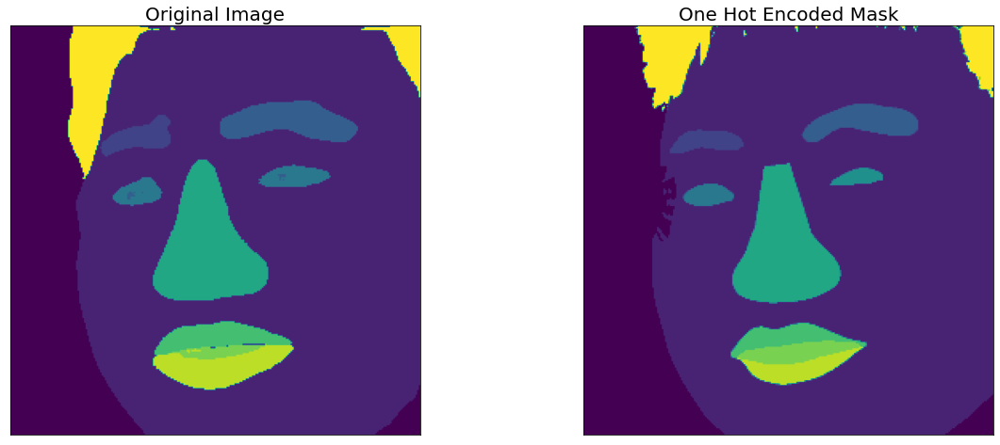

validation set


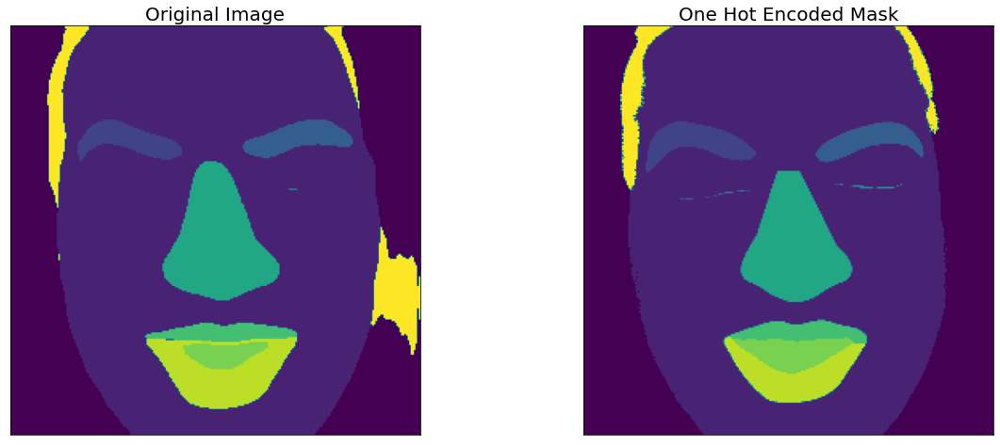

validation set


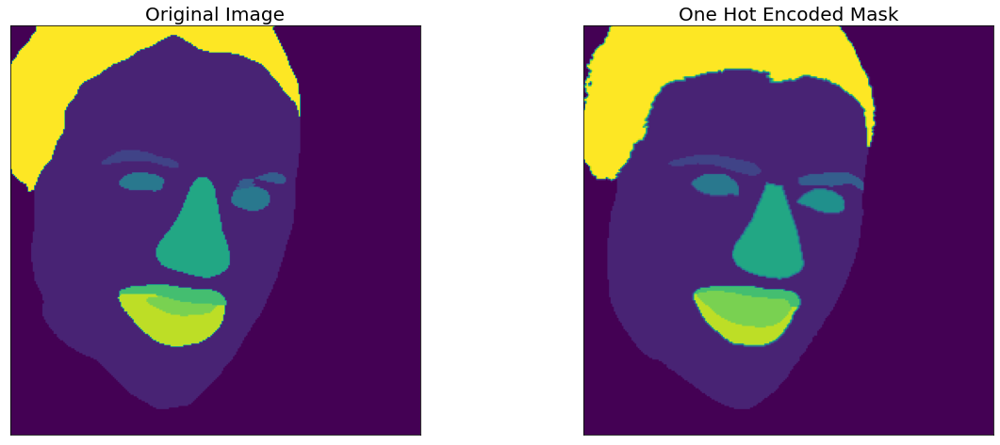

validation set


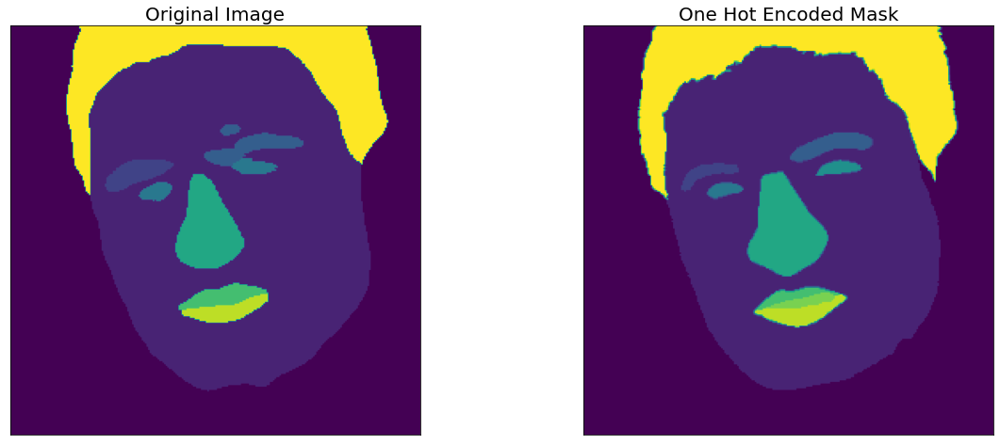

validation set


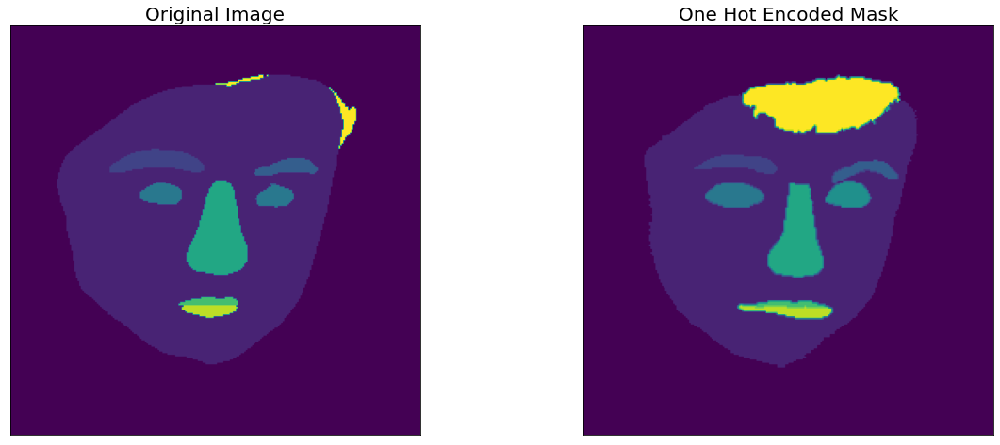

validation set


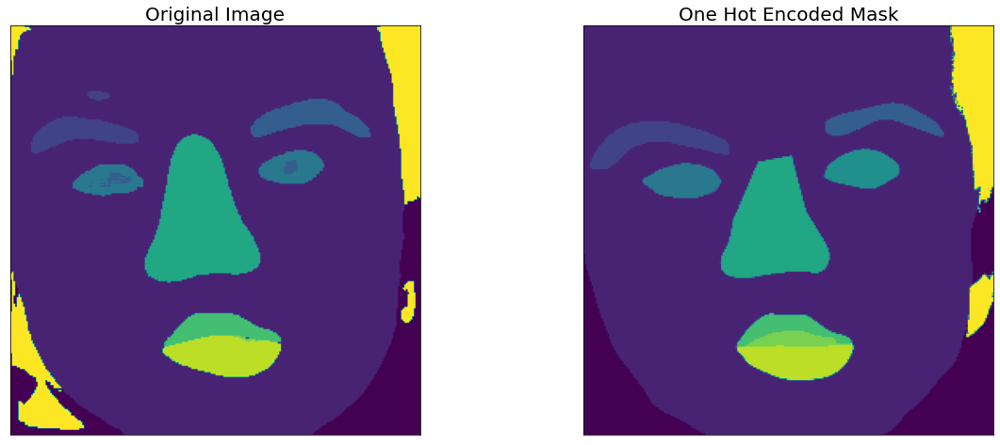

validation set


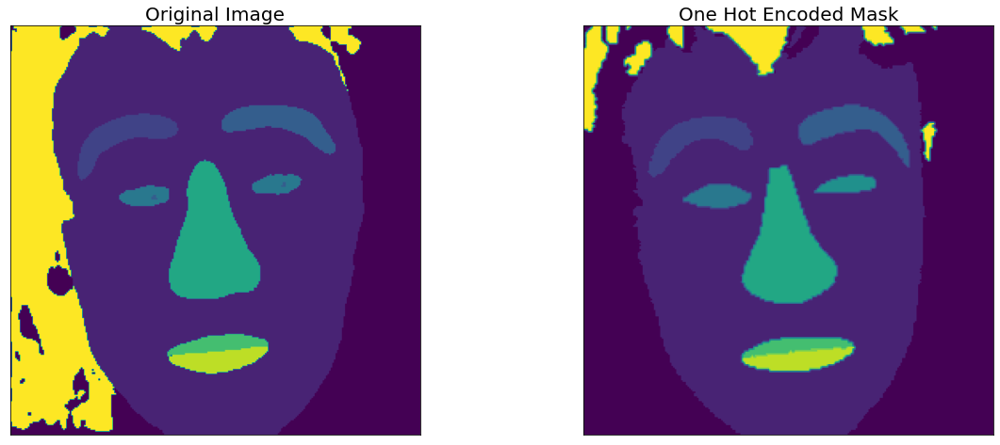

validation set


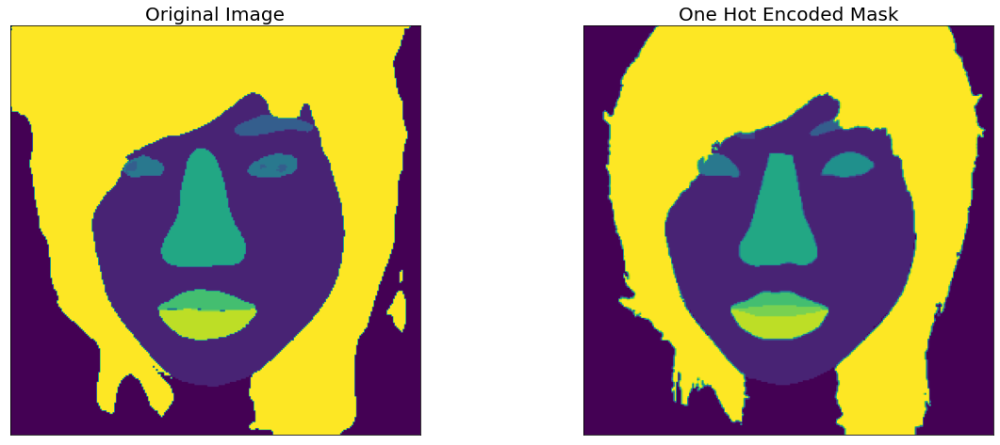

torch.Size([256, 256])

In [ ]:
for x in range(len(X[:100])):
  print("validation set")
  visualize(
      original_image = xs[x],
      #ground_truth_mask = colour_code_segmentation(reverse_one_hot(y_test[0]), rgb_vals),
      one_hot_encoded_mask = (ys[x])
  )

reverse_one_hot(Y[0]).shape

In [ ]:
X = torch.unsqueeze(torch.tensor(xs), 1)
Y = torch.nn.functional.one_hot(torch.tensor(np.array(ys)).to(torch.int64), 11).permute(0,3,1,2)
print(X.shape)
print(Y.shape)

torch.Size([90, 1, 256, 256])
torch.Size([90, 11, 256, 256])


In [ ]:
Y = Y.float()
X = X.float()
Y.dtype

torch.float32

In [ ]:
import matplotlib.pyplot as plt


# helper function for data visualization
def visualize(**images):
    """
    Plot images in one row
    """
    n_images = len(images)
    plt.figure(figsize=(20,8))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_images, idx + 1)
        plt.xticks([]); 
        plt.yticks([])
        # get title from the parameter names
        plt.title(name.replace('_',' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

def reverse_one_hot(image):
    """
    Transform a 2D array in one-hot format (depth is num_classes),
    to a 2D array with only 1 channel, where each pixel value is
    the classified class key.
    # Arguments
        image: The one-hot format image 
        
    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of 1, where each pixel value is the classified 
        class key.
    """
    #argmax returns the indices of the maximum values along an axis. 
    x = np.argmax(image, axis = -3)
    return x

# Perform colour coding on the reverse-one-hot outputs
def colour_code_segmentation(image, label_values):
    """
    Given a 1-channel array of class keys, colour code the segmentation results.
    # Arguments
        image: single channel array where each value represents the class key.
        label_values

    # Returns
        Colour coded image for segmentation visualization
    """
    colour_codes = np.array(label_values)
    x = colour_codes[image.numpy().astype(int)]

    return x

In [ ]:
import torchvision.transforms as T
import torchvision.transforms.functional as F
import random

class MyDataSet(torch.utils.data.Dataset):
  def __init__(self, x, y):
    super(MyDataSet, self).__init__()
    
    # store the augmented tensors tensors
    self._x, self._y = x,y

  def __len__(self):
    # a DataSet must know it size
    return self._x.shape[0]

  def __getitem__(self, index):
    x = self._x[index, :]
    y = self._y[index, :]
    # print("GETTING ITEM")
    return x, y

train_ds = MyDataSet(X, Y)


### Load and view model predictions

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9099, 0.9097, 0.5950, 0.6801, 0.6482, 0.6627, 0.9129, 0.7890, 0.0571,
        0.8174, 0.8841])
tensor([0.9099, 0.9097, 0.5950, 0.6801, 0.6482, 0.6627, 0.9129, 0.7890,    nan,
        0.8174, 0.8841])
torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9251, 0.9234, 0.6507, 0.7090, 0.3744, 0.1701, 0.9322, 0.2596, 0.5478,
        0.7937, 0.7924])
tensor([0.9251, 0.9234, 0.6507, 0.7090, 0.3744, 0.1701, 0.9322, 0.2596, 0.5478,
        0.7937, 0.7924])


<ipython-input-24-fd270ad57355>:39: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  gt_mask = colour_code_segmentation(reverse_one_hot(torch.tensor(gt_mask)), rgb_vals)


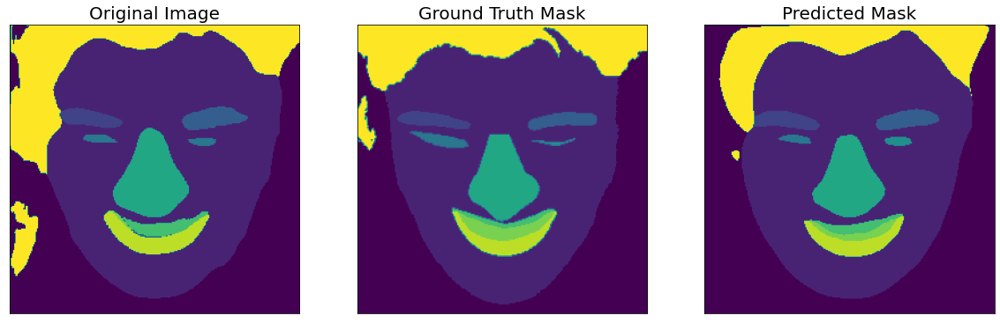

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9717, 0.9639, 0.7580, 0.8260, 0.7541, 0.7822, 0.8765, 0.7840, 0.2957,
        0.7787, 0.9409])
tensor([0.9717, 0.9639, 0.7580, 0.8260, 0.7541, 0.7822, 0.8765, 0.7840, 0.2957,
        0.7787, 0.9409])


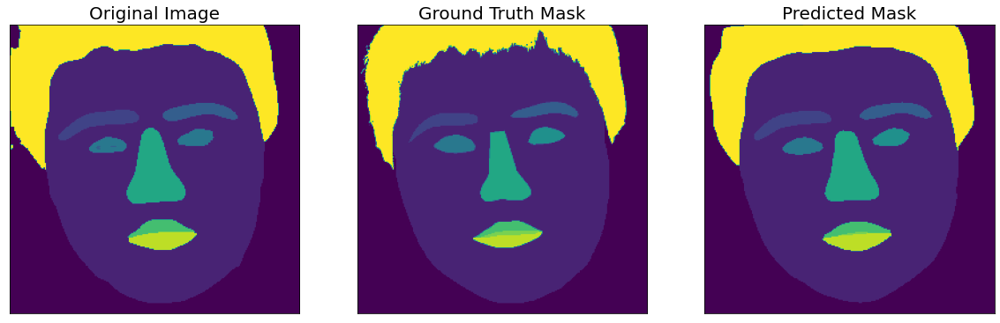

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.0052, 0.9134, 0.6486, 0.7057, 0.8483, 0.8437, 0.9395, 0.7802, 0.0000,
        0.7314, 0.1450])
tensor([   nan, 0.9134, 0.6486, 0.7057, 0.8483, 0.8437, 0.9395, 0.7802,    nan,
        0.7314, 0.1450])


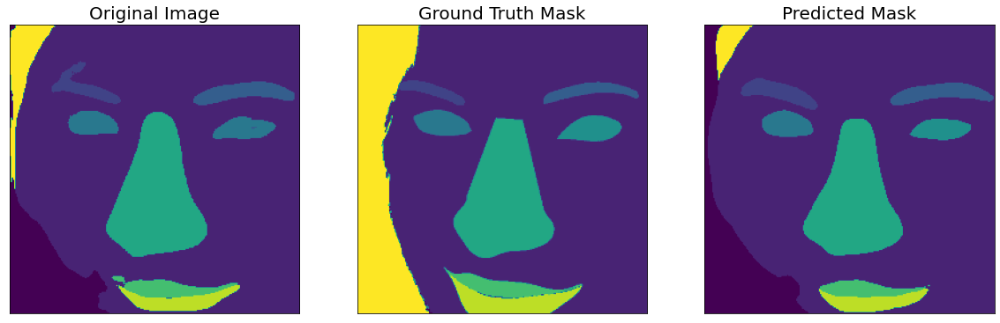

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.5036, 0.9535, 0.5449, 0.7320, 0.6297, 0.6887, 0.9104, 0.7279, 0.6764,
        0.6557, 0.9237])
tensor([0.5036, 0.9535, 0.5449, 0.7320, 0.6297, 0.6887, 0.9104, 0.7279, 0.6764,
        0.6557, 0.9237])


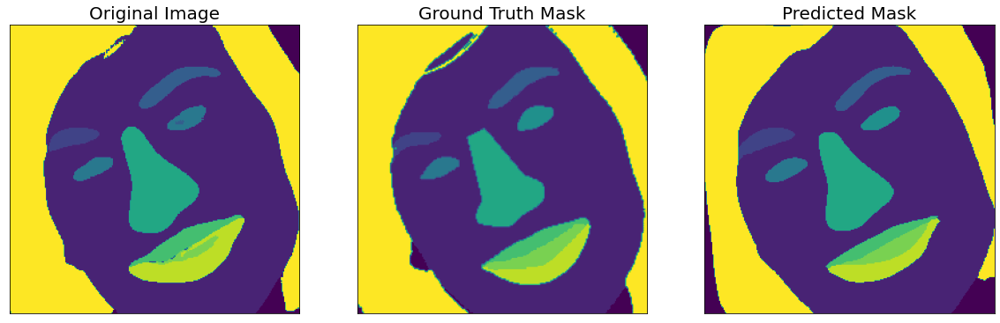

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9421, 0.9122, 0.6477, 0.7432, 0.6117, 0.6264, 0.8886, 0.6782, 0.6636,
        0.4271, 0.7750])
tensor([0.9421, 0.9122, 0.6477, 0.7432, 0.6117, 0.6264, 0.8886, 0.6782, 0.6636,
        0.4271, 0.7750])


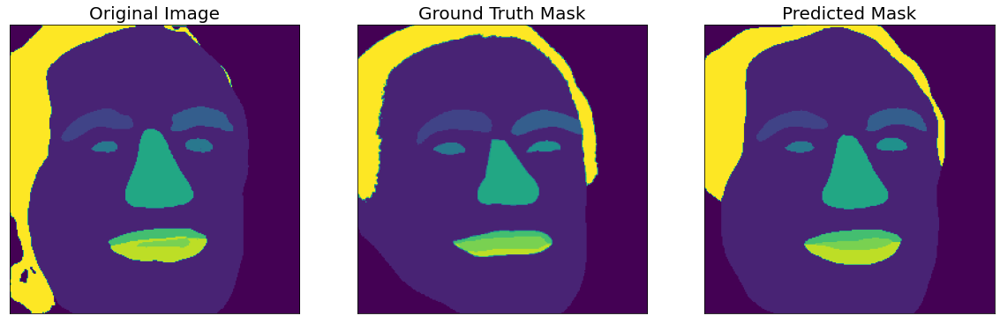

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9663, 0.9635, 0.7060, 0.7073, 0.7917, 0.6762, 0.9085, 0.7613, 0.0000,
        0.8353, 0.8637])
tensor([0.9663, 0.9635, 0.7060, 0.7073, 0.7917, 0.6762, 0.9085, 0.7613,    nan,
        0.8353, 0.8637])


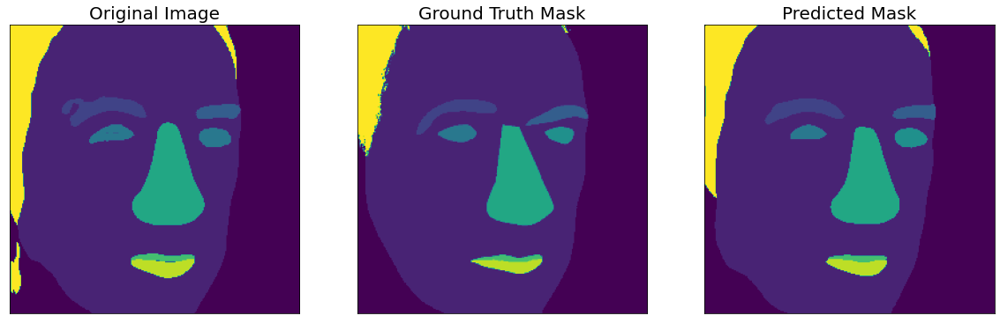

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9402, 0.9501, 0.4003, 0.6798, 0.5409, 0.5557, 0.9289, 0.7250, 0.8063,
        0.6502, 0.8363])
tensor([0.9402, 0.9501, 0.4003, 0.6798, 0.5409, 0.5557, 0.9289, 0.7250, 0.8063,
        0.6502, 0.8363])


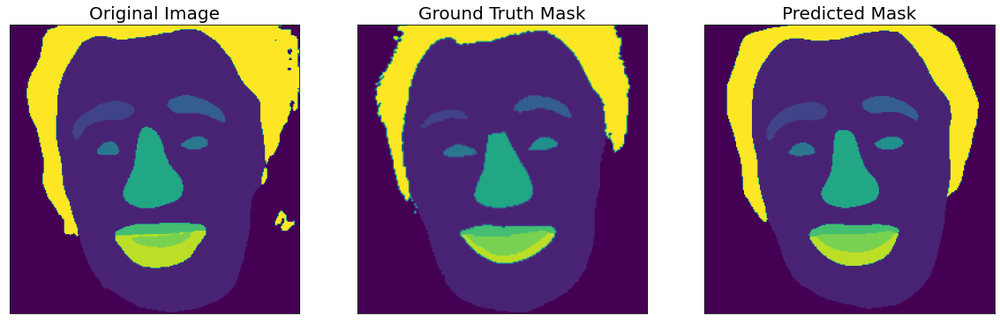

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.7992, 0.9307, 0.0000, 0.0615, 0.5976, 0.5452, 0.8488, 0.5449, 0.7080,
        0.6961, 0.9649])
tensor([0.7992, 0.9307,    nan,    nan, 0.5976, 0.5452, 0.8488, 0.5449, 0.7080,
        0.6961, 0.9649])


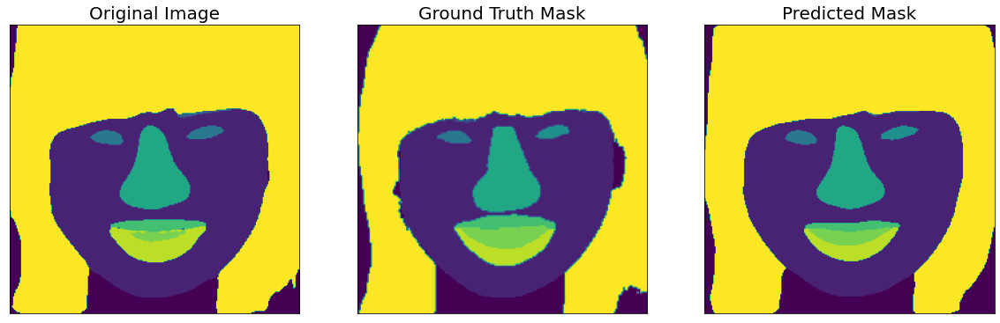

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9861, 0.9619, 0.7589, 0.6275, 0.7335, 0.8167, 0.9626, 0.6997, 0.0000,
        0.5411, 0.0000])
tensor([0.9861, 0.9619, 0.7589, 0.6275, 0.7335, 0.8167, 0.9626, 0.6997,    nan,
        0.5411,    nan])


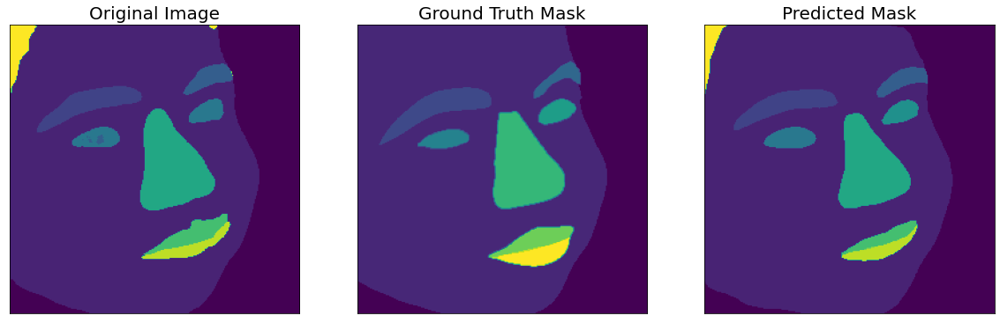

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9611, 0.9627, 0.6677, 0.6335, 0.8251, 0.8785, 0.9241, 0.8166, 0.3274,
        0.8364, 0.0000])
tensor([0.9611, 0.9627, 0.6677, 0.6335, 0.8251, 0.8785, 0.9241, 0.8166, 0.3274,
        0.8364,    nan])


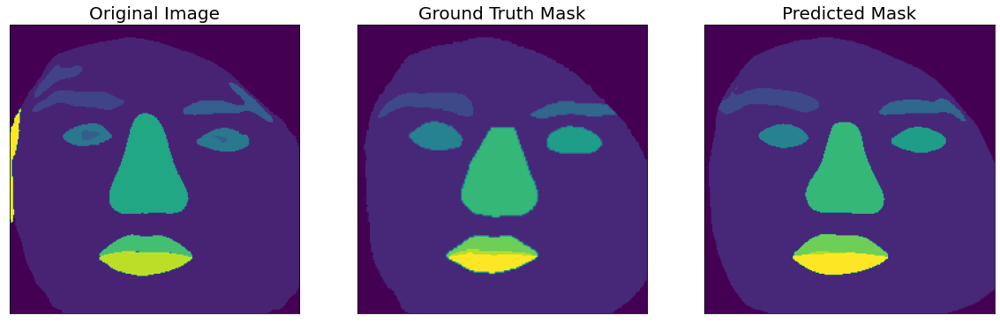

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9656, 0.9668, 0.7862, 0.7296, 0.7027, 0.7517, 0.9504, 0.6966, 0.0000,
        0.6774, 0.7959])
tensor([0.9656, 0.9668, 0.7862, 0.7296, 0.7027, 0.7517, 0.9504, 0.6966,    nan,
        0.6774, 0.7959])


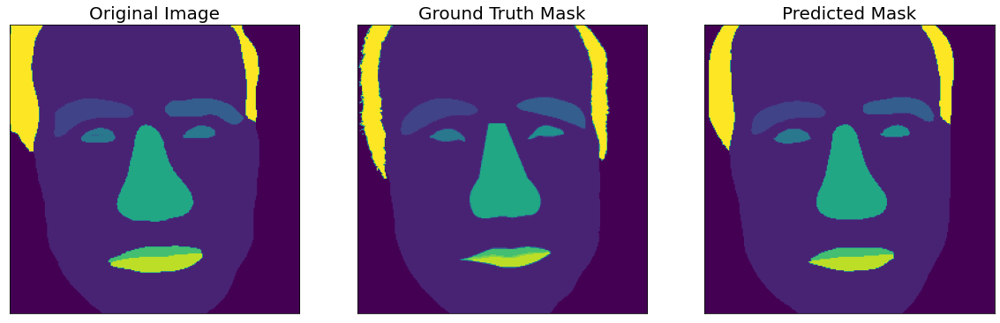

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8429, 0.9417, 0.4010, 0.5120, 0.3409, 0.2497, 0.8474, 0.6342, 0.0578,
        0.6391, 0.8656])
tensor([0.8429, 0.9417, 0.4010, 0.5120, 0.3409, 0.2497, 0.8474, 0.6342,    nan,
        0.6391, 0.8656])


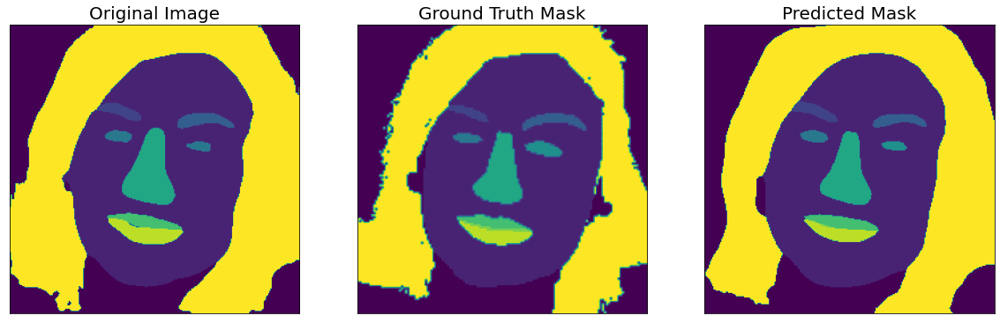

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.4345, 0.9465, 0.7226, 0.5760, 0.6911, 0.6938, 0.9055, 0.7225, 0.0000,
        0.3302, 0.9646])
tensor([0.4345, 0.9465, 0.7226, 0.5760, 0.6911, 0.6938, 0.9055, 0.7225,    nan,
        0.3302, 0.9646])


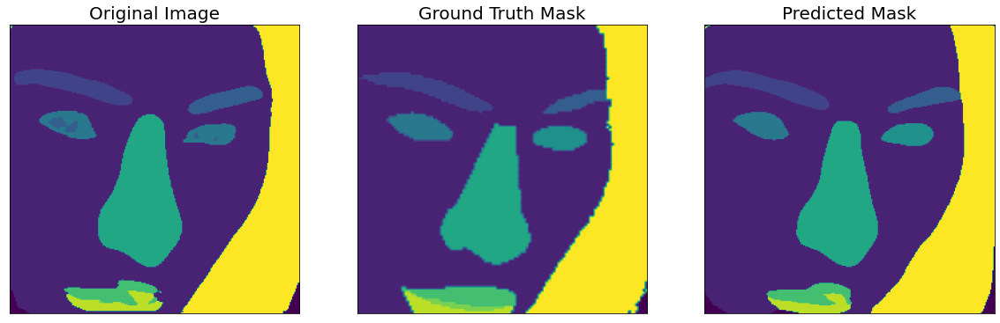

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9408, 0.9321, 0.7976, 0.7967, 0.7697, 0.7456, 0.9092, 0.2600, 0.0000,
        0.2031, 0.5936])
tensor([0.9408, 0.9321, 0.7976, 0.7967, 0.7697, 0.7456, 0.9092, 0.2600,    nan,
        0.2031, 0.5936])


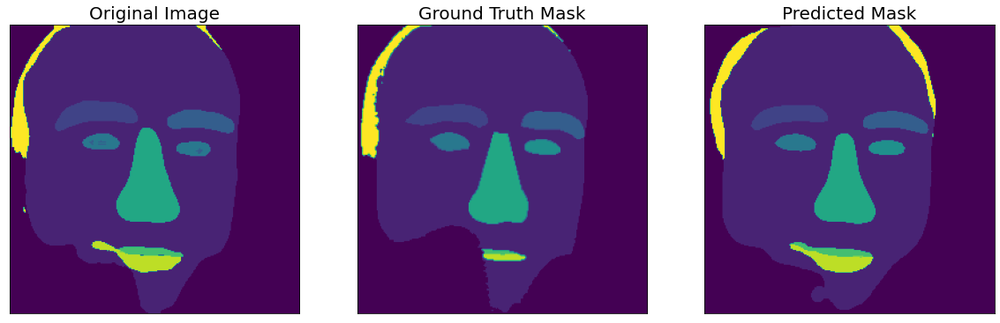

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9051, 0.9695, 0.7649, 0.5785, 0.3494, 0.3891, 0.9507, 0.7969, 0.0000,
        0.6946, 0.2384])
tensor([0.9051, 0.9695, 0.7649, 0.5785, 0.3494, 0.3891, 0.9507, 0.7969,    nan,
        0.6946, 0.2384])


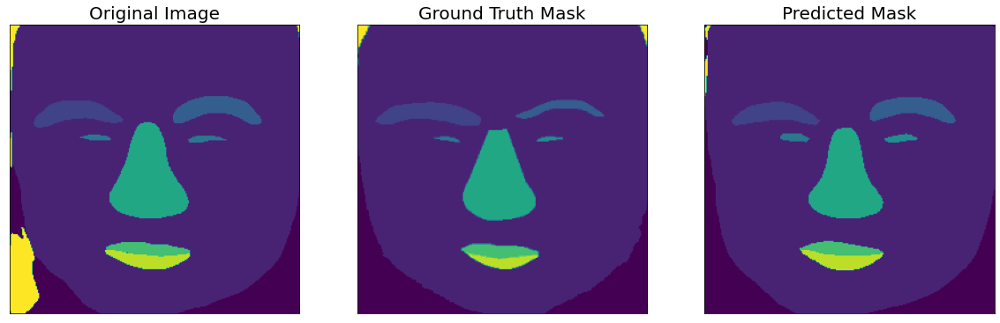

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8531, 0.9523, 0.5185, 0.5897, 0.4288, 0.4368, 0.8618, 0.7689, 0.8168,
        0.7018, 0.7862])
tensor([0.8531, 0.9523, 0.5185, 0.5897, 0.4288, 0.4368, 0.8618, 0.7689, 0.8168,
        0.7018, 0.7862])


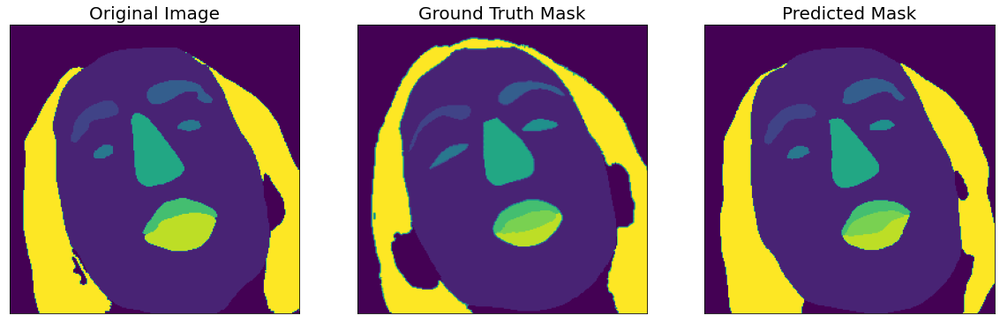

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9191, 0.9466, 0.4252, 0.3314, 0.3636, 0.2264, 0.8879, 0.5496, 0.0000,
        0.8188, 0.7608])
tensor([0.9191, 0.9466, 0.4252, 0.3314, 0.3636, 0.2264, 0.8879, 0.5496,    nan,
        0.8188, 0.7608])


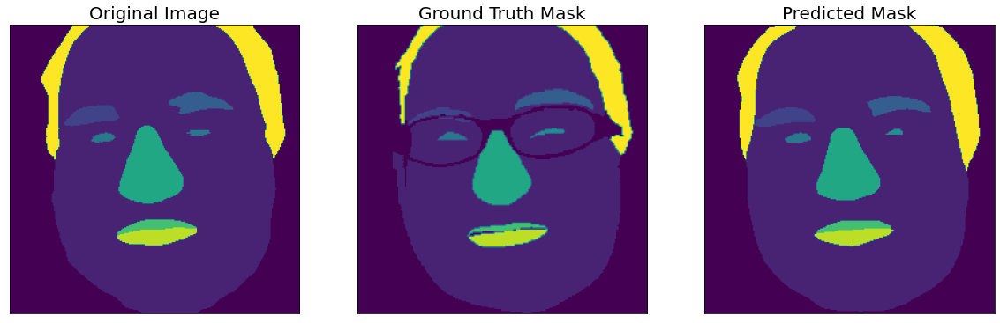

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9214, 0.9438, 0.7155, 0.8020, 0.7500, 0.7493, 0.9319, 0.6034, 0.0000,
        0.8150, 0.5913])
tensor([0.9214, 0.9438, 0.7155, 0.8020, 0.7500, 0.7493, 0.9319, 0.6034,    nan,
        0.8150, 0.5913])


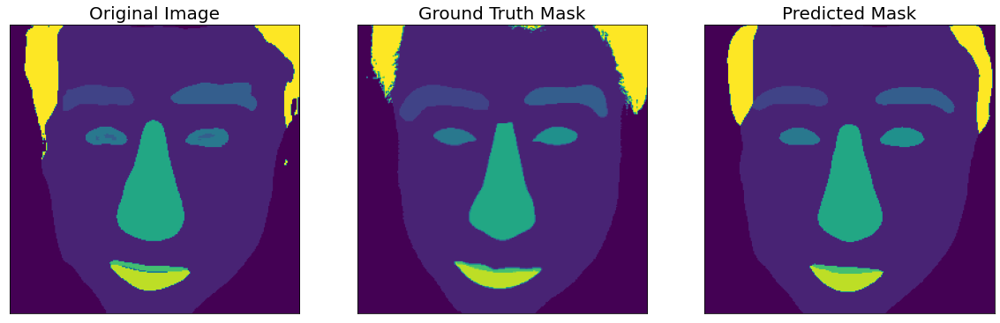

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.5003, 0.9028, 0.7193, 0.4237, 0.7725, 0.8181, 0.9115, 0.1992, 0.0424,
        0.8279, 0.8807])
tensor([0.5003, 0.9028, 0.7193, 0.4237, 0.7725, 0.8181, 0.9115, 0.1992,    nan,
        0.8279, 0.8807])


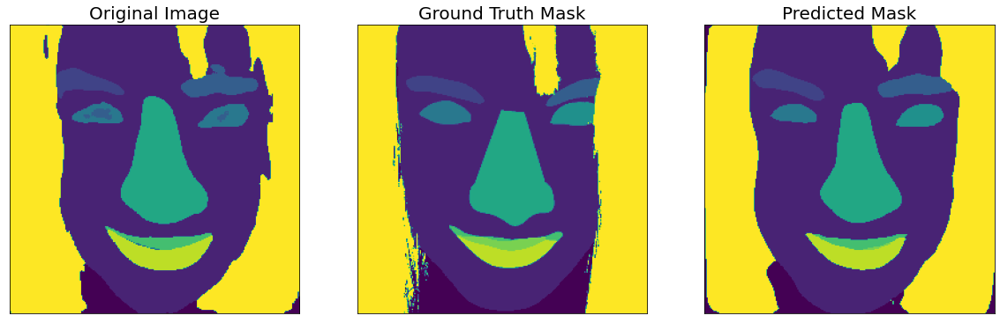

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.7353, 0.9456, 0.5517, 0.5956, 0.5159, 0.5820, 0.8641, 0.5022, 0.0000,
        0.8305, 0.7452])
tensor([0.7353, 0.9456, 0.5517, 0.5956, 0.5159, 0.5820, 0.8641, 0.5022,    nan,
        0.8305, 0.7452])


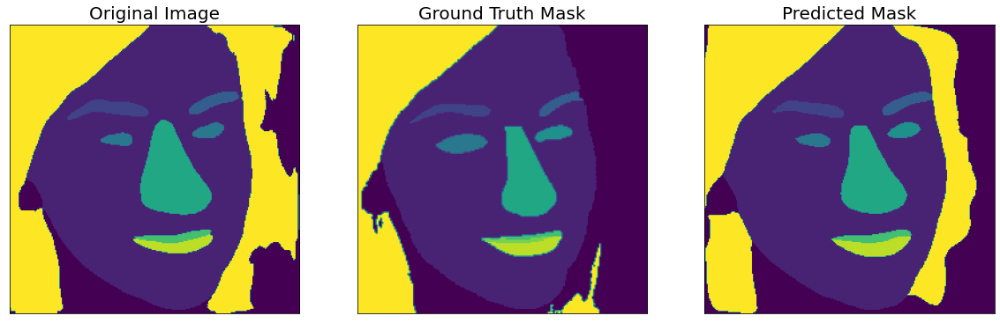

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8757, 0.8952, 0.7590, 0.7491, 0.8874, 0.8358, 0.9178, 0.4878, 0.3634,
        0.4550, 0.3980])
tensor([0.8757, 0.8952, 0.7590, 0.7491, 0.8874, 0.8358, 0.9178, 0.4878, 0.3634,
        0.4550, 0.3980])


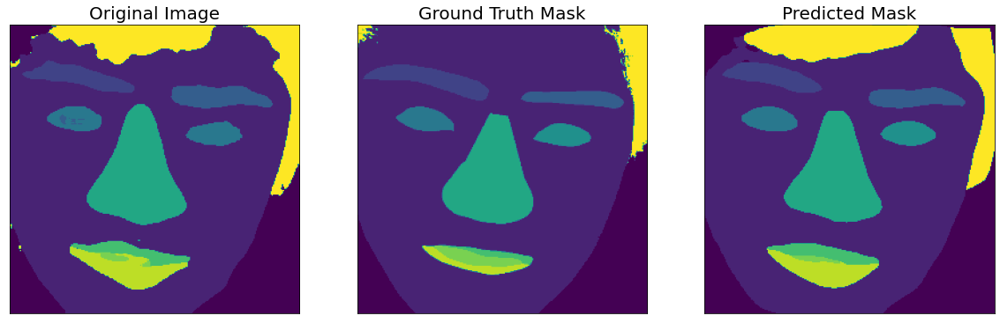

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8393, 0.9636, 0.5641, 0.5958, 0.6260, 0.6708, 0.9355, 0.7848, 0.0000,
        0.7959, 0.9630])
tensor([0.8393, 0.9636, 0.5641, 0.5958, 0.6260, 0.6708, 0.9355, 0.7848,    nan,
        0.7959, 0.9630])


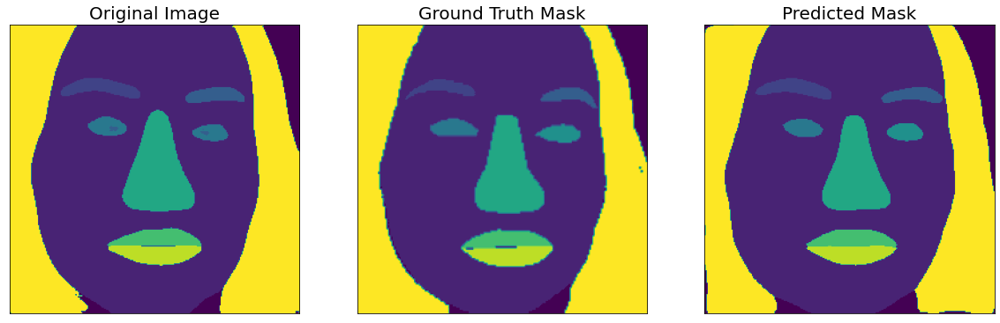

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8709, 0.9287, 0.6732, 0.5056, 0.4341, 0.4692, 0.9007, 0.3798, 0.0000,
        0.8183, 0.8906])
tensor([0.8709, 0.9287, 0.6732, 0.5056, 0.4341, 0.4692, 0.9007, 0.3798,    nan,
        0.8183, 0.8906])


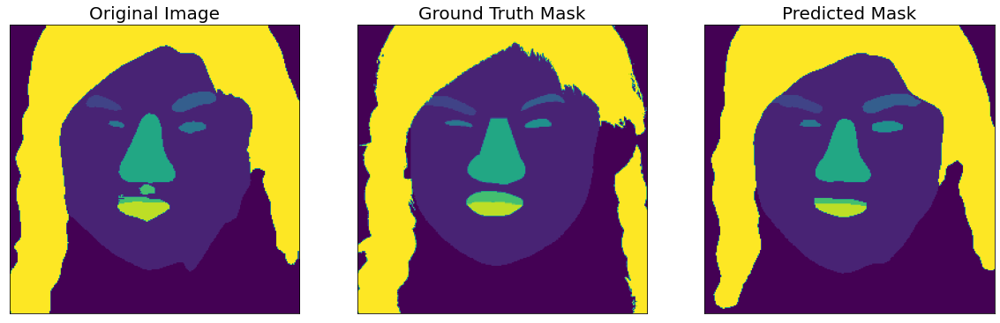

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9565, 0.9487, 0.7159, 0.5300, 0.3698, 0.3785, 0.8828, 0.5204, 0.1090,
        0.6158, 0.9351])
tensor([0.9565, 0.9487, 0.7159, 0.5300, 0.3698, 0.3785, 0.8828, 0.5204, 0.1090,
        0.6158, 0.9351])


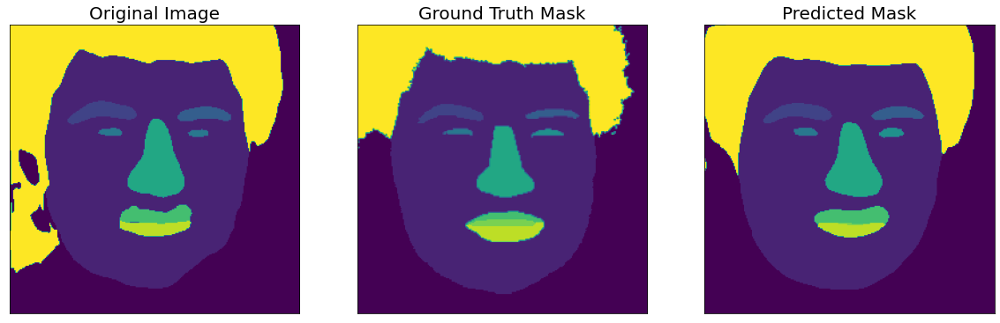

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9712, 0.9434, 0.8198, 0.8173, 0.5812, 0.6869, 0.9069, 0.7366, 0.0000,
        0.7526, 0.9141])
tensor([0.9712, 0.9434, 0.8198, 0.8173, 0.5812, 0.6869, 0.9069, 0.7366,    nan,
        0.7526, 0.9141])


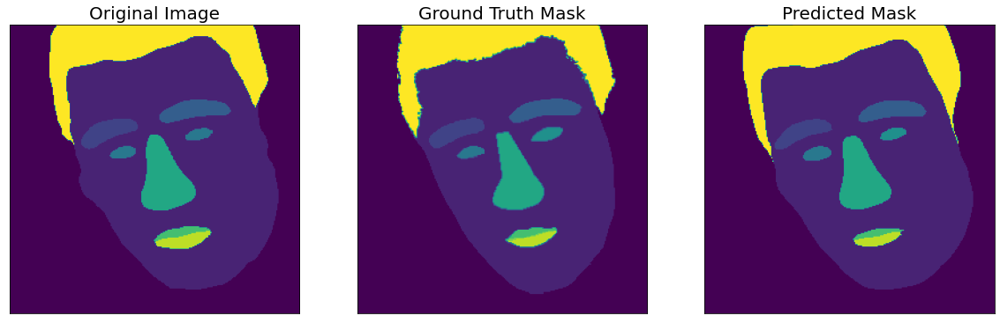

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9538, 0.9477, 0.6085, 0.7128, 0.6243, 0.6914, 0.9274, 0.5346, 0.7431,
        0.7909, 0.9641])
tensor([0.9538, 0.9477, 0.6085, 0.7128, 0.6243, 0.6914, 0.9274, 0.5346, 0.7431,
        0.7909, 0.9641])


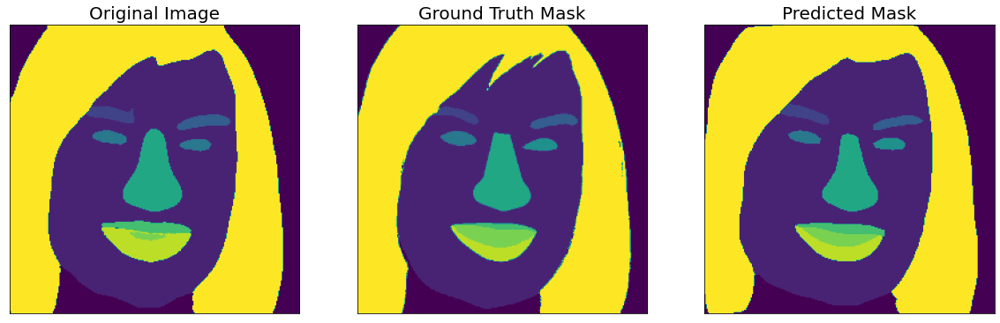

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8582, 0.9437, 0.6463, 0.7036, 0.4899, 0.6035, 0.9102, 0.5718, 0.5894,
        0.0053, 0.8826])
tensor([0.8582, 0.9437, 0.6463, 0.7036, 0.4899, 0.6035, 0.9102, 0.5718, 0.5894,
           nan, 0.8826])


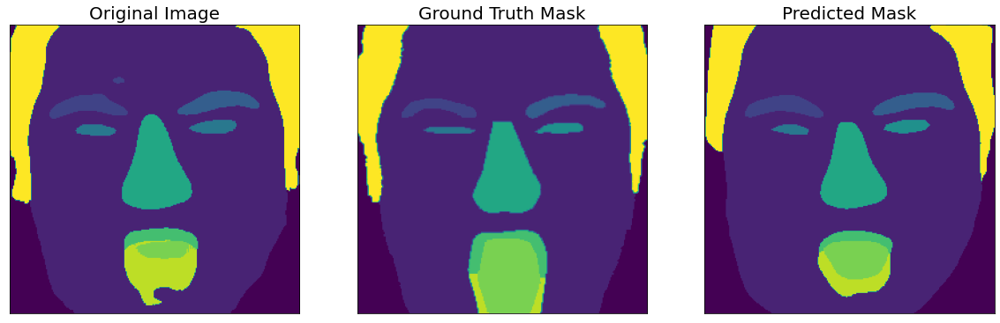

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9447, 0.9450, 0.6205, 0.5867, 0.2011, 0.3433, 0.8807, 0.6817, 0.6398,
        0.7266, 0.8179])
tensor([0.9447, 0.9450, 0.6205, 0.5867, 0.2011, 0.3433, 0.8807, 0.6817, 0.6398,
        0.7266, 0.8179])


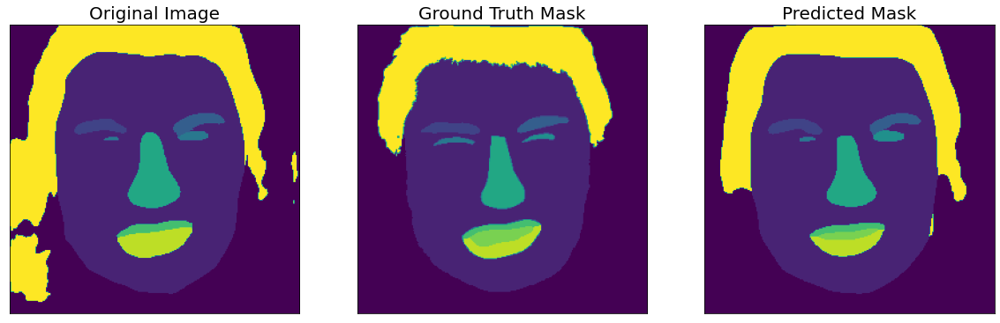

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8912, 0.9402, 0.4975, 0.4943, 0.4924, 0.6543, 0.9202, 0.3786, 0.3578,
        0.5310, 0.8092])
tensor([0.8912, 0.9402, 0.4975, 0.4943, 0.4924, 0.6543, 0.9202, 0.3786, 0.3578,
        0.5310, 0.8092])


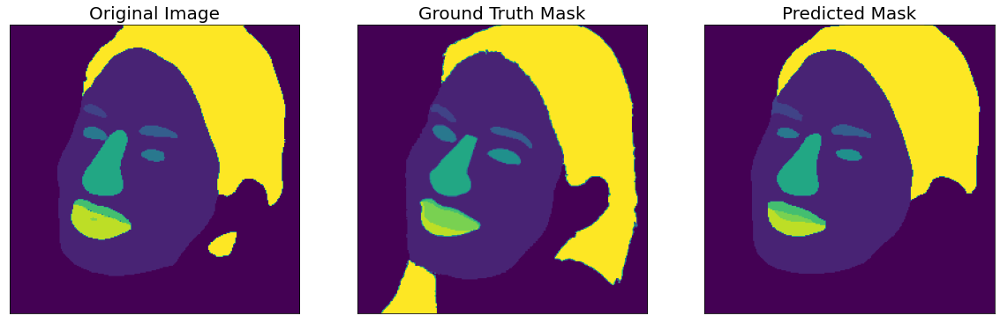

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9656, 0.9427, 0.4647, 0.6952, 0.5304, 0.6766, 0.8789, 0.6992, 0.0000,
        0.6496, 0.0000])
tensor([0.9656, 0.9427, 0.4647, 0.6952, 0.5304, 0.6766, 0.8789, 0.6992,    nan,
        0.6496,    nan])


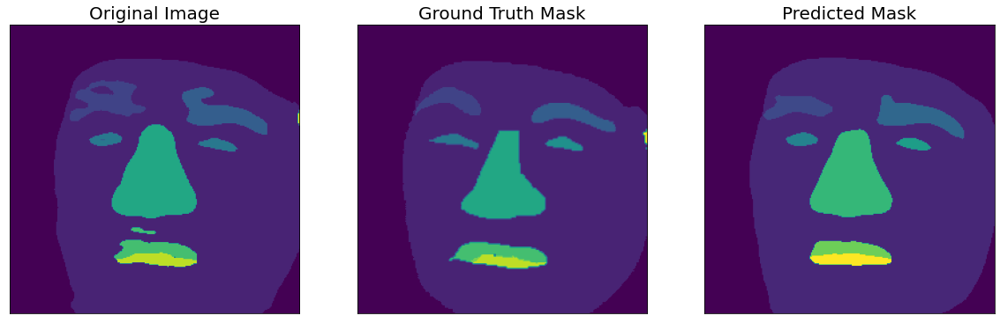

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9099, 0.9400, 0.5329, 0.5989, 0.4894, 0.4222, 0.8777, 0.6989, 0.8501,
        0.7546, 0.8662])
tensor([0.9099, 0.9400, 0.5329, 0.5989, 0.4894, 0.4222, 0.8777, 0.6989, 0.8501,
        0.7546, 0.8662])


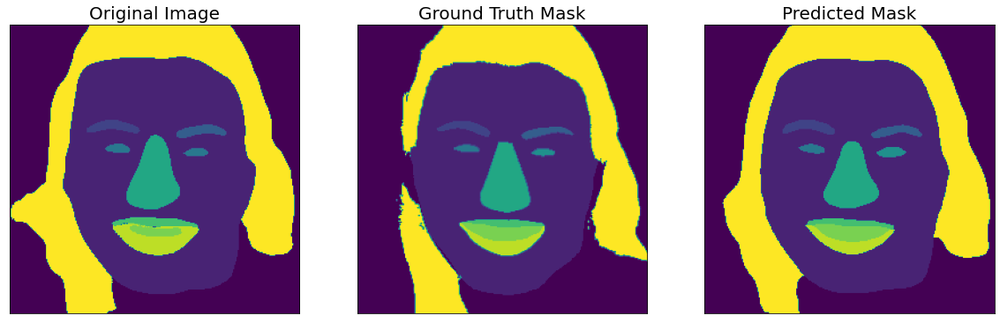

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8786, 0.9450, 0.6878, 0.7272, 0.6814, 0.6604, 0.9062, 0.5728, 0.0000,
        0.7986, 0.4096])
tensor([0.8786, 0.9450, 0.6878, 0.7272, 0.6814, 0.6604, 0.9062, 0.5728,    nan,
        0.7986, 0.4096])


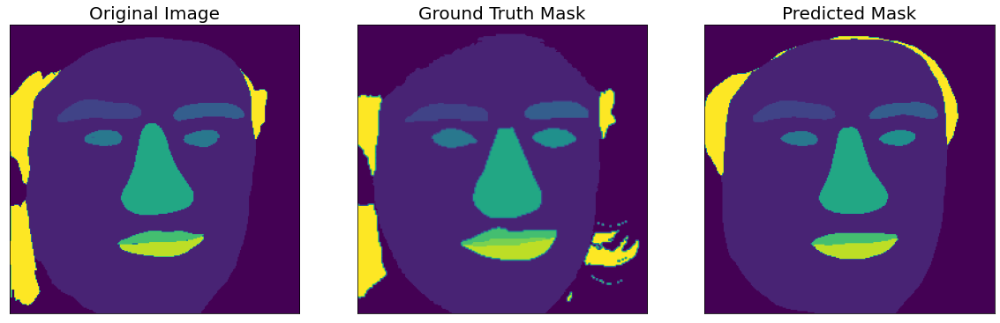

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8987, 0.9588, 0.5987, 0.6600, 0.6533, 0.6845, 0.9238, 0.7233, 0.0000,
        0.7734, 0.9746])
tensor([0.8987, 0.9588, 0.5987, 0.6600, 0.6533, 0.6845, 0.9238, 0.7233,    nan,
        0.7734, 0.9746])


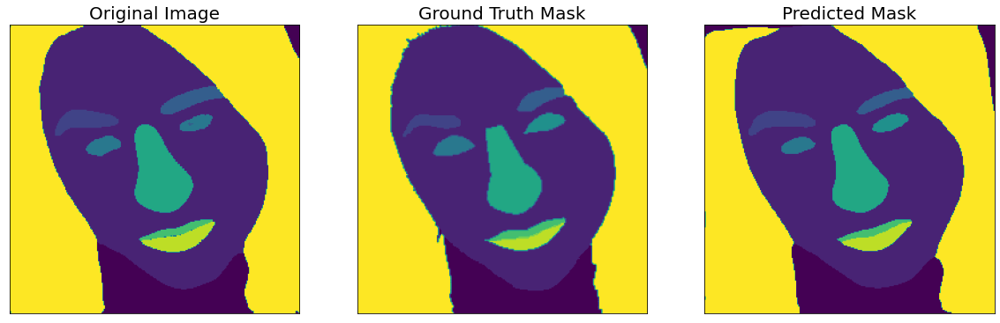

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8221, 0.9430, 0.6935, 0.6637, 0.7527, 0.7701, 0.9153, 0.7651, 0.0000,
        0.6736, 0.7599])
tensor([0.8221, 0.9430, 0.6935, 0.6637, 0.7527, 0.7701, 0.9153, 0.7651,    nan,
        0.6736, 0.7599])


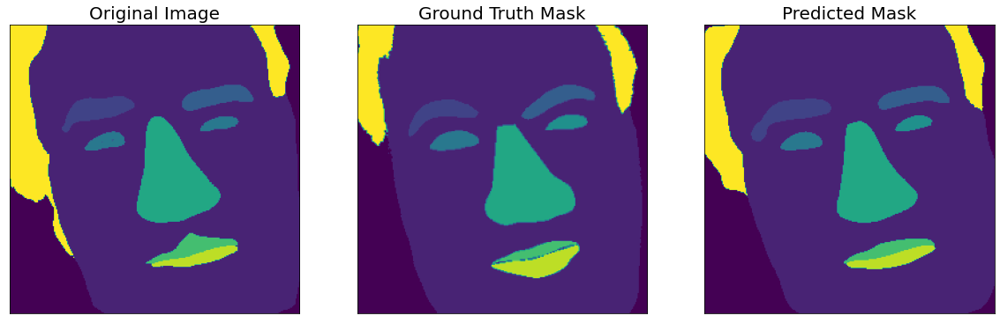

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8961, 0.9583, 0.5394, 0.4970, 0.4595, 0.4194, 0.9352, 0.6412, 0.7192,
        0.7676, 0.8901])
tensor([0.8961, 0.9583, 0.5394, 0.4970, 0.4595, 0.4194, 0.9352, 0.6412, 0.7192,
        0.7676, 0.8901])


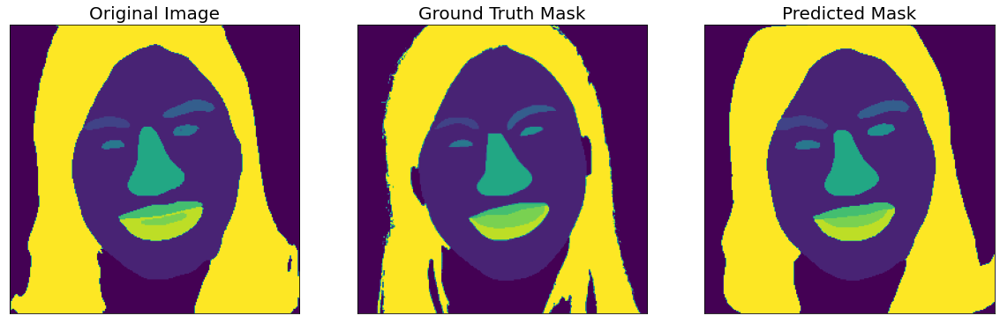

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.7309, 0.8952, 0.7018, 0.6570, 0.0000, 0.0000, 0.8910, 0.7907, 0.8108,
        0.6303, 0.8459])
tensor([0.7309, 0.8952, 0.7018, 0.6570,    nan,    nan, 0.8910, 0.7907, 0.8108,
        0.6303, 0.8459])


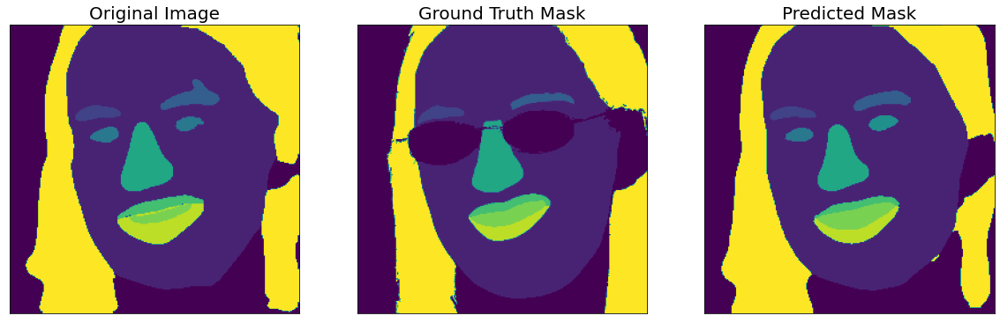

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9378, 0.9506, 0.6678, 0.6121, 0.5908, 0.6414, 0.8629, 0.6885, 0.4108,
        0.7704, 0.8835])
tensor([0.9378, 0.9506, 0.6678, 0.6121, 0.5908, 0.6414, 0.8629, 0.6885, 0.4108,
        0.7704, 0.8835])


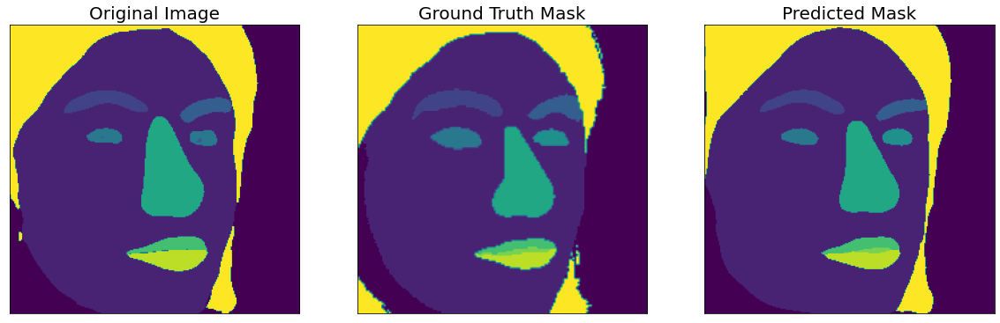

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8622, 0.8661, 0.6847, 0.5111, 0.7849, 0.5601, 0.9423, 0.7810, 0.0000,
        0.8294, 0.7729])
tensor([0.8622, 0.8661, 0.6847, 0.5111, 0.7849, 0.5601, 0.9423, 0.7810,    nan,
        0.8294, 0.7729])


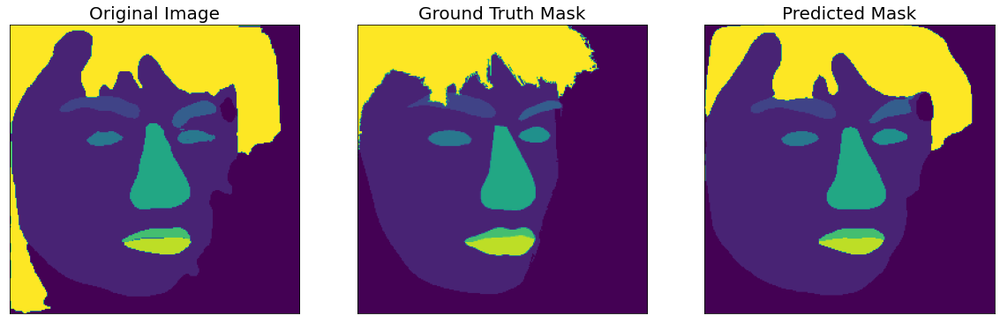

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9823, 0.9542, 0.7450, 0.8165, 0.7347, 0.7564, 0.9094, 0.4792, 0.0000,
        0.6446, 0.7383])
tensor([0.9823, 0.9542, 0.7450, 0.8165, 0.7347, 0.7564, 0.9094, 0.4792,    nan,
        0.6446, 0.7383])


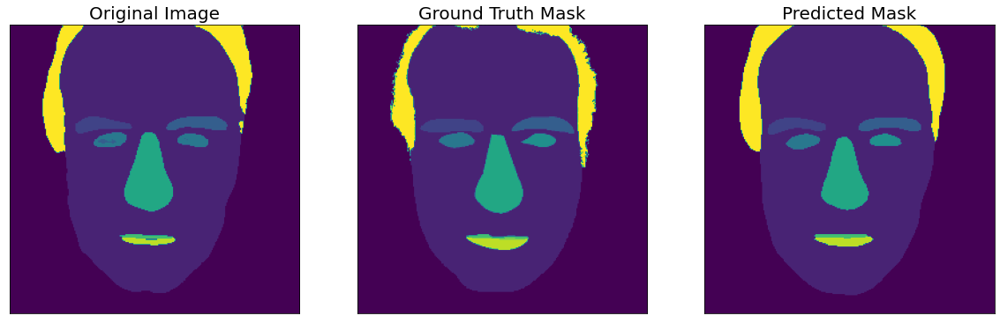

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.3442, 0.9289, 0.6466, 0.6602, 0.0000, 0.1478, 0.8706, 0.0129, 0.0000,
        0.8333, 0.6608])
tensor([0.3442, 0.9289, 0.6466, 0.6602,    nan, 0.1478, 0.8706,    nan,    nan,
        0.8333, 0.6608])


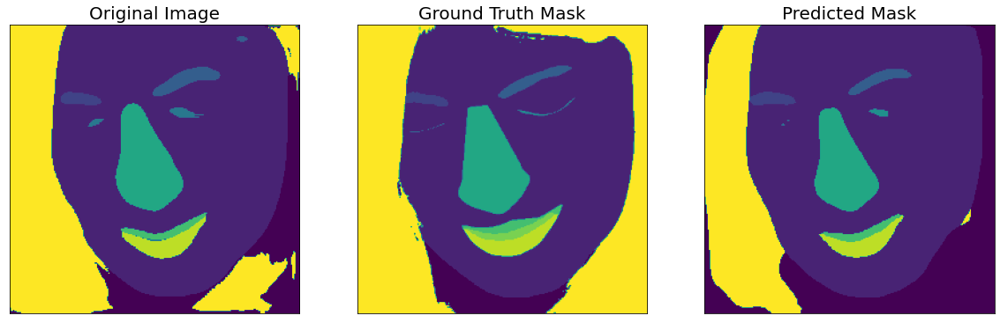

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9552, 0.9511, 0.6775, 0.6838, 0.7275, 0.7512, 0.8832, 0.8426, 0.0000,
        0.7741, 0.9181])
tensor([0.9552, 0.9511, 0.6775, 0.6838, 0.7275, 0.7512, 0.8832, 0.8426,    nan,
        0.7741, 0.9181])


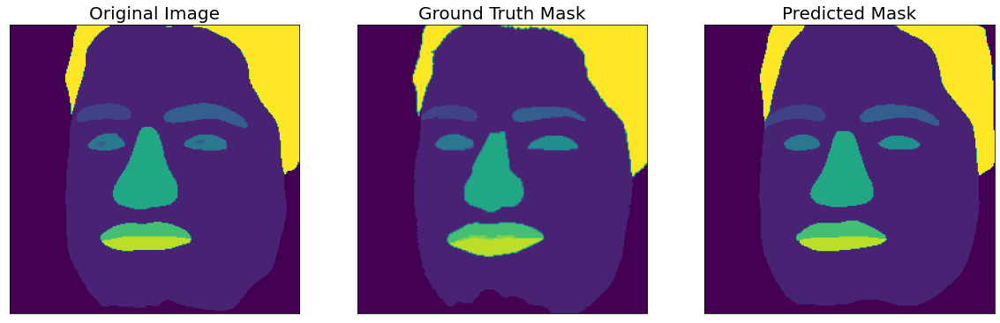

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8270, 0.9515, 0.5385, 0.5551, 0.3871, 0.3798, 0.8780, 0.6226, 0.6947,
        0.5340, 0.6799])
tensor([0.8270, 0.9515, 0.5385, 0.5551, 0.3871, 0.3798, 0.8780, 0.6226, 0.6947,
        0.5340, 0.6799])


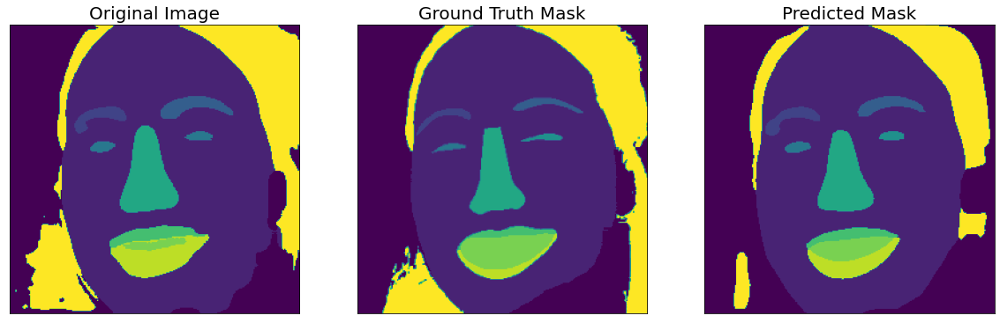

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.6952, 0.9571, 0.7548, 0.6474, 0.7615, 0.7116, 0.8847, 0.2131, 0.6240,
        0.7505, 0.8520])
tensor([0.6952, 0.9571, 0.7548, 0.6474, 0.7615, 0.7116, 0.8847, 0.2131, 0.6240,
        0.7505, 0.8520])


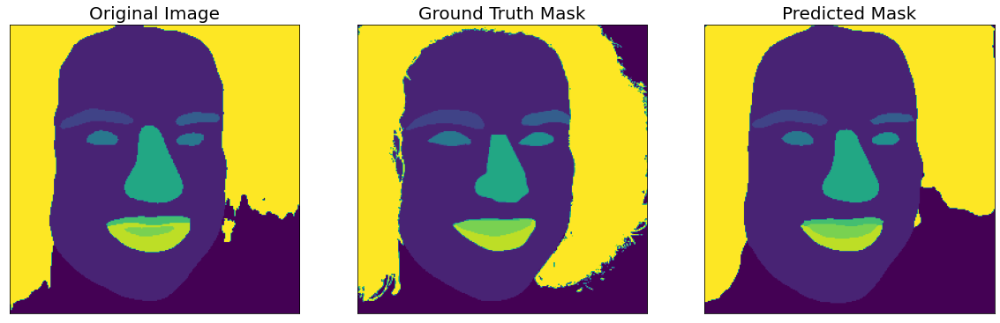

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9549, 0.9394, 0.3251, 0.6095, 0.6014, 0.6642, 0.9133, 0.2568, 0.1278,
        0.6807, 0.8841])
tensor([0.9549, 0.9394, 0.3251, 0.6095, 0.6014, 0.6642, 0.9133, 0.2568, 0.1278,
        0.6807, 0.8841])


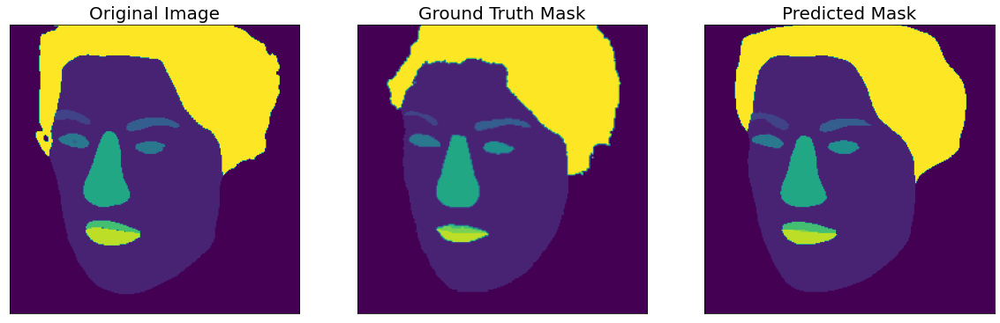

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9664, 0.9459, 0.6831, 0.6474, 0.6503, 0.7239, 0.9059, 0.1109, 0.6910,
        0.6857, 0.8724])
tensor([0.9664, 0.9459, 0.6831, 0.6474, 0.6503, 0.7239, 0.9059, 0.1109, 0.6910,
        0.6857, 0.8724])


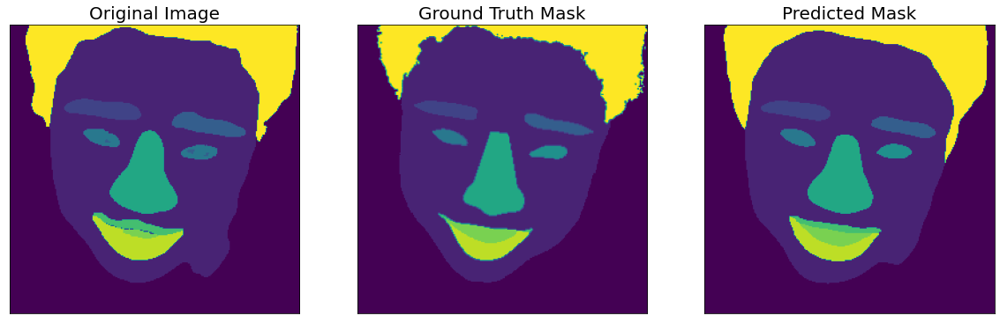

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9327, 0.9492, 0.7144, 0.7846, 0.8135, 0.8285, 0.9465, 0.4665, 0.0000,
        0.8142, 0.0000])
tensor([0.9327, 0.9492, 0.7144, 0.7846, 0.8135, 0.8285, 0.9465, 0.4665,    nan,
        0.8142,    nan])


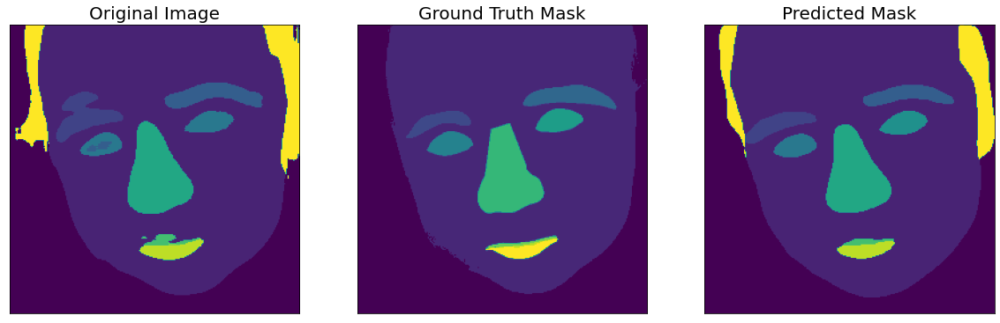

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9729, 0.9643, 0.7758, 0.7906, 0.7172, 0.6838, 0.9354, 0.6957, 0.0000,
        0.7365, 0.2810])
tensor([0.9729, 0.9643, 0.7758, 0.7906, 0.7172, 0.6838, 0.9354, 0.6957,    nan,
        0.7365, 0.2810])


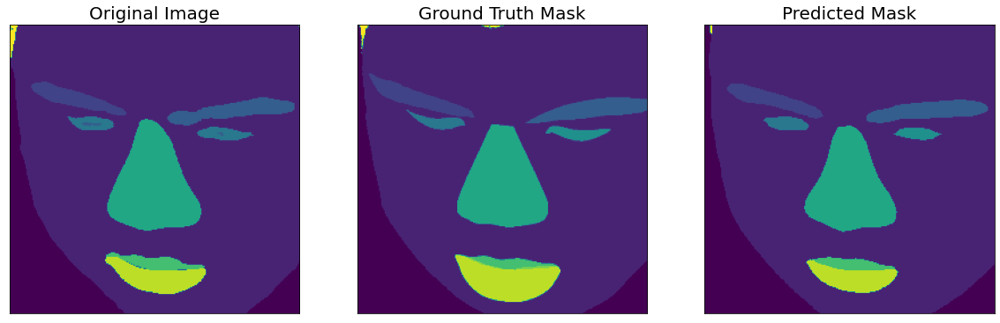

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.5419, 0.9444, 0.5155, 0.4315, 0.7087, 0.6342, 0.8724, 0.7479, 0.0000,
        0.6970, 0.8722])
tensor([0.5419, 0.9444, 0.5155, 0.4315, 0.7087, 0.6342, 0.8724, 0.7479,    nan,
        0.6970, 0.8722])


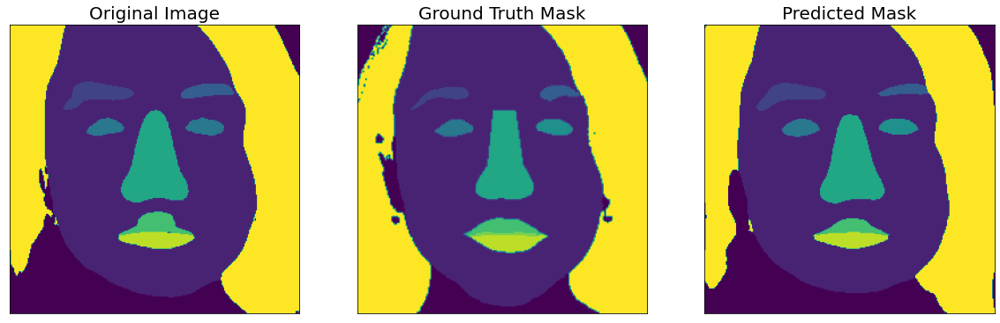

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8064, 0.9562, 0.4935, 0.5417, 0.6475, 0.6647, 0.8767, 0.6746, 0.8325,
        0.7293, 0.7794])
tensor([0.8064, 0.9562, 0.4935, 0.5417, 0.6475, 0.6647, 0.8767, 0.6746, 0.8325,
        0.7293, 0.7794])


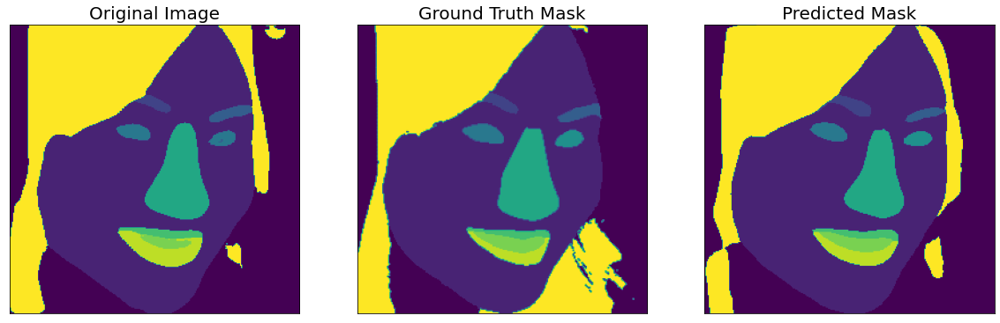

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8989, 0.9479, 0.8159, 0.3667, 0.8036, 0.8450, 0.9391, 0.7994, 0.0000,
        0.9129, 0.9464])
tensor([0.8989, 0.9479, 0.8159, 0.3667, 0.8036, 0.8450, 0.9391, 0.7994,    nan,
        0.9129, 0.9464])


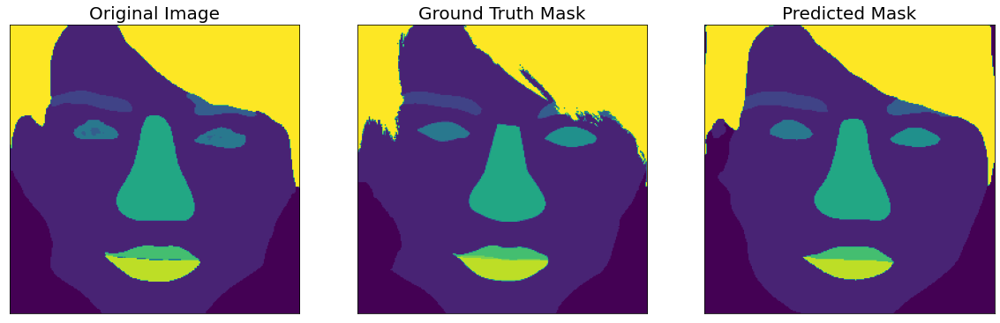

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9239, 0.9289, 0.6965, 0.8046, 0.4964, 0.6219, 0.9154, 0.4059, 0.1926,
        0.4687, 0.9410])
tensor([0.9239, 0.9289, 0.6965, 0.8046, 0.4964, 0.6219, 0.9154, 0.4059, 0.1926,
        0.4687, 0.9410])


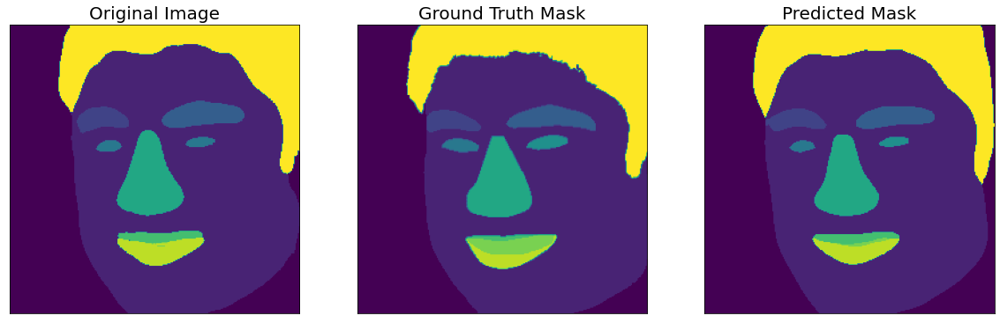

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9229, 0.9608, 0.7239, 0.5126, 0.5922, 0.5213, 0.9044, 0.6405, 0.6885,
        0.7569, 0.9708])
tensor([0.9229, 0.9608, 0.7239, 0.5126, 0.5922, 0.5213, 0.9044, 0.6405, 0.6885,
        0.7569, 0.9708])


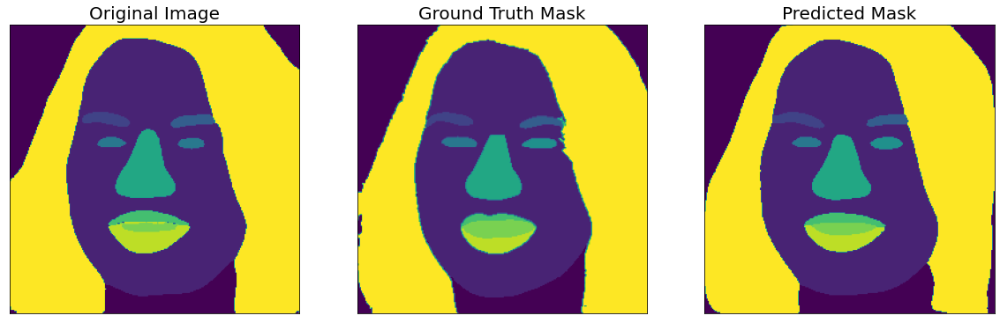

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9286, 0.9592, 0.6163, 0.6934, 0.5277, 0.5730, 0.8955, 0.8116, 0.0745,
        0.7870, 0.8774])
tensor([0.9286, 0.9592, 0.6163, 0.6934, 0.5277, 0.5730, 0.8955, 0.8116,    nan,
        0.7870, 0.8774])


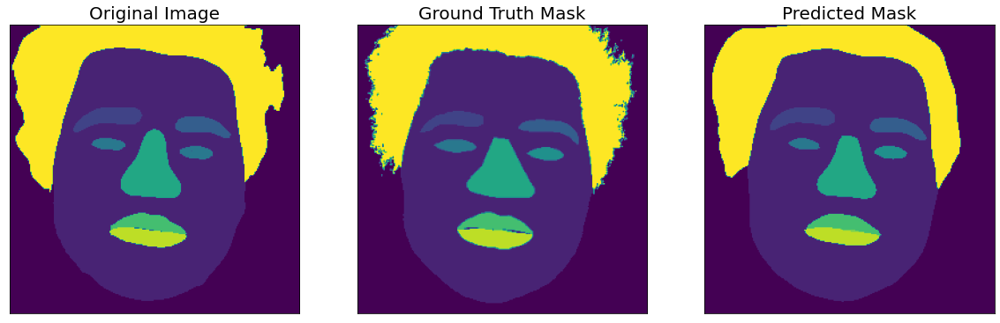

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9423, 0.9314, 0.4571, 0.5547, 0.7114, 0.7281, 0.8679, 0.1218, 0.0000,
        0.3510, 0.3767])
tensor([0.9423, 0.9314, 0.4571, 0.5547, 0.7114, 0.7281, 0.8679, 0.1218,    nan,
        0.3510, 0.3767])


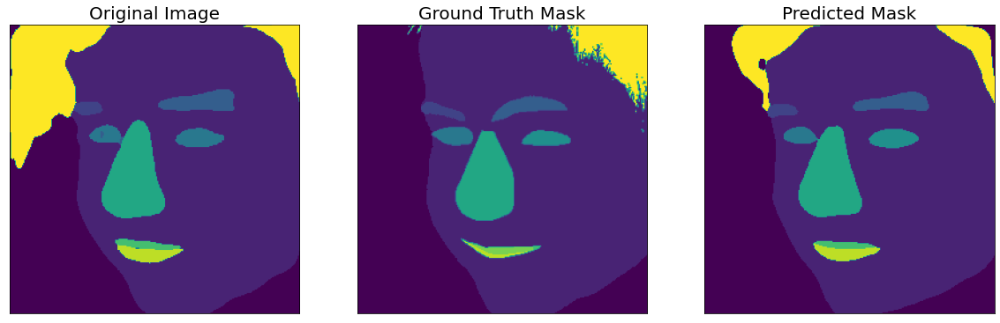

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9361, 0.9084, 0.3345, 0.4011, 0.7021, 0.6476, 0.8740, 0.5093, 0.0000,
        0.6538, 0.2901])
tensor([0.9361, 0.9084, 0.3345, 0.4011, 0.7021, 0.6476, 0.8740, 0.5093,    nan,
        0.6538, 0.2901])


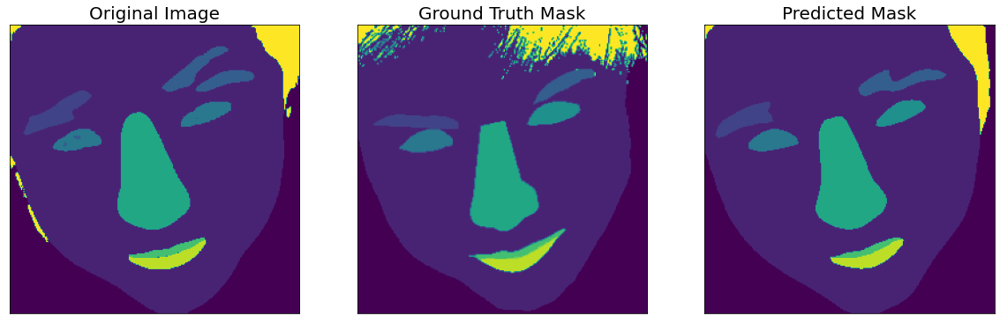

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.7880, 0.8964, 0.4772, 0.3096, 0.6032, 0.5997, 0.8546, 0.3873, 0.0000,
        0.4381, 0.6436])
tensor([0.7880, 0.8964, 0.4772, 0.3096, 0.6032, 0.5997, 0.8546, 0.3873,    nan,
        0.4381, 0.6436])


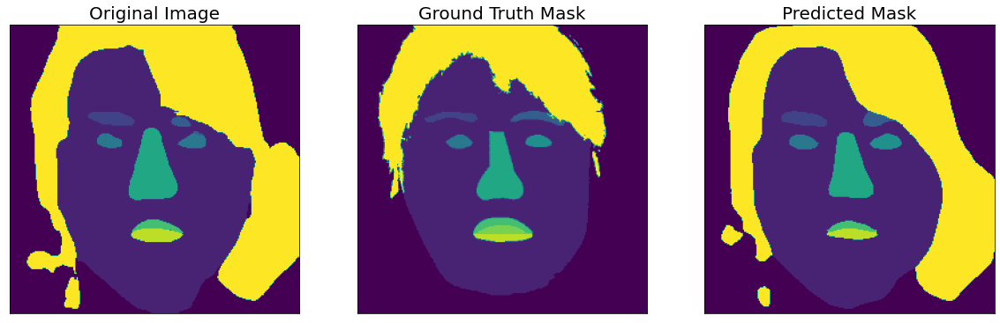

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8706, 0.9212, 0.7811, 0.6526, 0.7675, 0.7907, 0.9527, 0.6262, 0.0000,
        0.8455, 0.0000])
tensor([0.8706, 0.9212, 0.7811, 0.6526, 0.7675, 0.7907, 0.9527, 0.6262,    nan,
        0.8455,    nan])


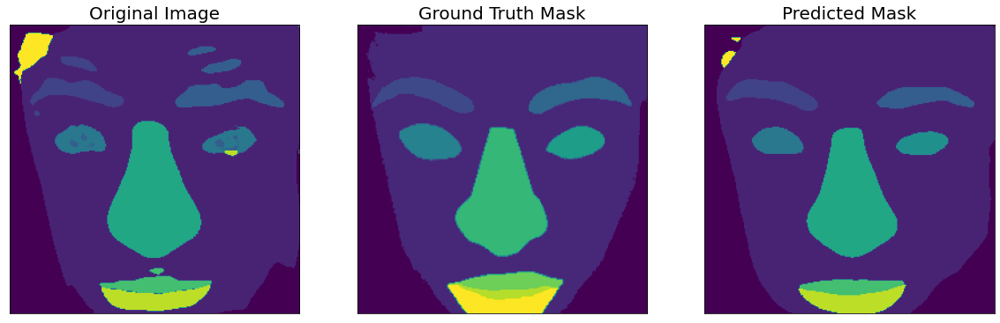

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.7505, 0.9227, 0.5250, 0.3483, 0.4929, 0.4975, 0.8304, 0.4177, 0.0000,
        0.5087, 0.1150])
tensor([0.7505, 0.9227, 0.5250, 0.3483, 0.4929, 0.4975, 0.8304, 0.4177,    nan,
        0.5087, 0.1150])


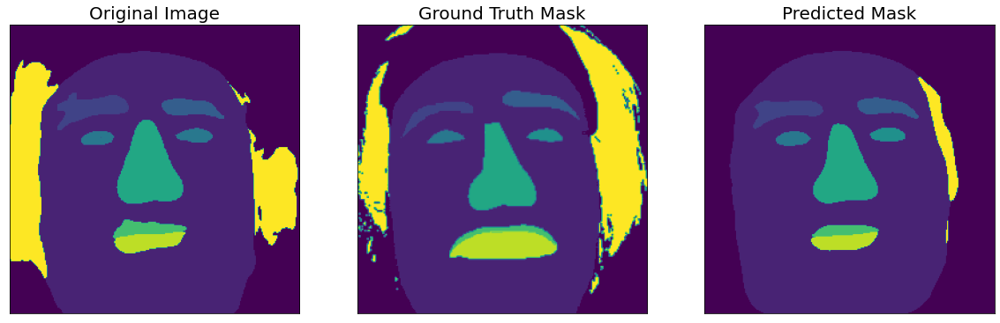

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9480, 0.9682, 0.8584, 0.8576, 0.7883, 0.7872, 0.9521, 0.4802, 0.0000,
        0.7041, 0.7195])
tensor([0.9480, 0.9682, 0.8584, 0.8576, 0.7883, 0.7872, 0.9521, 0.4802,    nan,
        0.7041, 0.7195])


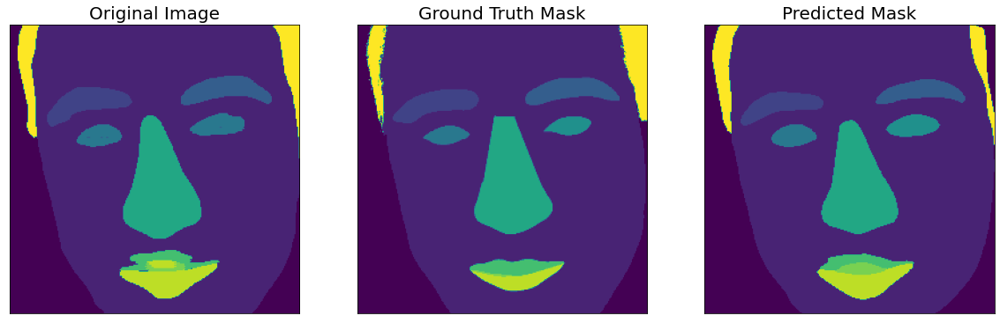

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.3589, 0.9365, 0.4195, 0.2515, 0.2456, 0.5358, 0.9076, 0.8412, 0.8477,
        0.8339, 0.9297])
tensor([0.3589, 0.9365, 0.4195, 0.2515, 0.2456, 0.5358, 0.9076, 0.8412, 0.8477,
        0.8339, 0.9297])


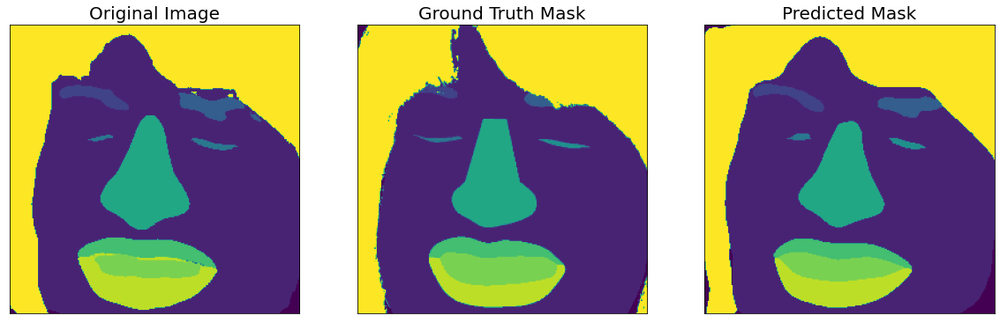

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.6891, 0.9325, 0.6688, 0.3422, 0.6481, 0.6351, 0.8759, 0.3369, 0.3534,
        0.8526, 0.9006])
tensor([0.6891, 0.9325, 0.6688, 0.3422, 0.6481, 0.6351, 0.8759, 0.3369, 0.3534,
        0.8526, 0.9006])


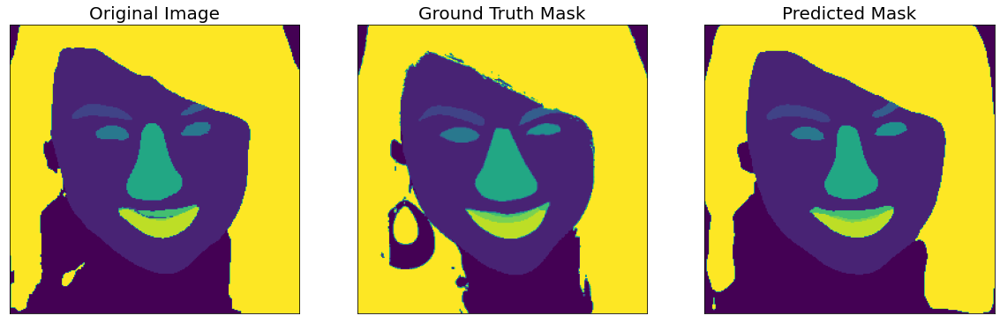

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9433, 0.9554, 0.6527, 0.6527, 0.8006, 0.8023, 0.9499, 0.2680, 0.0000,
        0.6192, 0.9579])
tensor([0.9433, 0.9554, 0.6527, 0.6527, 0.8006, 0.8023, 0.9499, 0.2680,    nan,
        0.6192, 0.9579])


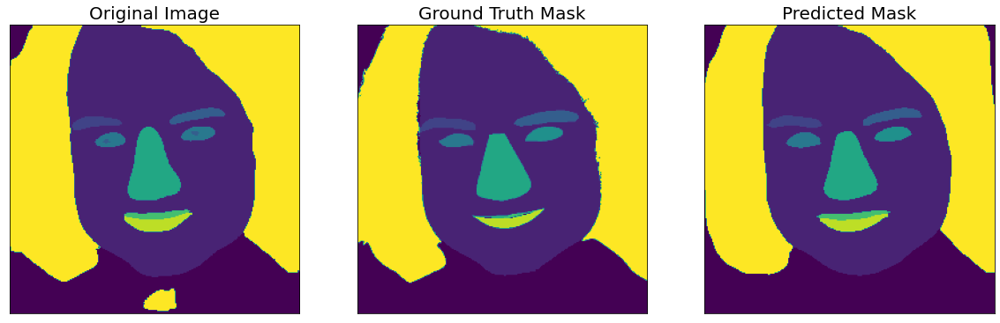

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8772, 0.9375, 0.6180, 0.3755, 0.6347, 0.6798, 0.8572, 0.2289, 0.6368,
        0.4292, 0.8422])
tensor([0.8772, 0.9375, 0.6180, 0.3755, 0.6347, 0.6798, 0.8572, 0.2289, 0.6368,
        0.4292, 0.8422])


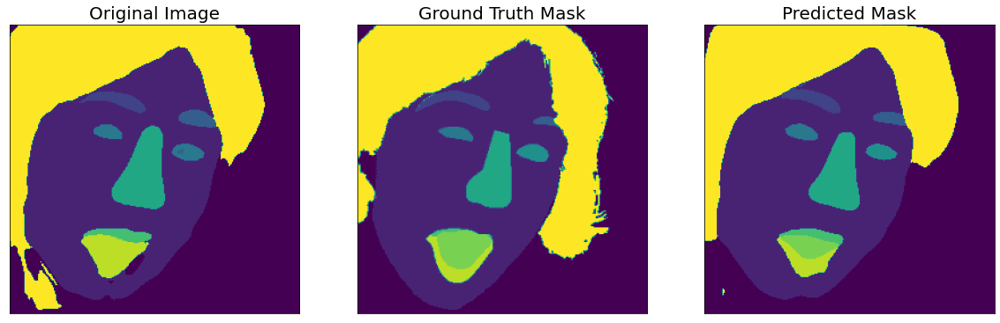

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8519, 0.9021, 0.5841, 0.6910, 0.5200, 0.5604, 0.9296, 0.5429, 0.0000,
        0.5172, 0.7443])
tensor([0.8519, 0.9021, 0.5841, 0.6910, 0.5200, 0.5604, 0.9296, 0.5429,    nan,
        0.5172, 0.7443])


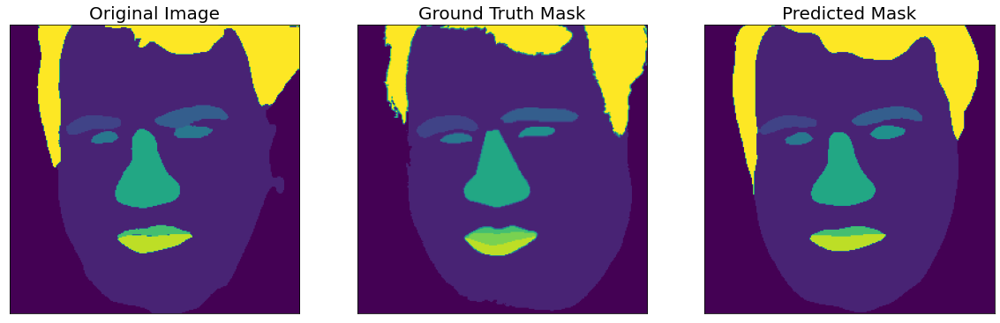

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9586, 0.9562, 0.6195, 0.6957, 0.6108, 0.5703, 0.9194, 0.6889, 0.0000,
        0.6960, 0.7804])
tensor([0.9586, 0.9562, 0.6195, 0.6957, 0.6108, 0.5703, 0.9194, 0.6889,    nan,
        0.6960, 0.7804])


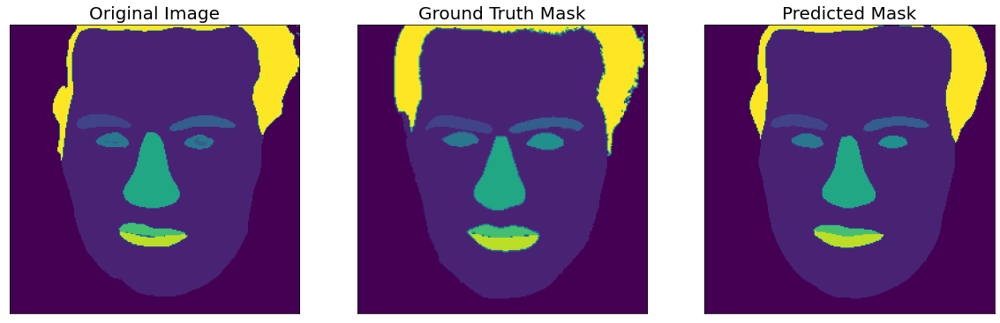

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.6723, 0.9369, 0.5506, 0.6754, 0.5247, 0.6261, 0.8675, 0.7529, 0.6695,
        0.6772, 0.9038])
tensor([0.6723, 0.9369, 0.5506, 0.6754, 0.5247, 0.6261, 0.8675, 0.7529, 0.6695,
        0.6772, 0.9038])


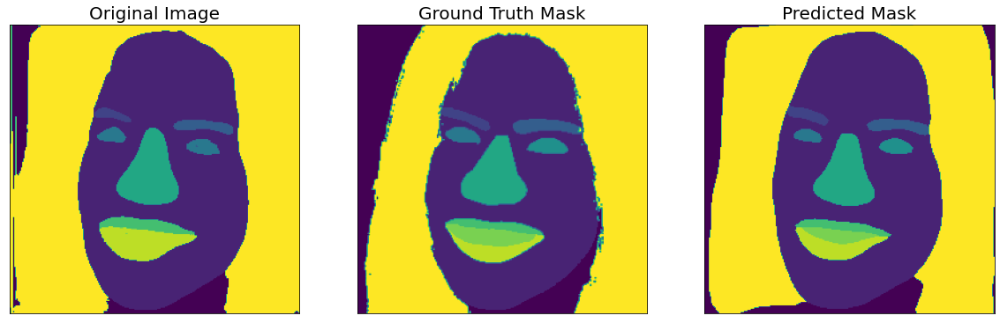

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9603, 0.9345, 0.4215, 0.6727, 0.6667, 0.6450, 0.8938, 0.6686, 0.0606,
        0.5876, 0.8727])
tensor([0.9603, 0.9345, 0.4215, 0.6727, 0.6667, 0.6450, 0.8938, 0.6686,    nan,
        0.5876, 0.8727])


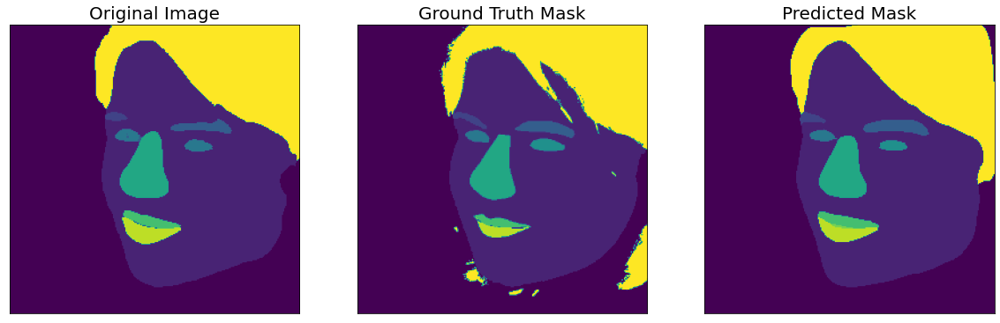

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.6096, 0.9473, 0.2076, 0.0452, 0.5379, 0.4782, 0.9028, 0.5777, 0.6278,
        0.7278, 0.8993])
tensor([0.6096, 0.9473, 0.2076,    nan, 0.5379, 0.4782, 0.9028, 0.5777, 0.6278,
        0.7278, 0.8993])


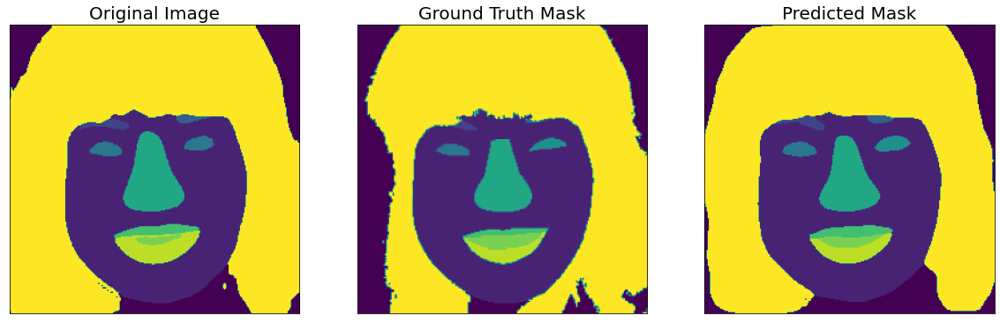

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.6184, 0.8323, 0.5899, 0.5150, 0.5481, 0.5239, 0.8842, 0.7342, 0.4359,
        0.7120, 0.8953])
tensor([0.6184, 0.8323, 0.5899, 0.5150, 0.5481, 0.5239, 0.8842, 0.7342, 0.4359,
        0.7120, 0.8953])


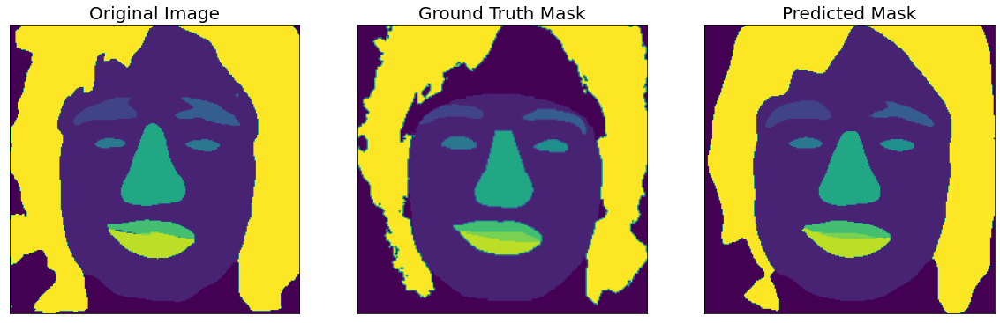

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9681, 0.9478, 0.5841, 0.6164, 0.5923, 0.4843, 0.9149, 0.6773, 0.6579,
        0.7557, 0.8430])
tensor([0.9681, 0.9478, 0.5841, 0.6164, 0.5923, 0.4843, 0.9149, 0.6773, 0.6579,
        0.7557, 0.8430])


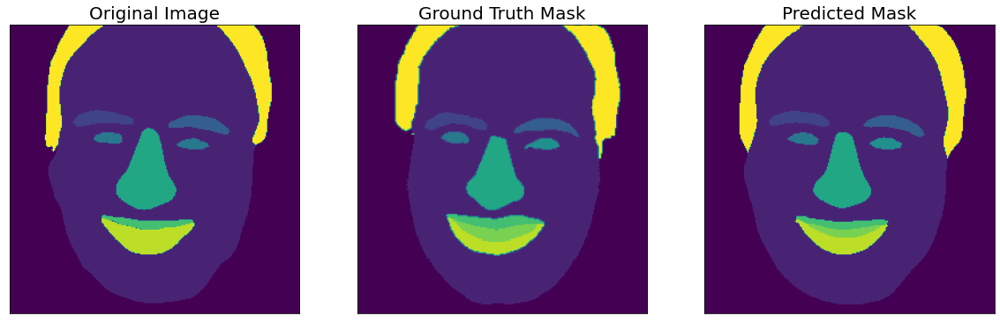

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8977, 0.9120, 0.7005, 0.6148, 0.7957, 0.6571, 0.9027, 0.7581, 0.7291,
        0.8059, 0.7974])
tensor([0.8977, 0.9120, 0.7005, 0.6148, 0.7957, 0.6571, 0.9027, 0.7581, 0.7291,
        0.8059, 0.7974])


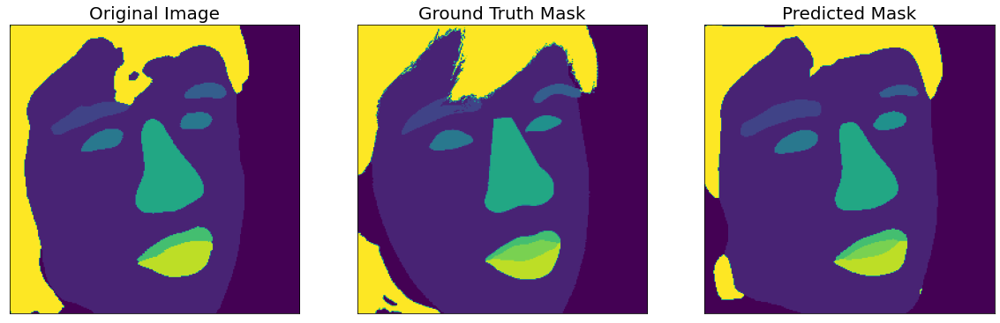

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9292, 0.9383, 0.6618, 0.7407, 0.5710, 0.6761, 0.8965, 0.6291, 0.7067,
        0.8037, 0.9074])
tensor([0.9292, 0.9383, 0.6618, 0.7407, 0.5710, 0.6761, 0.8965, 0.6291, 0.7067,
        0.8037, 0.9074])


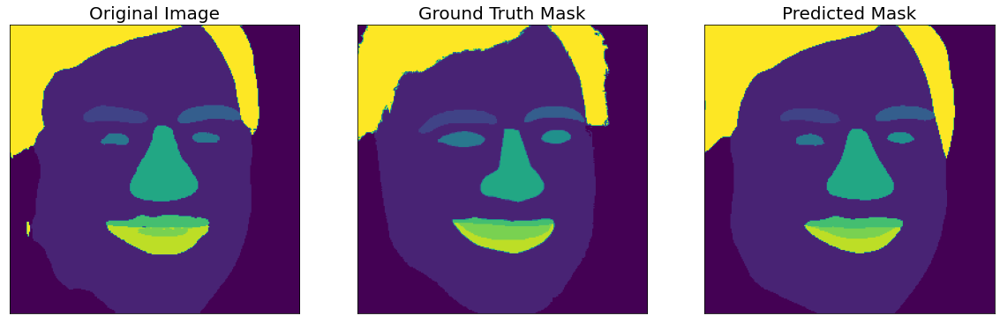

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8628, 0.9295, 0.6407, 0.6156, 0.4568, 0.3926, 0.9046, 0.6077, 0.7838,
        0.7201, 0.7943])
tensor([0.8628, 0.9295, 0.6407, 0.6156, 0.4568, 0.3926, 0.9046, 0.6077, 0.7838,
        0.7201, 0.7943])


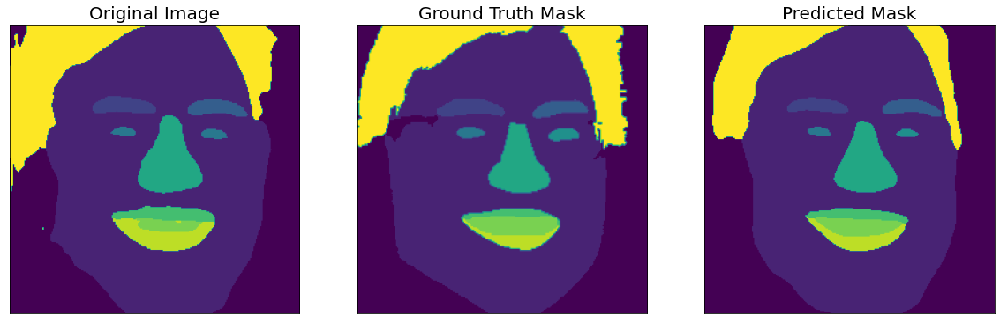

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9191, 0.9491, 0.7916, 0.7914, 0.2654, 0.0000, 0.9602, 0.7934, 0.7753,
        0.4100, 0.5025])
tensor([0.9191, 0.9491, 0.7916, 0.7914, 0.2654,    nan, 0.9602, 0.7934, 0.7753,
        0.4100, 0.5025])


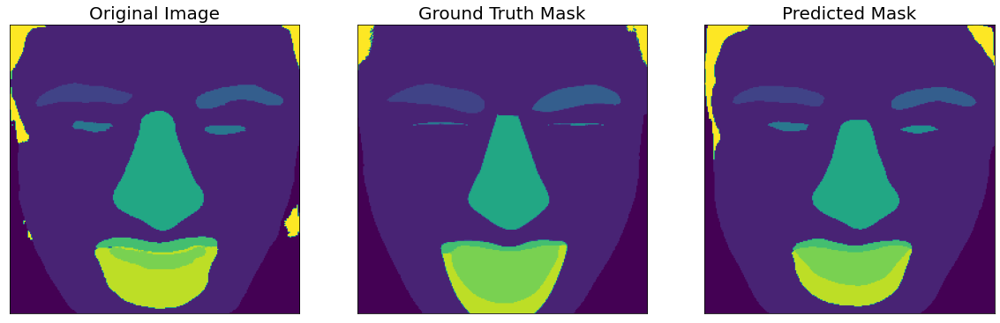

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.7811, 0.9640, 0.7103, 0.7286, 0.8397, 0.7141, 0.9332, 0.8482, 0.8027,
        0.8434, 0.6811])
tensor([0.7811, 0.9640, 0.7103, 0.7286, 0.8397, 0.7141, 0.9332, 0.8482, 0.8027,
        0.8434, 0.6811])


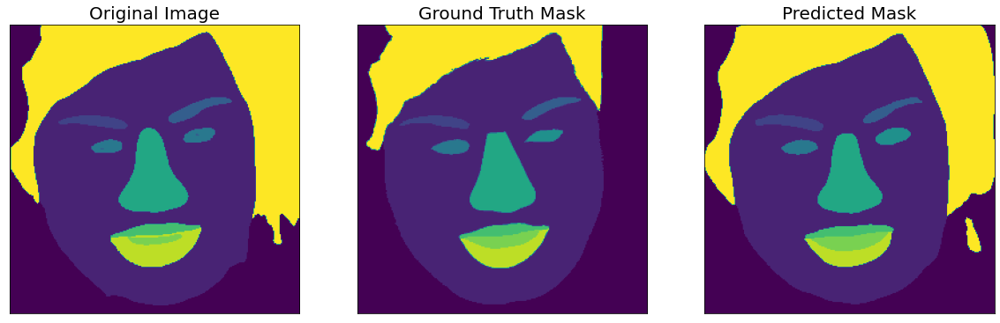

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9783, 0.9568, 0.6556, 0.5377, 0.5304, 0.5204, 0.9084, 0.6724, 0.1161,
        0.8017, 0.9025])
tensor([0.9783, 0.9568, 0.6556, 0.5377, 0.5304, 0.5204, 0.9084, 0.6724, 0.1161,
        0.8017, 0.9025])


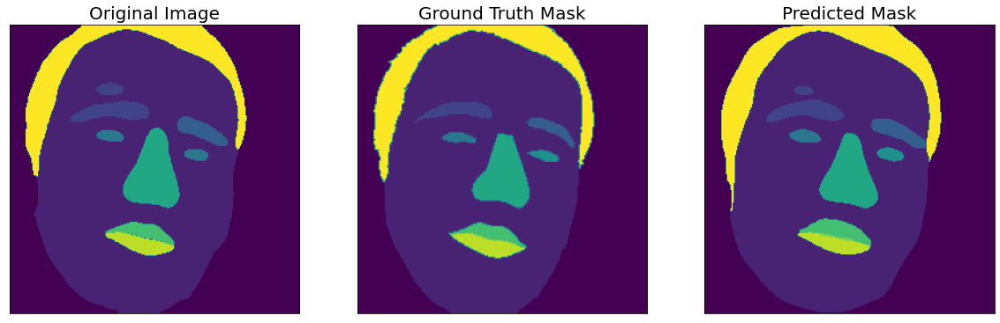

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.6232, 0.8636, 0.4493, 0.5100, 0.5622, 0.6449, 0.9370, 0.6051, 0.0000,
        0.7776, 0.2091])
tensor([0.6232, 0.8636, 0.4493, 0.5100, 0.5622, 0.6449, 0.9370, 0.6051,    nan,
        0.7776, 0.2091])


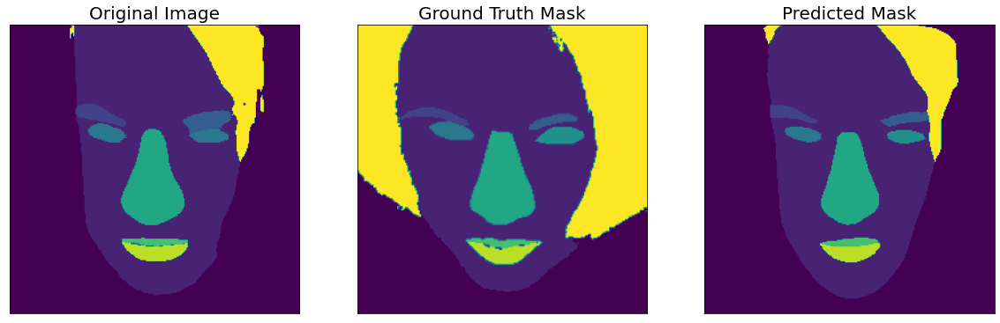

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9099, 0.9097, 0.5950, 0.6801, 0.6482, 0.6627, 0.9129, 0.7890, 0.0571,
        0.8174, 0.8841])
tensor([0.9099, 0.9097, 0.5950, 0.6801, 0.6482, 0.6627, 0.9129, 0.7890,    nan,
        0.8174, 0.8841])


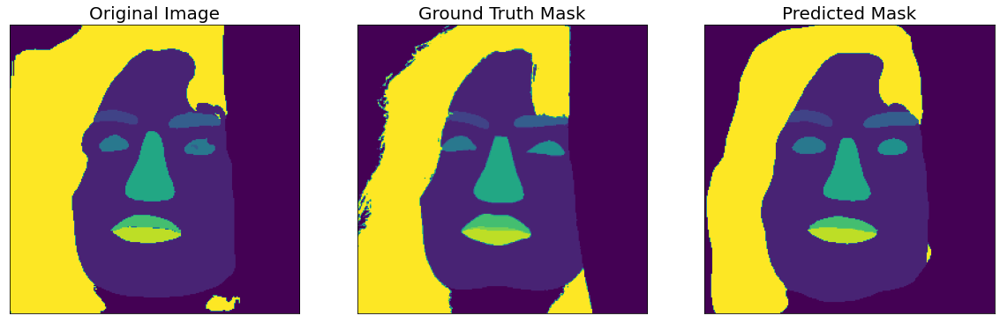

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.7644, 0.9600, 0.6787, 0.6952, 0.5152, 0.4277, 0.8981, 0.7632, 0.8627,
        0.7703, 0.9009])
tensor([0.7644, 0.9600, 0.6787, 0.6952, 0.5152, 0.4277, 0.8981, 0.7632, 0.8627,
        0.7703, 0.9009])


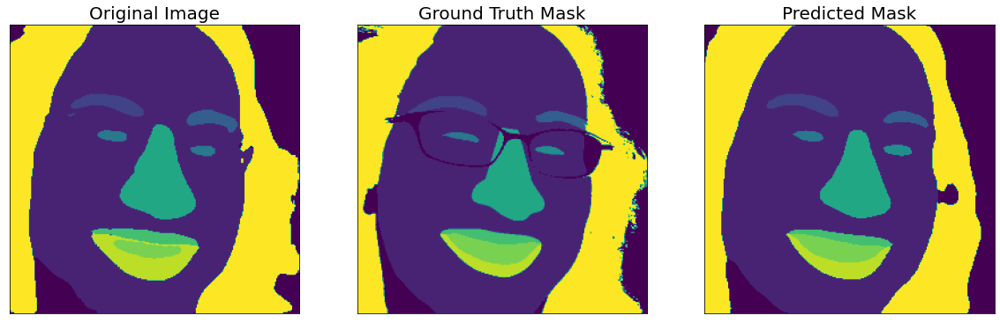

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8964, 0.9534, 0.0988, 0.5514, 0.7264, 0.6047, 0.8558, 0.8546, 0.7293,
        0.8601, 0.8545])
tensor([0.8964, 0.9534,    nan, 0.5514, 0.7264, 0.6047, 0.8558, 0.8546, 0.7293,
        0.8601, 0.8545])


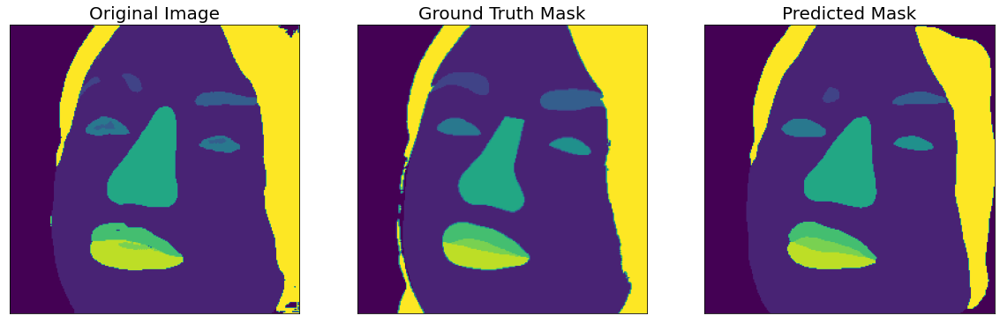

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8871, 0.9544, 0.7003, 0.6897, 0.7056, 0.7138, 0.9363, 0.8157, 0.8387,
        0.8400, 0.0000])
tensor([0.8871, 0.9544, 0.7003, 0.6897, 0.7056, 0.7138, 0.9363, 0.8157, 0.8387,
        0.8400,    nan])


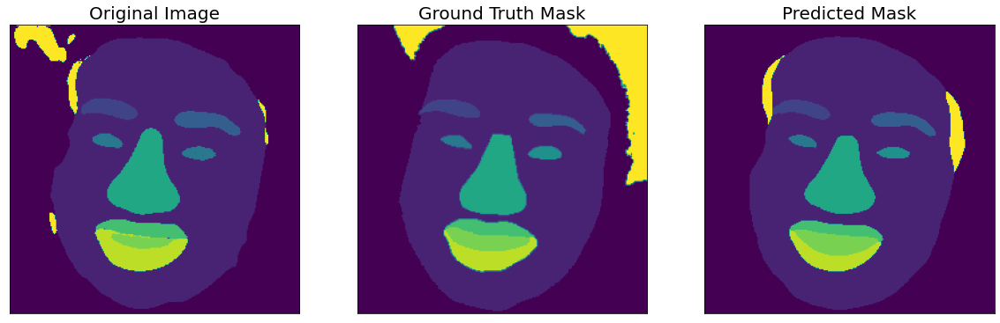

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9434, 0.9602, 0.7582, 0.7921, 0.8049, 0.6447, 0.9512, 0.8212, 0.7558,
        0.7380, 0.7110])
tensor([0.9434, 0.9602, 0.7582, 0.7921, 0.8049, 0.6447, 0.9512, 0.8212, 0.7558,
        0.7380, 0.7110])


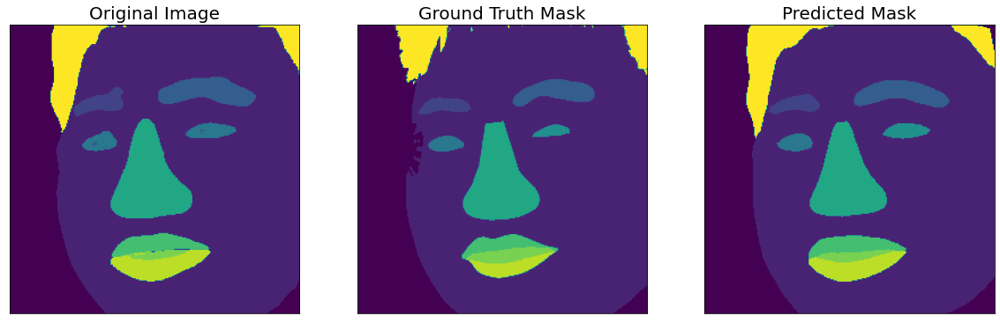

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9734, 0.9633, 0.7988, 0.8349, 0.0000, 0.0000, 0.9418, 0.6961, 0.8042,
        0.7752, 0.8054])
tensor([0.9734, 0.9633, 0.7988, 0.8349,    nan,    nan, 0.9418, 0.6961, 0.8042,
        0.7752, 0.8054])


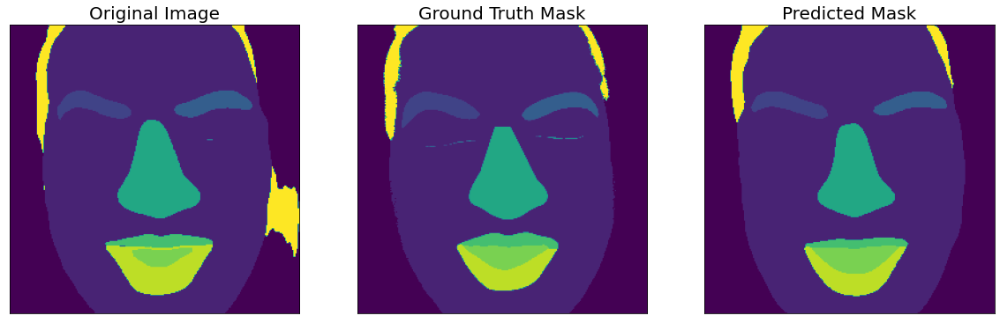

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9816, 0.9357, 0.6587, 0.4891, 0.6650, 0.7009, 0.9409, 0.6517, 0.8590,
        0.8279, 0.8676])
tensor([0.9816, 0.9357, 0.6587, 0.4891, 0.6650, 0.7009, 0.9409, 0.6517, 0.8590,
        0.8279, 0.8676])


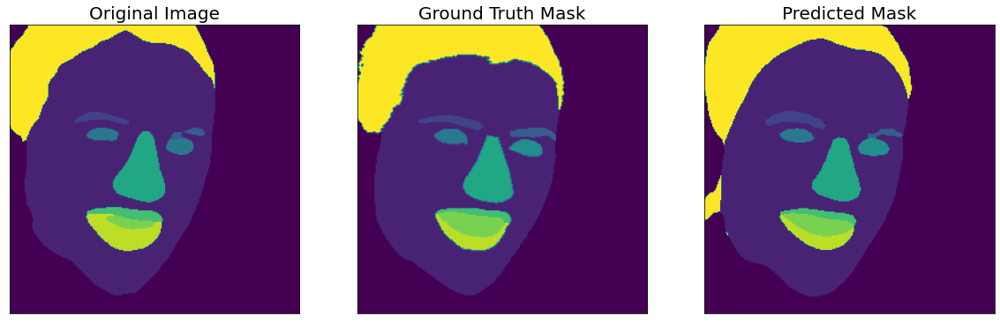

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9811, 0.9462, 0.5221, 0.6953, 0.5000, 0.5434, 0.8943, 0.5798, 0.2102,
        0.7070, 0.9308])
tensor([0.9811, 0.9462, 0.5221, 0.6953, 0.5000, 0.5434, 0.8943, 0.5798, 0.2102,
        0.7070, 0.9308])


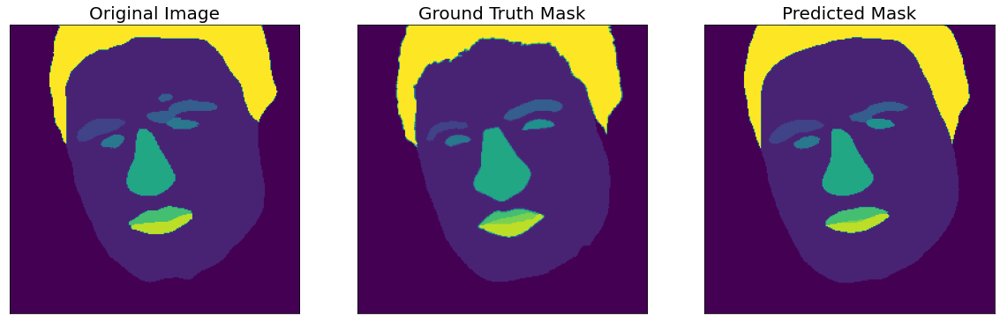

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.9796, 0.8658, 0.6329, 0.5504, 0.7346, 0.6893, 0.8153, 0.1818, 0.0000,
        0.4564, 0.1804])
tensor([0.9796, 0.8658, 0.6329, 0.5504, 0.7346, 0.6893, 0.8153, 0.1818,    nan,
        0.4564, 0.1804])


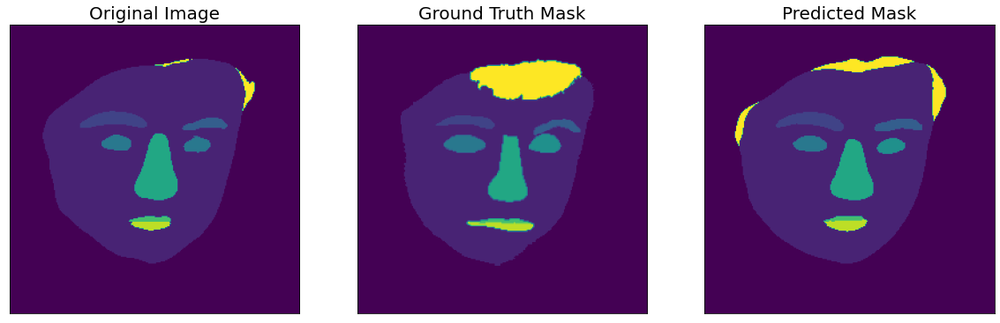

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8598, 0.9684, 0.6375, 0.8647, 0.8258, 0.8882, 0.9184, 0.7821, 0.6277,
        0.8995, 0.6241])
tensor([0.8598, 0.9684, 0.6375, 0.8647, 0.8258, 0.8882, 0.9184, 0.7821, 0.6277,
        0.8995, 0.6241])


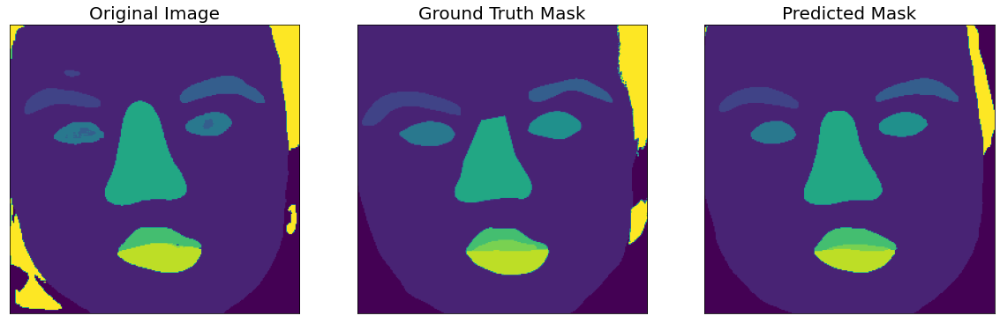

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8643, 0.9455, 0.7474, 0.7212, 0.6667, 0.6103, 0.9145, 0.7602, 0.0000,
        0.8028, 0.2469])
tensor([0.8643, 0.9455, 0.7474, 0.7212, 0.6667, 0.6103, 0.9145, 0.7602,    nan,
        0.8028, 0.2469])


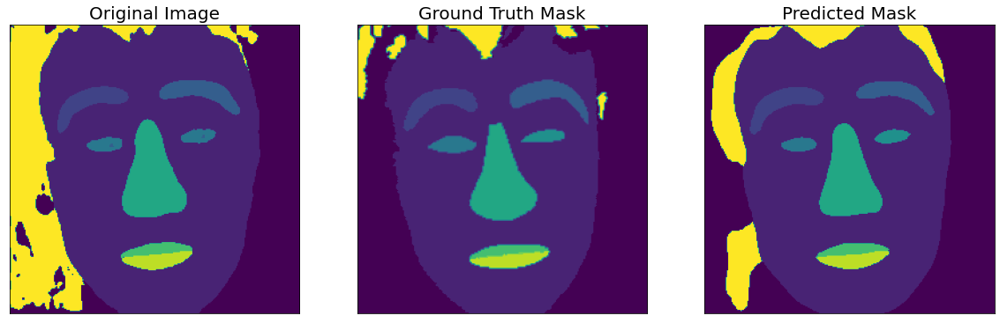

torch.Size([256, 256, 1])
predraw torch.Size([1, 11, 256, 256])
gtraw torch.Size([11, 256, 256])
(11, 256, 256)
(256, 256)
torch.Size([11, 256, 256])
tensor([0.8880, 0.9519, 0.1736, 0.2201, 0.6158, 0.6976, 0.9316, 0.6095, 0.0000,
        0.7901, 0.9101])
tensor([0.8880, 0.9519, 0.1736, 0.2201, 0.6158, 0.6976, 0.9316, 0.6095,    nan,
        0.7901, 0.9101])


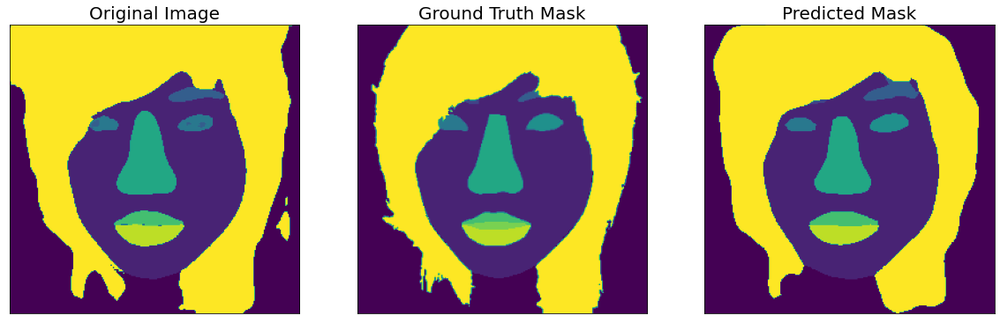

Dataset MIoU =  0.5605907393826379
Dataset F1 =  [0.8573452  0.9386916  0.6231905  0.62246317 0.6170389  0.62005275
 0.90541744 0.6132918  0.61123693 0.7033419  0.76218617]
Dataset F1 av =  0.7158415


In [ ]:
model = torch.load("/content/drive/MyDrive/helen_unet_no_aug_crop_val_10_label_adapted.pth", map_location=DEVICE)

view_predictions(model,train_ds, num_classes)